In [ ]:
!pip install scipy numpy matplotlib pandas sklearn

In [2]:

import pandas as pd
import numpy as np

In [3]:
# If the data is in .csv


mydata = pd.read_csv('/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/regression_so_samples_61_subjects.csv')

In [4]:
mydata

,Label,Sbj_ID,Age,ifCleanOnset,SleepStage,delta_power,theta_power,alpha_power,beta_power,gamma_power,...,FC_LocalSimple_mean3_stderr,Entropy_Rate_CTW,Entropy_Rate_LZ,Aperiodic_component,"Monophasic_vertices_count,","Biphasic_vertices_count,","Sleep_spindles_count,","K_complex_count,",O-information,S-information
0,30.0,2,83,0,0,-2.445233,-3.155950,-2.710832,-2.962410,-4.462281,...,0.336799,0.316177,0.316998,0.660012,0.0,0.0,2.000000,0.0,0.010023,36.736777
1,29.9,2,83,0,0,-3.324564,-3.857711,-3.775982,-4.076556,-5.188734,...,0.539413,0.515705,0.532923,0.645414,0.0,0.0,0.333333,0.0,-0.000281,0.010573
2,29.8,2,83,0,0,-2.219338,-2.767709,-2.312887,-3.297628,-4.449349,...,0.287693,0.305671,0.334226,0.720780,0.0,0.0,0.500000,0.0,0.004206,36.730961
3,29.7,2,83,0,0,-2.727042,-3.262588,-2.936053,-3.311534,-4.602471,...,0.328391,0.316754,0.310106,0.680707,0.0,0.0,1.000000,0.0,0.002373,36.729127
4,29.6,2,83,0,0,-2.480271,-2.864198,-2.560953,-3.247082,-4.445265,...,0.270287,0.285799,0.272204,0.673053,0.0,0.0,1.000000,0.0,0.075438,36.802192
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12245,0.5,967,79,1,1,-4.205182,-5.927848,-6.588452,-7.323719,-9.471894,...,0.364770,0.421828,0.385910,1.735071,0.0,0.0,0.000000,0.0,0.003827,0.131473
12246,0.4,967,79,1,1,-4.640321,-5.821094,-5.830598,-6.659668,-8.758167,...,0.553548,0.577926,0.530626,1.511610,0.0,0.0,0.666667,0.0,-0.003928,0.150282
12247,0.3,967,79,1,1,-4.582445,-5.743854,-5.579267,-6.492031,-8.613777,...,0.535603,0.590007,0.523735,1.477903,0.0,0.0,0.500000,0.0,18.017979,55.437880
12248,0.2,967,79,1,1,-4.826561,-6.478162,-6.507481,-7.487025,-9.766839,...,0.451375,0.530330,0.496170,1.693094,0.0,0.0,0.500000,0.0,0.057015,36.090622


In [5]:
# Search for missing values
mydata.isnull().sum()



Label                          0
Sbj_ID                         0
Age                            0
ifCleanOnset                   0
SleepStage                     0
                            ... 
Biphasic_vertices_count,    1317
Sleep_spindles_count,       1317
K_complex_count,            1317
O-information                 17
S-information                  0
Length: 72, dtype: int64

In [6]:
# Delete the rows with the missing values

mydata = mydata.dropna()

mydata.isnull().sum()

Label                       0
Sbj_ID                      0
Age                         0
ifCleanOnset                0
SleepStage                  0
                           ..
Biphasic_vertices_count,    0
Sleep_spindles_count,       0
K_complex_count,            0
O-information               0
S-information               0
Length: 72, dtype: int64

In [7]:
# Find infinity values

mydata[mydata == np.inf].sum()


Label                       0.0
Sbj_ID                      0.0
Age                         0.0
ifCleanOnset                0.0
SleepStage                  0.0
                           ... 
Biphasic_vertices_count,    0.0
Sleep_spindles_count,       0.0
K_complex_count,            0.0
O-information               0.0
S-information               0.0
Length: 72, dtype: float64

In [8]:
# Find correlation between variables

mydata.corr()


,Label,Sbj_ID,Age,ifCleanOnset,SleepStage,delta_power,theta_power,alpha_power,beta_power,gamma_power,...,FC_LocalSimple_mean3_stderr,Entropy_Rate_CTW,Entropy_Rate_LZ,Aperiodic_component,"Monophasic_vertices_count,","Biphasic_vertices_count,","Sleep_spindles_count,","K_complex_count,",O-information,S-information
Label,1.000000,-0.065880,0.021007,0.001906,-0.302049,0.238273,0.131258,0.071185,0.245217,0.344232,...,0.121073,0.163535,0.155161,-0.325668,NaN,NaN,-0.007737,NaN,0.152258,0.171998
Sbj_ID,-0.065880,1.000000,-0.004711,0.219564,0.036401,-0.053954,0.035417,0.079294,0.053201,0.116885,...,-0.044102,-0.069801,-0.079384,-0.145704,NaN,NaN,-0.164304,NaN,-0.053608,-0.051446
Age,0.021007,-0.004711,1.000000,-0.050375,-0.006818,-0.037081,-0.020822,0.116648,-0.056074,-0.088385,...,-0.038349,-0.020330,-0.002033,-0.014060,NaN,NaN,0.181684,NaN,0.019193,-0.002762
ifCleanOnset,0.001906,0.219564,-0.050375,1.000000,-0.085737,-0.026420,0.061760,-0.012038,0.040050,0.098994,...,0.097880,0.080398,0.099033,-0.152047,NaN,NaN,-0.194892,NaN,0.014352,0.024500
SleepStage,-0.302049,0.036401,-0.006818,-0.085737,1.000000,0.073665,0.025832,-0.048851,-0.140272,-0.134207,...,-0.174039,-0.182976,-0.177667,0.198457,NaN,NaN,-0.045171,NaN,-0.050625,-0.043124
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"Biphasic_vertices_count,",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
"Sleep_spindles_count,",-0.007737,-0.164304,0.181684,-0.194892,-0.045171,-0.219023,-0.263628,-0.001557,0.105484,-0.082423,...,0.217678,0.175450,0.191743,-0.016205,NaN,NaN,1.000000,NaN,0.090611,0.086683
"K_complex_count,",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
O-information,0.152258,-0.053608,0.019193,0.014352,-0.050625,0.083692,0.018205,-0.023867,0.091032,0.191024,...,0.109658,0.136151,0.149067,-0.228465,NaN,NaN,0.090611,NaN,1.000000,0.848006


In [9]:
# Find the most correlated variables

mydata.corr().unstack().sort_values().drop_duplicates()

gamma_power                       SP_Summaries_welch_rect_area_5_1   -0.914595
                                  Aperiodic_component                -0.887168
                                  Beta_to_gamma_ratio                -0.832753
SB_BinaryStats_diff_longstretch0  gamma_power                        -0.816726
Alpha_to_gamma_ratio              gamma_power                        -0.804210
                                                                        ...   
Phase_amplitude_coupling_TG       Phase_amplitude_coupling_DT         0.964556
Entropy_Rate_CTW                  Entropy_Rate_LZ                     0.980160
Phase_amplitude_coupling_TG       Phase_amplitude_coupling_DB         0.981889
Label                             Label                               1.000000
                                  Monophasic_vertices_count,               NaN
Length: 2348, dtype: float64

In [10]:
# Find the most correlated variables with the target variable (Label) but exclude the results that have NaN values and the results that are equal to 1

mydata.corr()['Label'].sort_values().dropna().drop_duplicates()

#mydata.corr()['Label'].sort_values()





CO_Embed2_Dist_tau_d_expfit_meandiff   -0.332035
Aperiodic_component                    -0.325668
SP_Summaries_welch_rect_area_5_1       -0.320943
CO_HistogramAMI_even_2_5               -0.311704
SB_BinaryStats_diff_longstretch0       -0.309385
                                          ...   
S-information                           0.171998
delta_power                             0.238273
beta_power                              0.245217
gamma_power                             0.344232
Label                                   1.000000
Name: Label, Length: 69, dtype: float64

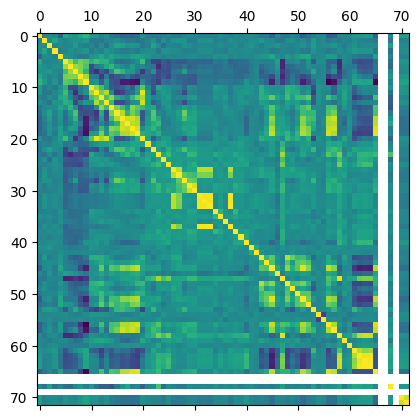

In [11]:
# Plot the correlation of variable with the target variable (Label)

import matplotlib.pyplot as plt

plt.matshow(mydata.corr())
plt.show()





In [33]:
!pip install seaborn

  Using cached seaborn-0.12.2-py3-none-any.whl (293 kB)


In [12]:
# Plot the correlation of top 20 correlated and anticorrelated variables with the target variable (Label)

import seaborn as sns

corr = mydata.corr()
corr_target = abs(corr["Label"])
relevant_features = corr_target[corr_target>0.15]
relevant_features.sort_values(ascending=False)

top_20 = relevant_features.sort_values(ascending=False).head(20)

top_20



Label                                      1.000000
gamma_power                                0.344232
CO_Embed2_Dist_tau_d_expfit_meandiff       0.332035
Aperiodic_component                        0.325668
SP_Summaries_welch_rect_area_5_1           0.320943
CO_HistogramAMI_even_2_5                   0.311704
SB_BinaryStats_diff_longstretch0           0.309385
SleepStage                                 0.302049
Alpha_to_gamma_ratio                       0.294855
Theta_to_gamma_ratio                       0.292871
Alpha_to_beta_ratio                        0.270687
Beta_to_gamma_ratio                        0.248050
beta_power                                 0.245217
delta_power                                0.238273
IN_AutoMutualInfoStats_40_gaussian_fmmi    0.211646
Theta_to_beta_ratio                        0.196924
S-information                              0.171998
Entropy_Rate_CTW                           0.163535
Peak_theta_band_frequency                  0.156057
Entropy_Rate

Sbj ID:  2


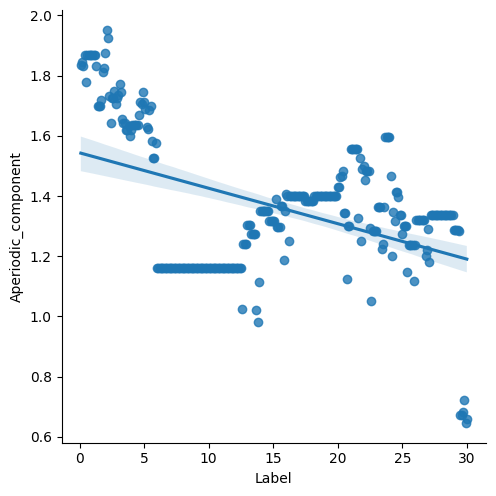

Sbj ID:  35


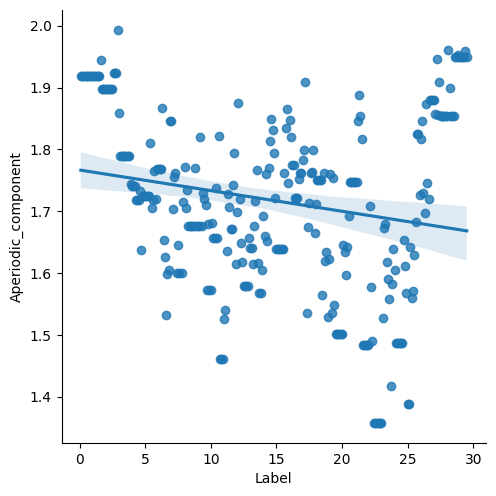

Sbj ID:  56


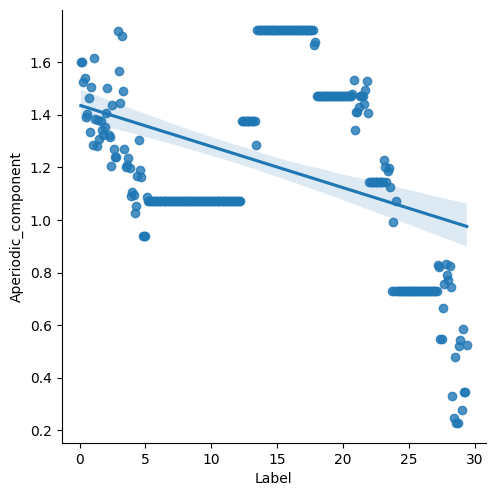

Sbj ID:  77


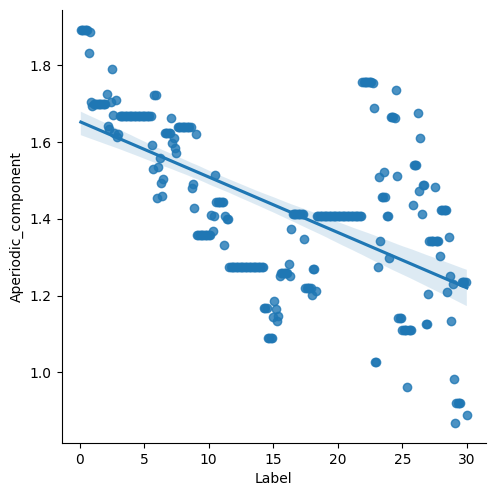

Sbj ID:  159


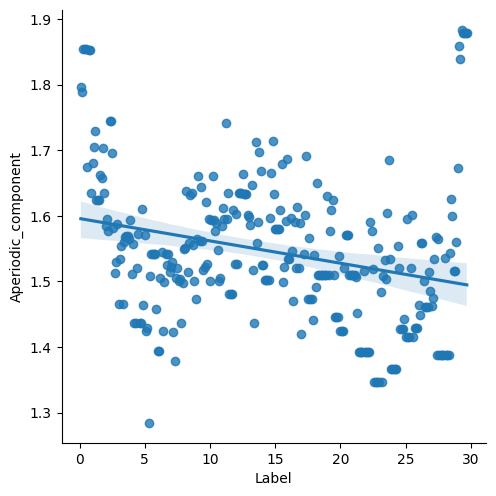

Sbj ID:  284


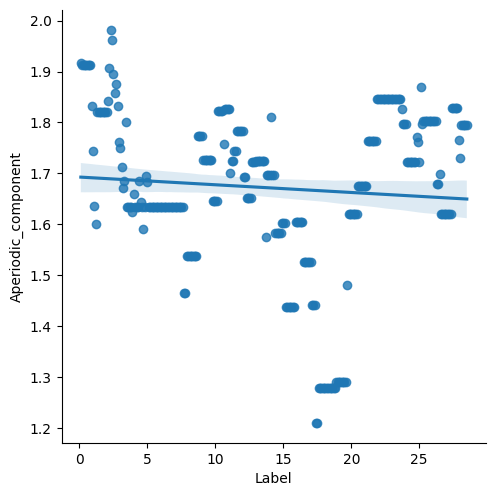

Sbj ID:  288


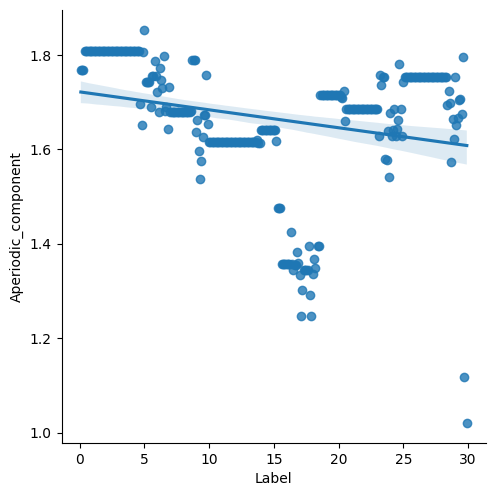

Sbj ID:  344


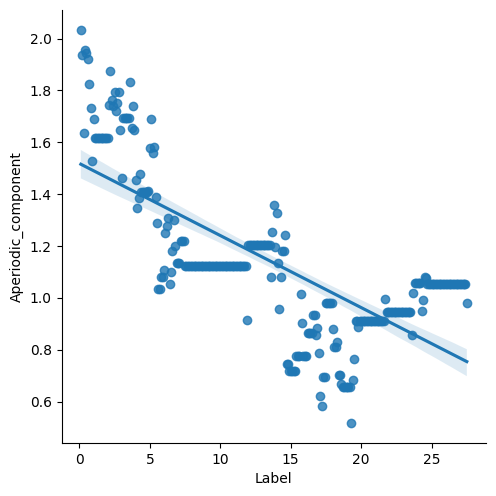

Sbj ID:  382


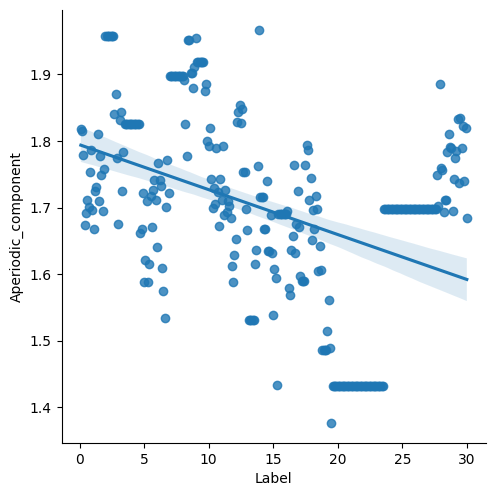

Sbj ID:  384


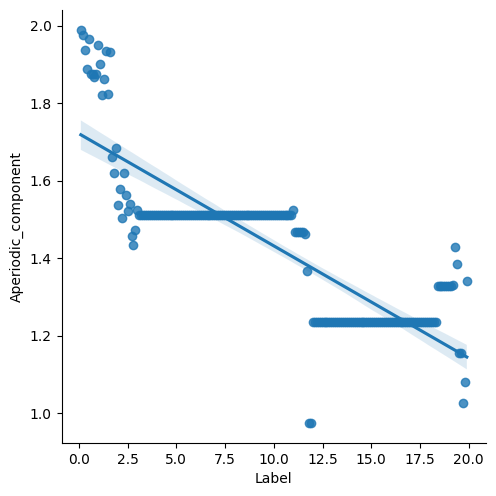

Sbj ID:  416


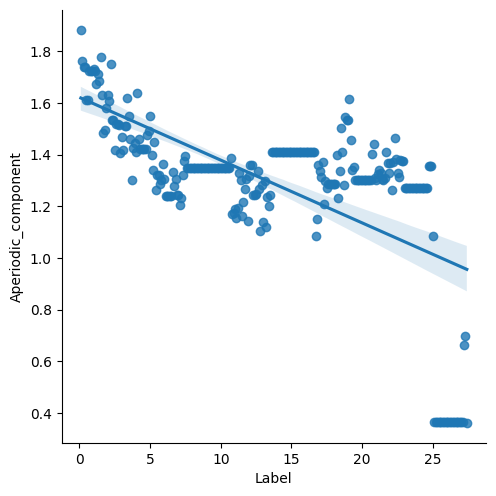

Sbj ID:  419


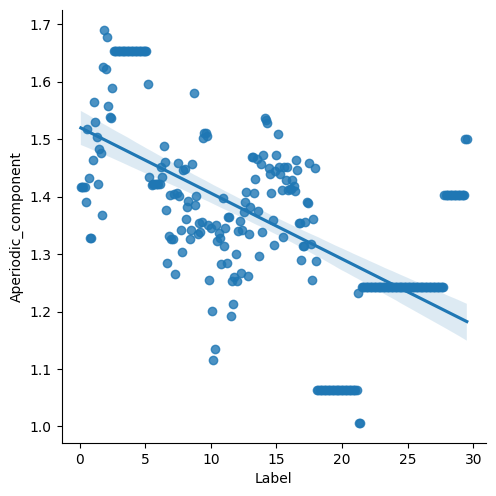

Sbj ID:  458


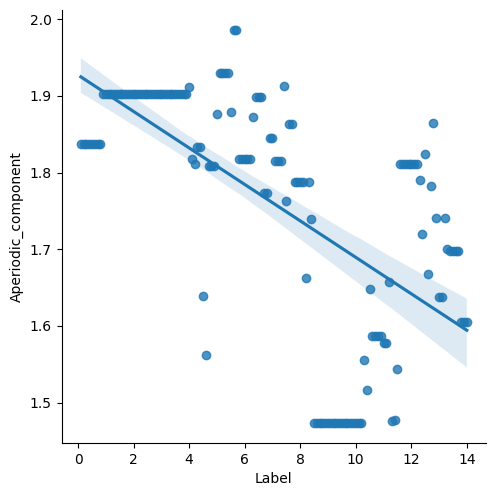

Sbj ID:  460


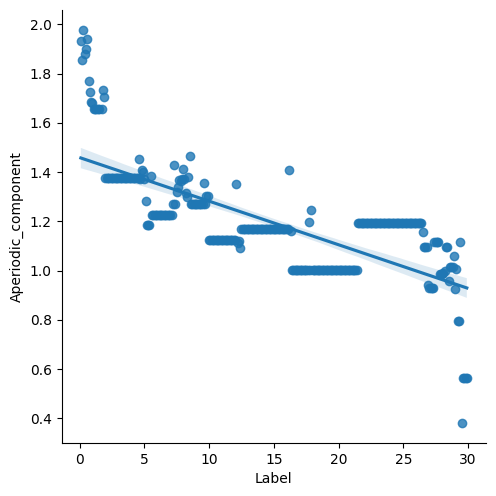

Sbj ID:  490


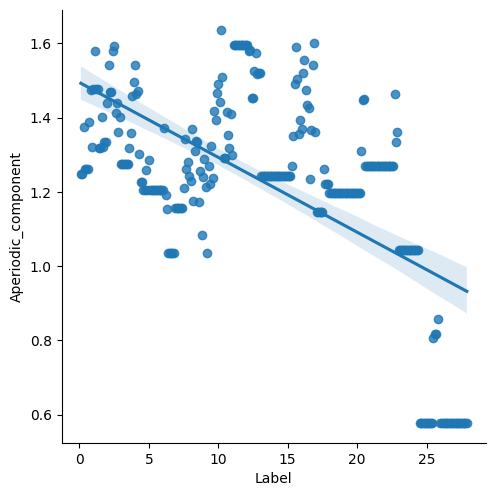

Sbj ID:  491


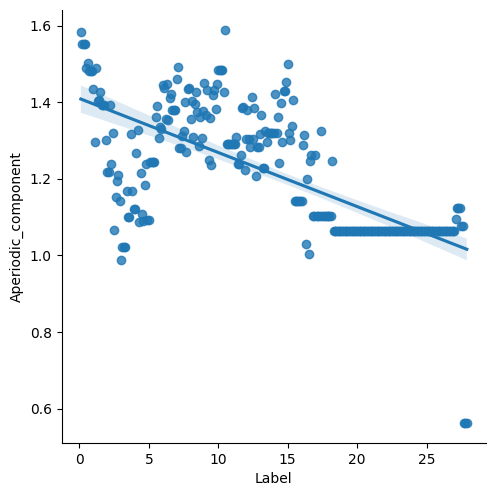

Sbj ID:  518


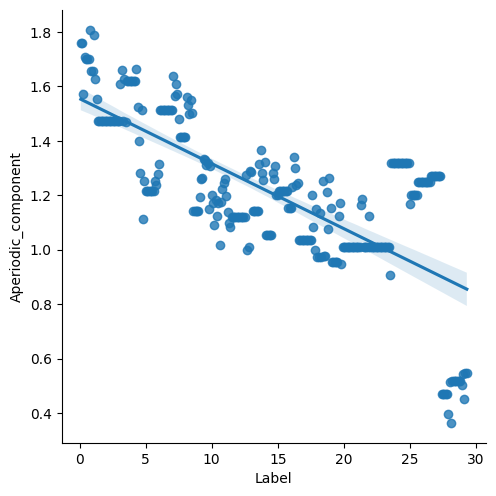

Sbj ID:  519


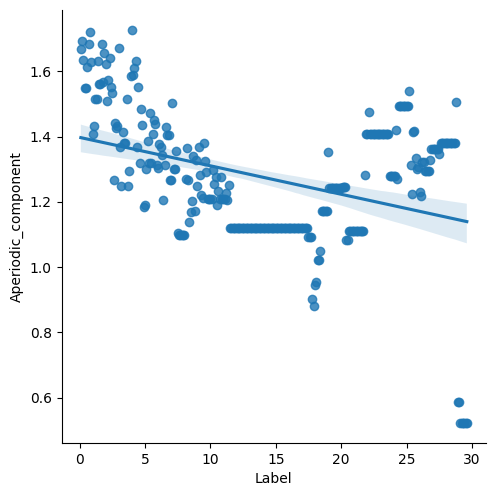

Sbj ID:  581


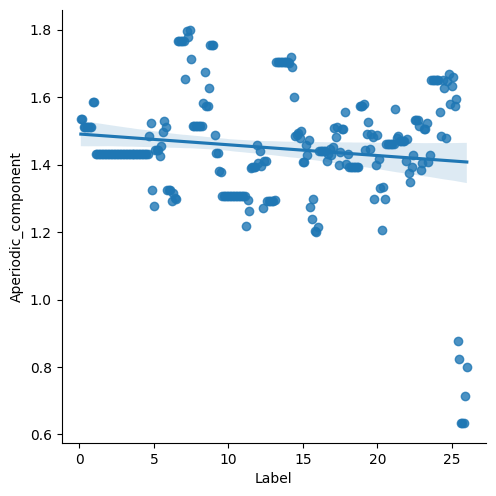

Sbj ID:  586


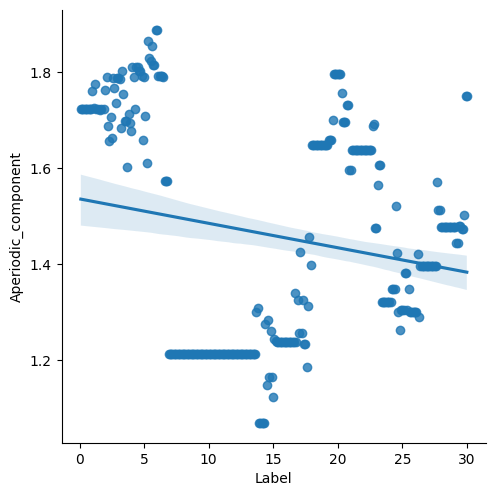

Sbj ID:  596


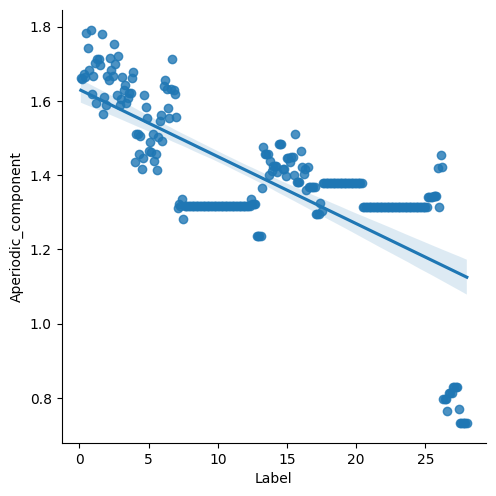

Sbj ID:  632


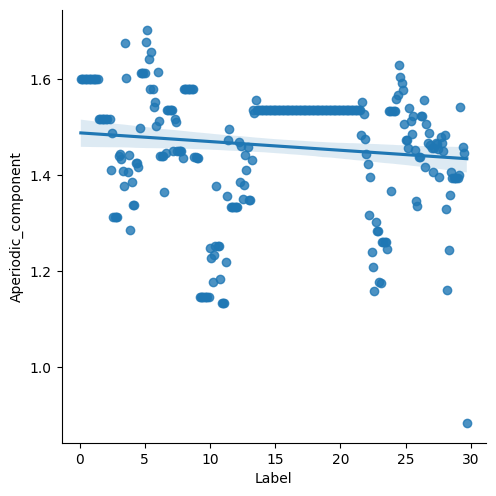

Sbj ID:  664


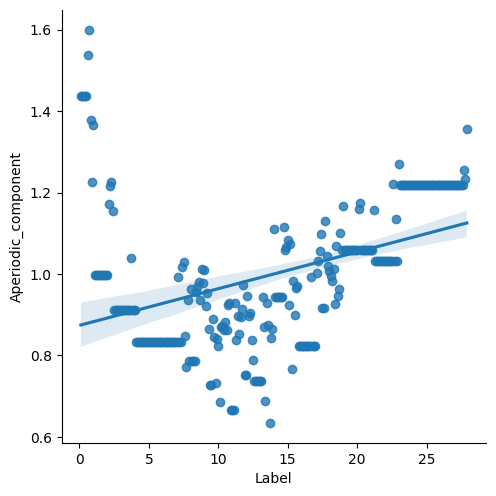

Sbj ID:  726


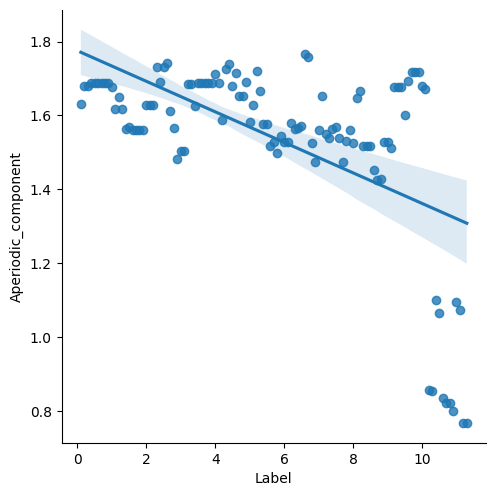

Sbj ID:  755


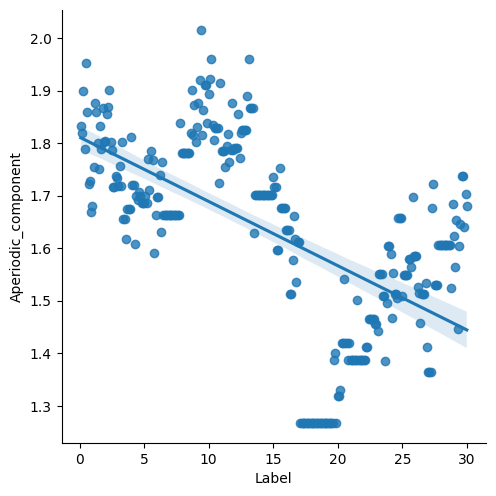

Sbj ID:  762


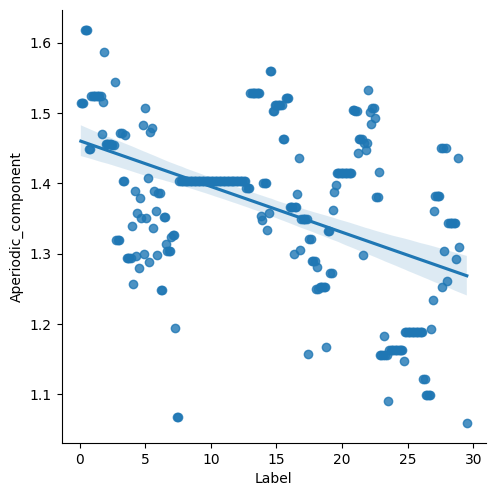

Sbj ID:  782


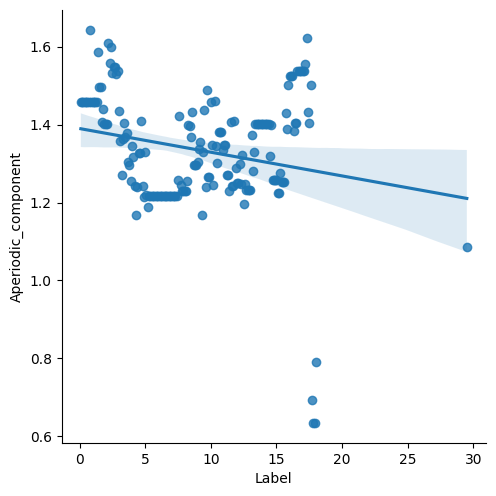

Sbj ID:  800


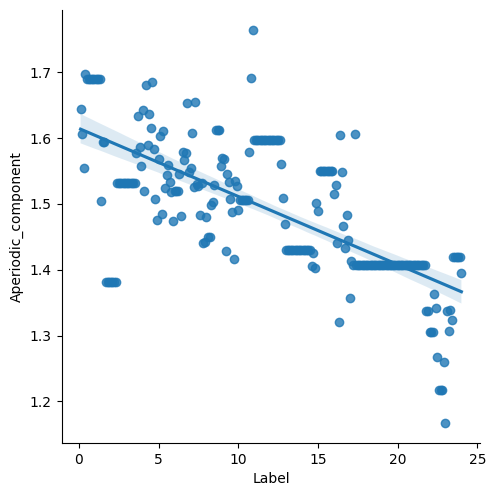

Sbj ID:  812


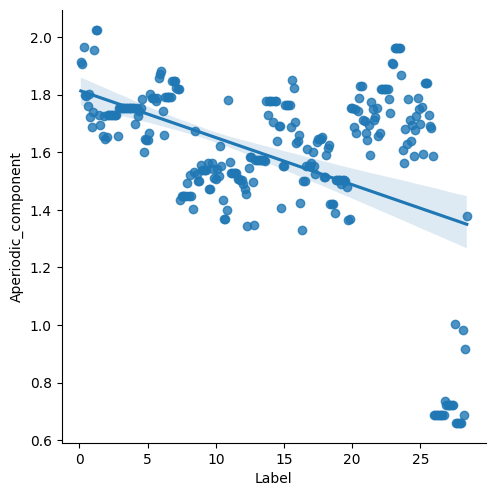

Sbj ID:  821


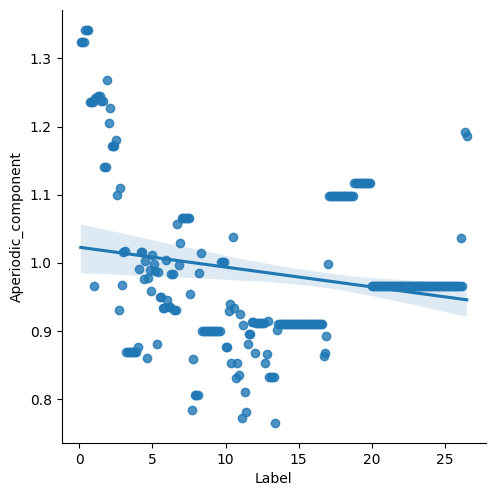

Sbj ID:  823


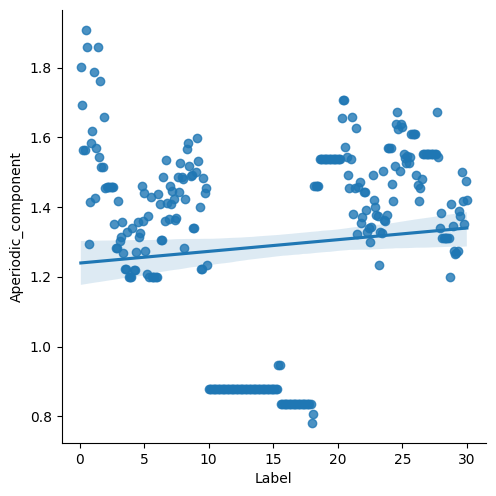

Sbj ID:  838


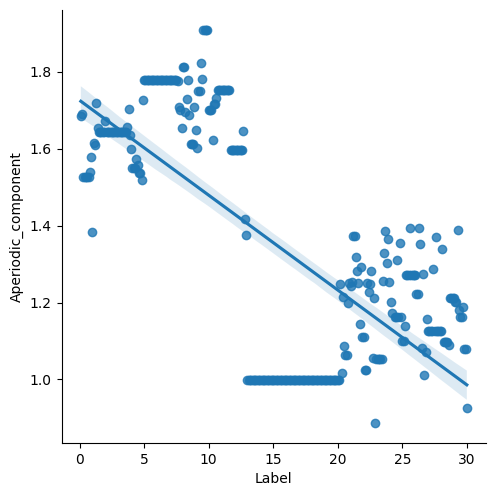

Sbj ID:  854


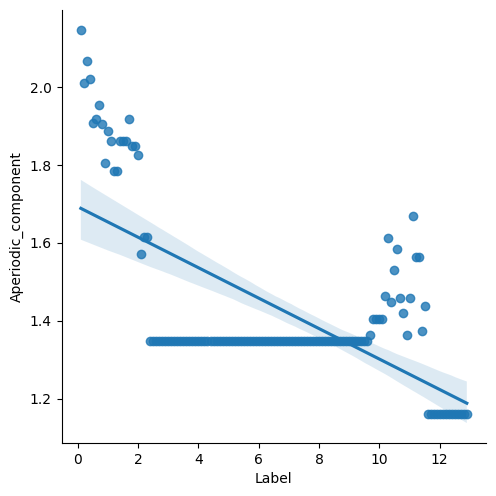

Sbj ID:  884


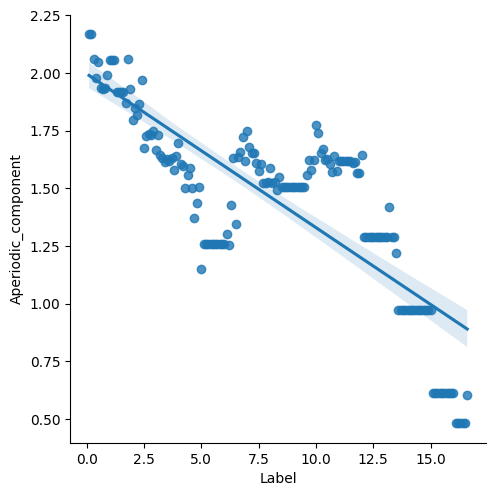

Sbj ID:  893


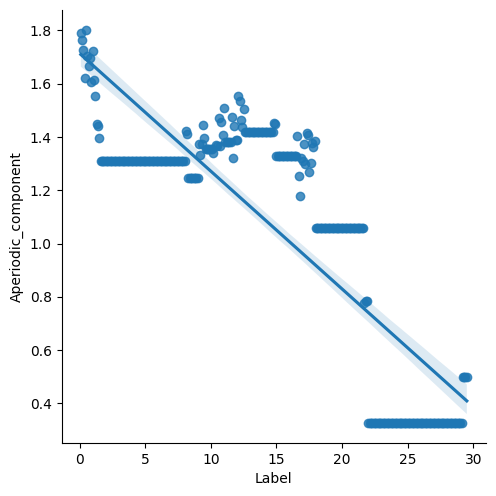

Sbj ID:  912


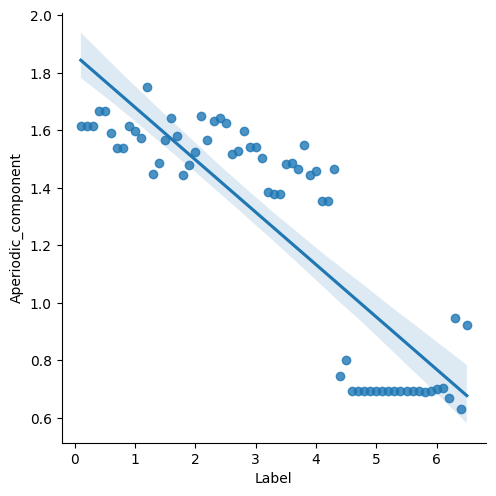

Sbj ID:  914


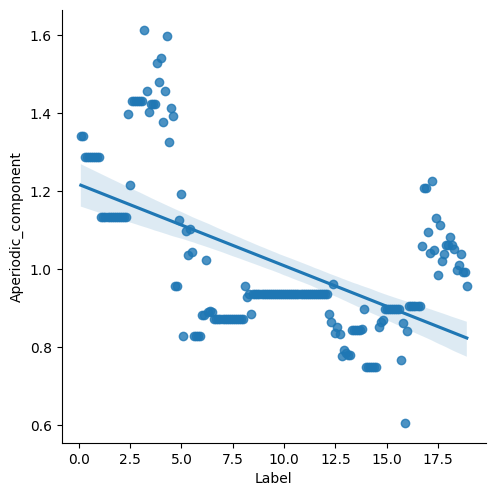

Sbj ID:  933


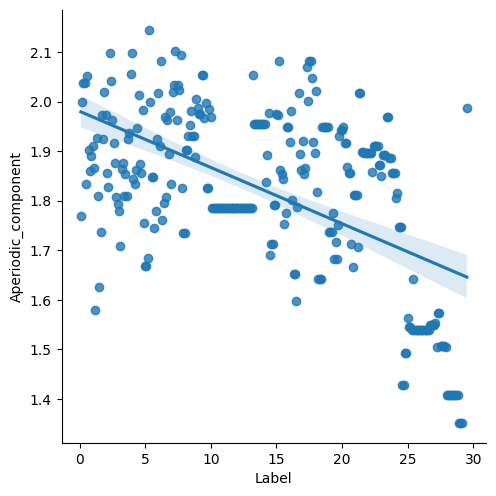

Sbj ID:  943


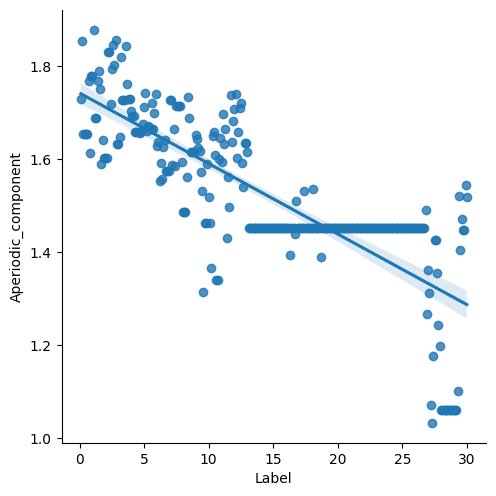

Sbj ID:  949


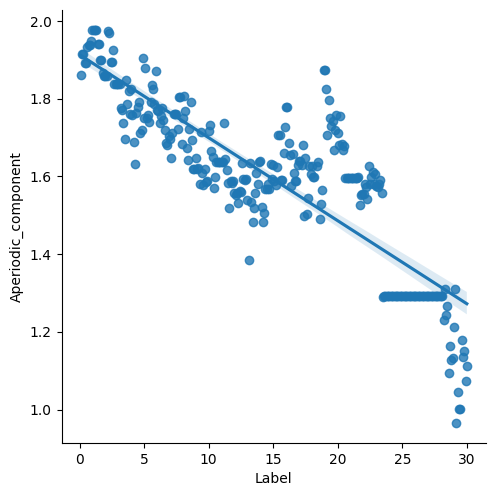

Sbj ID:  962


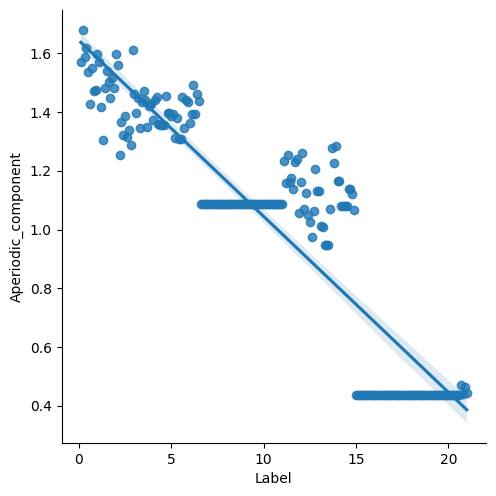

Sbj ID:  967


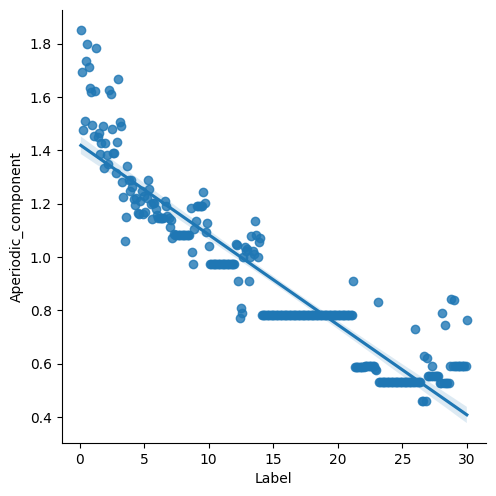

In [62]:
# For unique subject (Sbj_ID) show how each feature is changing with decreasing time to sleep onset (Label) for feature Aperiodic_component

import seaborn as sns
import matplotlib.pyplot as plt

for i in mydata['Sbj_ID'].unique():
    print('Sbj ID: ', i)
    sns.pairplot(mydata[mydata['Sbj_ID'] == i], x_vars=['Label'], y_vars=['Aperiodic_component'], height=5, aspect=1, kind='reg')
    plt.show()

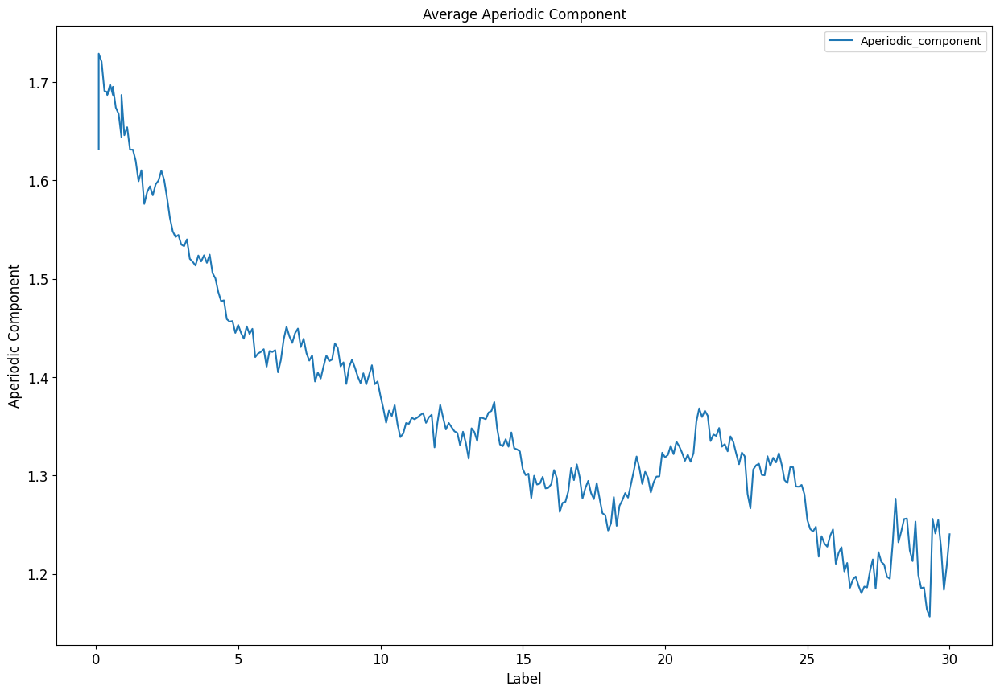

In [68]:
# Plot the how aperiodic component changes with decreasing time to sleep onset (Label), calculate the average for each timepoint (Label) and plot the average

average = mydata.groupby('Label')['Aperiodic_component'].mean()

plot = average.plot(title='Average Aperiodic Component', figsize=(15, 10), legend=True, fontsize=12)
plot.set_xlabel('Label', fontsize=12)
plot.set_ylabel('Aperiodic Component', fontsize=12)

plt.show()


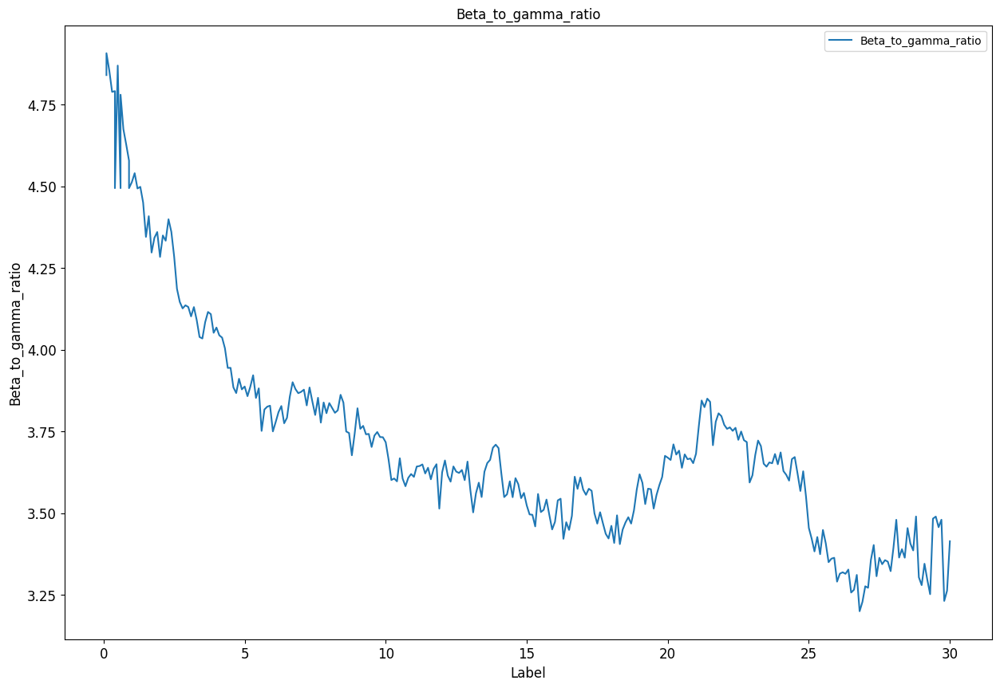

In [72]:
# Repeat the average plot for gamma power

average = mydata.groupby('Label')['Beta_to_gamma_ratio'].mean()

plot = average.plot(title='Beta_to_gamma_ratio', figsize=(15, 10), legend=True, fontsize=12)

plot.set_xlabel('Label', fontsize=12)

plot.set_ylabel('Beta_to_gamma_ratio', fontsize=12)

plt.show()



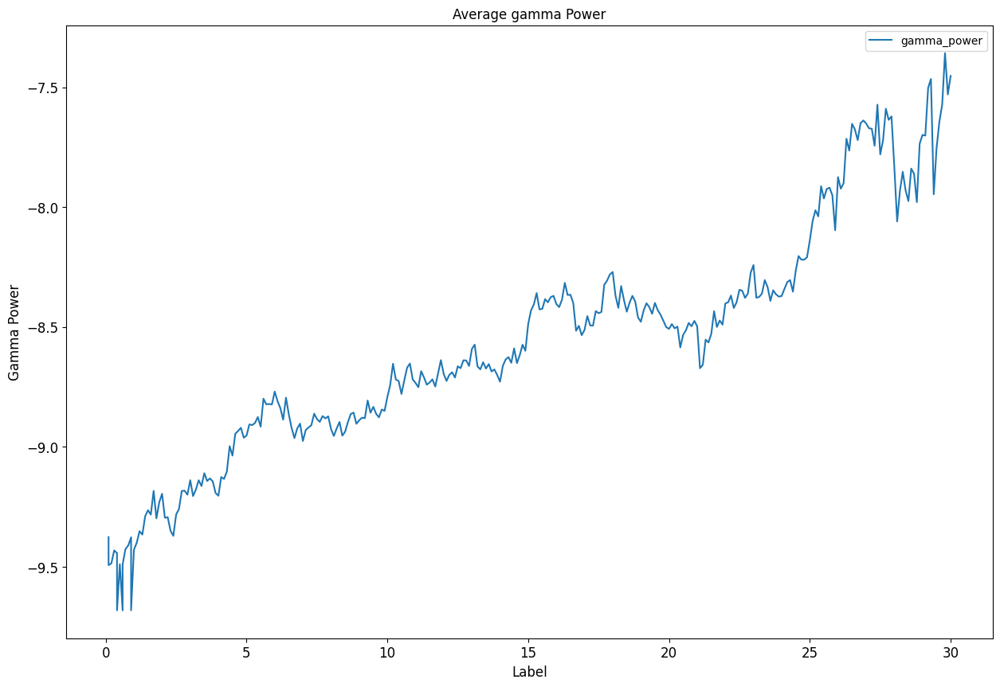

In [74]:
# Repeat the average plot for gamma power

average = mydata.groupby('Label')['gamma_power'].mean()

plot = average.plot(title='Average gamma Power', figsize=(15, 10), legend=True, fontsize=12)

plot.set_xlabel('Label', fontsize=12)

plot.set_ylabel('Gamma Power', fontsize=12)

plt.show()

Sbj ID:  2


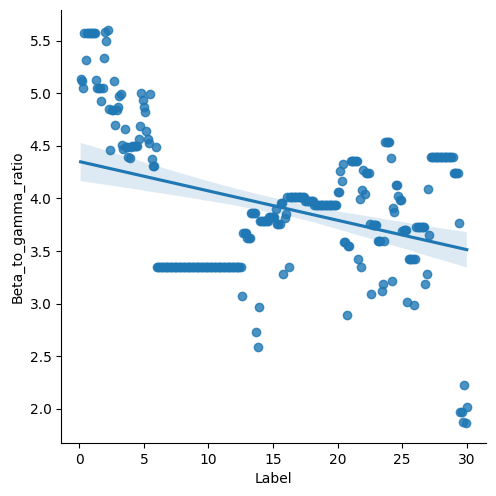

Sbj ID:  35


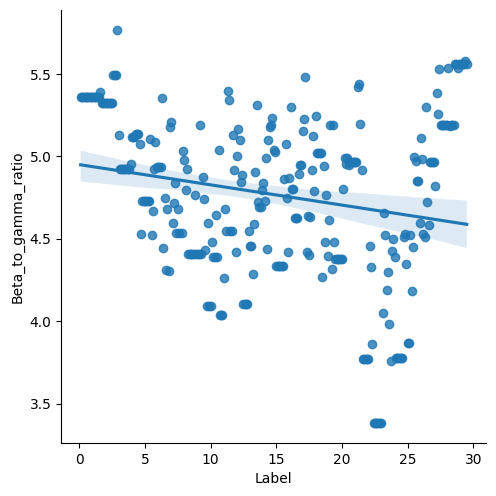

Sbj ID:  56


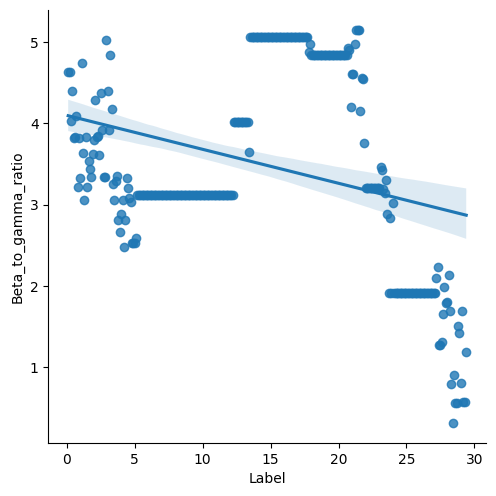

Sbj ID:  77


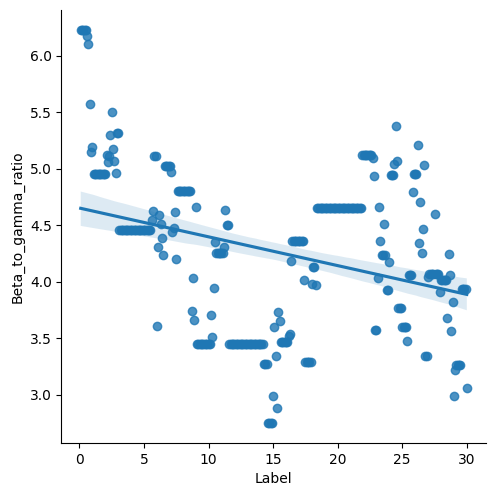

Sbj ID:  159


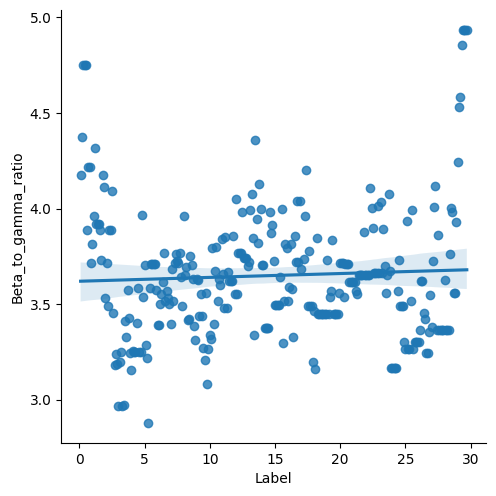

Sbj ID:  284


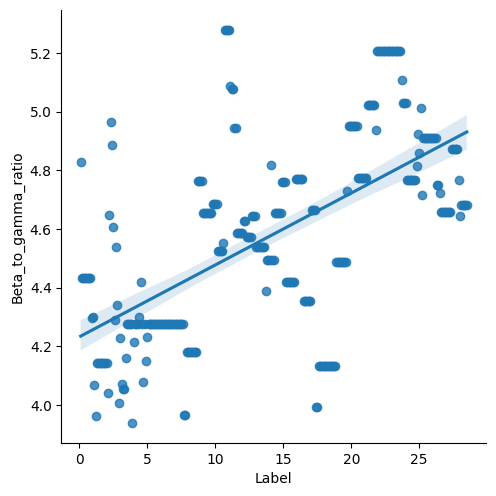

Sbj ID:  288


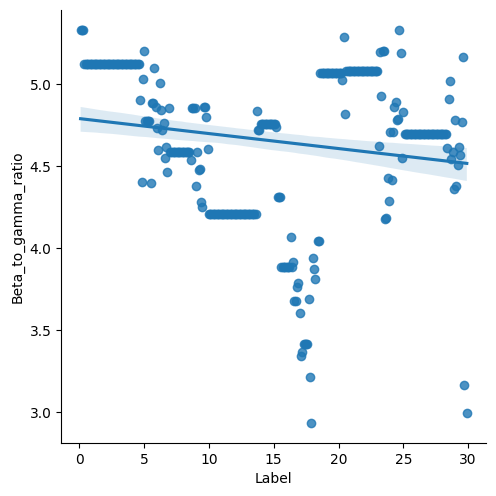

Sbj ID:  344


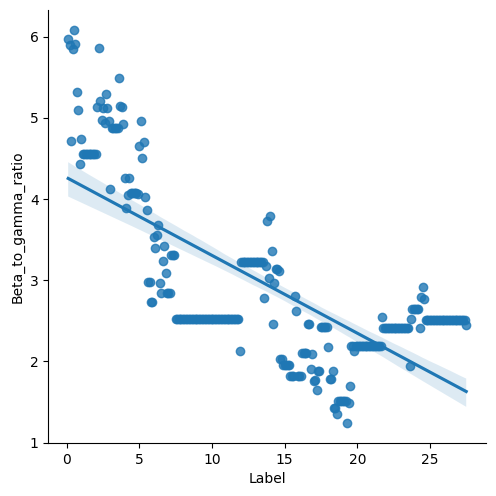

Sbj ID:  382


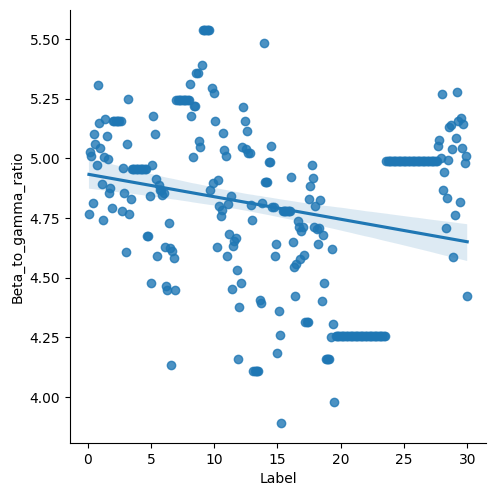

Sbj ID:  384


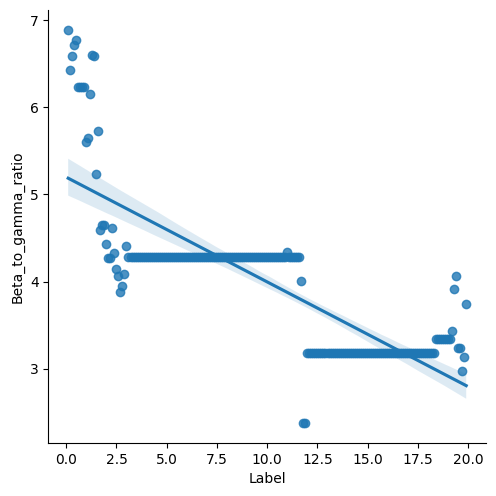

Sbj ID:  416


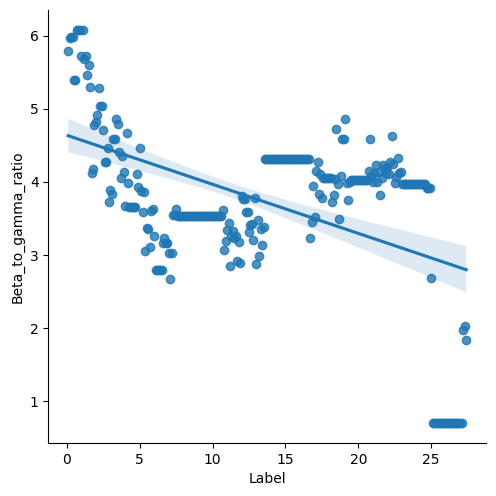

Sbj ID:  419


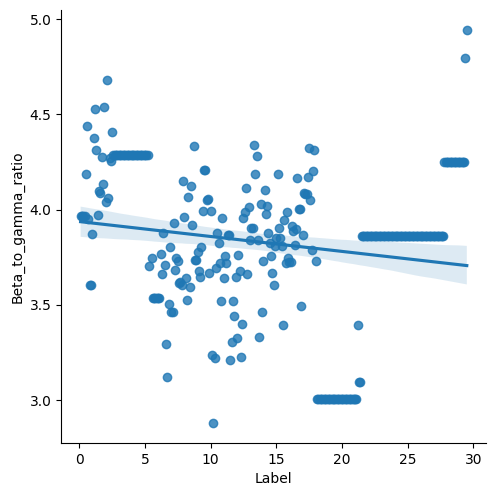

Sbj ID:  458


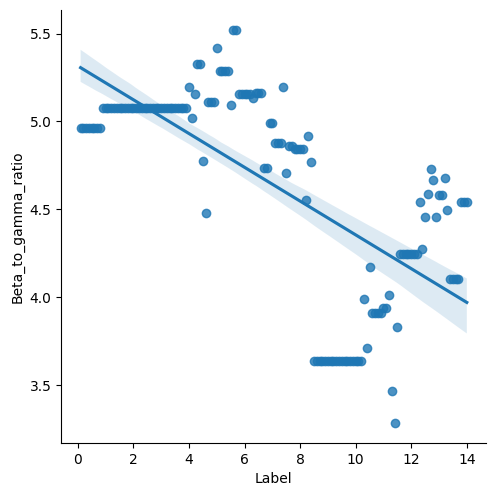

Sbj ID:  460


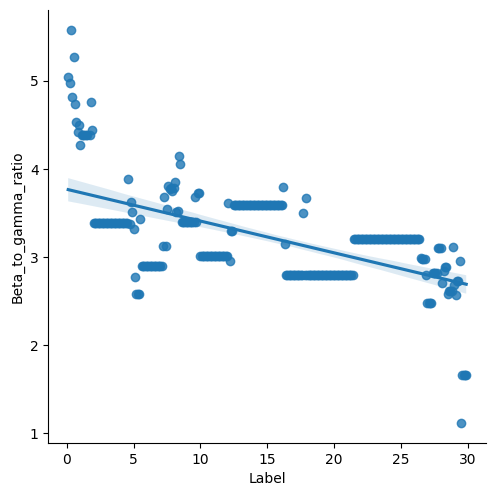

Sbj ID:  490


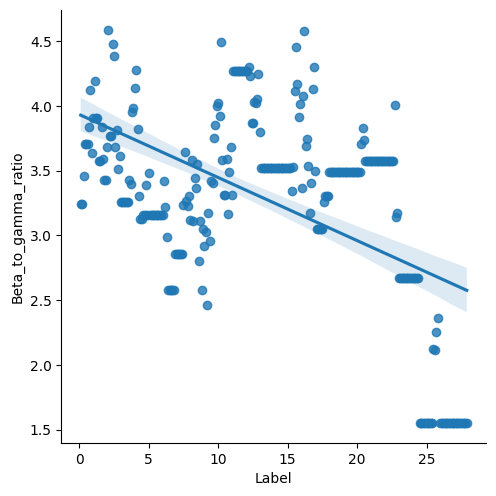

Sbj ID:  491


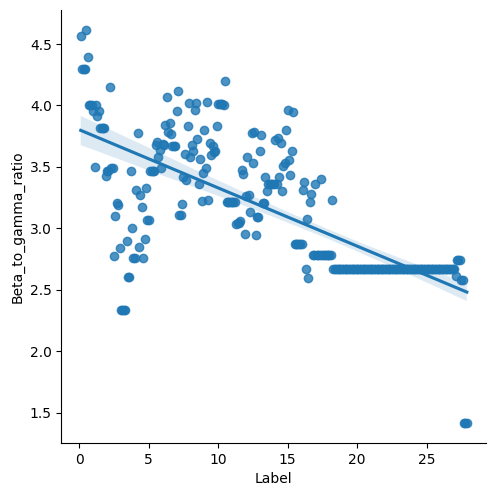

Sbj ID:  518


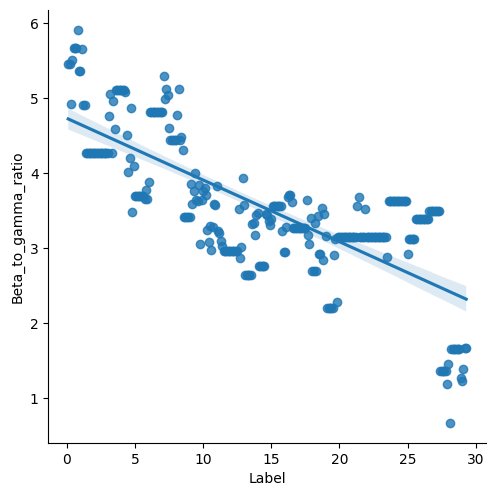

Sbj ID:  519


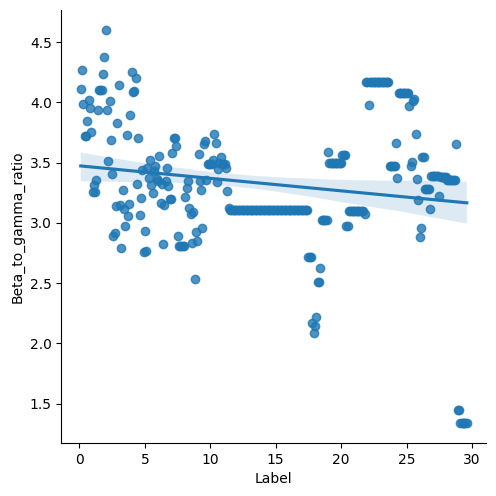

Sbj ID:  581


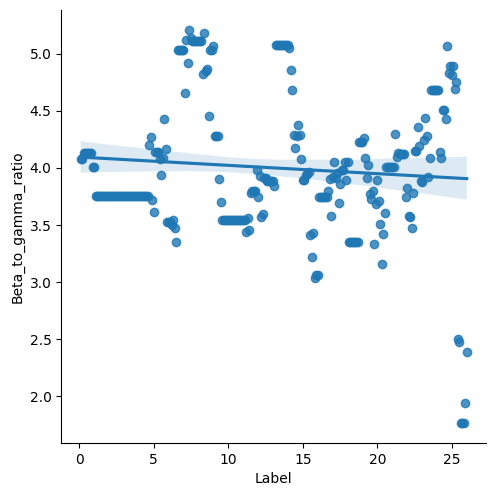

Sbj ID:  586


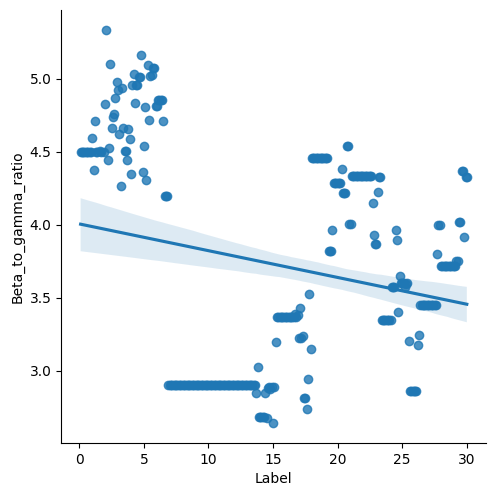

Sbj ID:  596


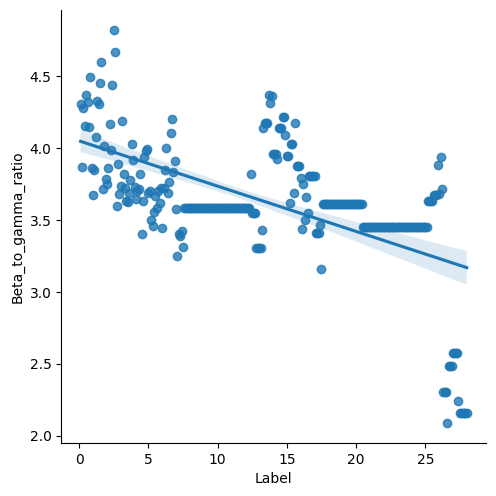

Sbj ID:  632


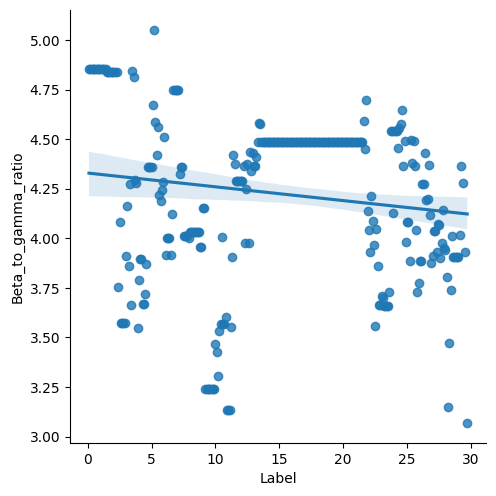

Sbj ID:  664


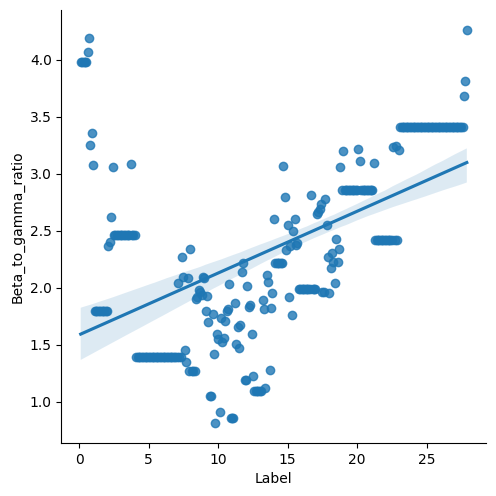

Sbj ID:  726


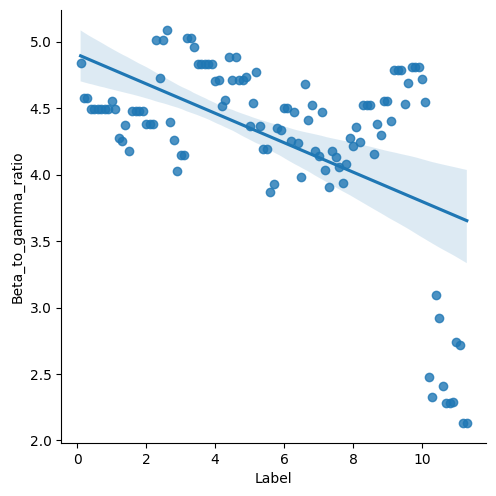

Sbj ID:  755


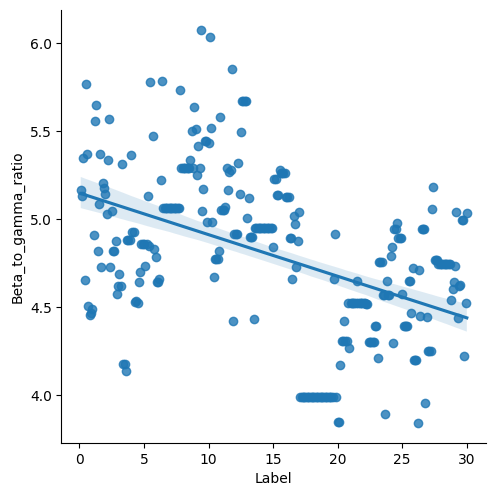

Sbj ID:  762


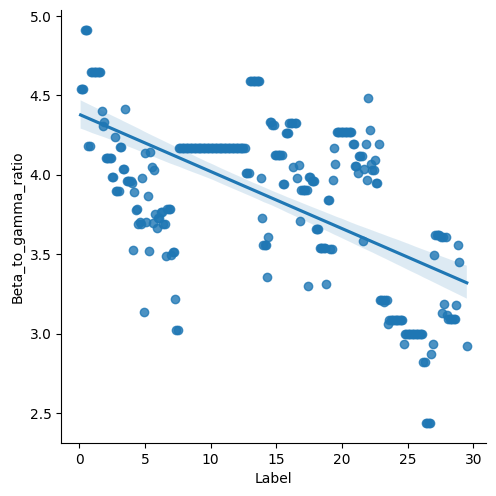

Sbj ID:  782


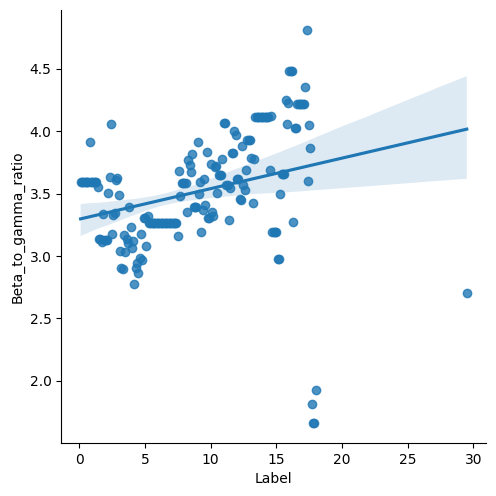

Sbj ID:  800


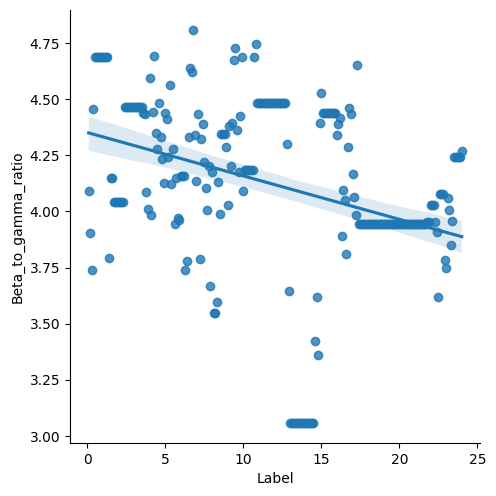

Sbj ID:  812


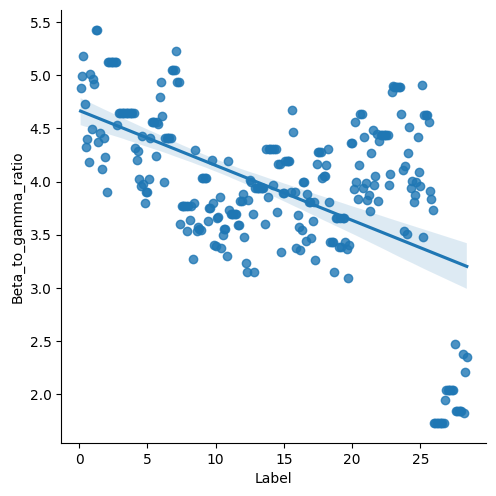

Sbj ID:  821


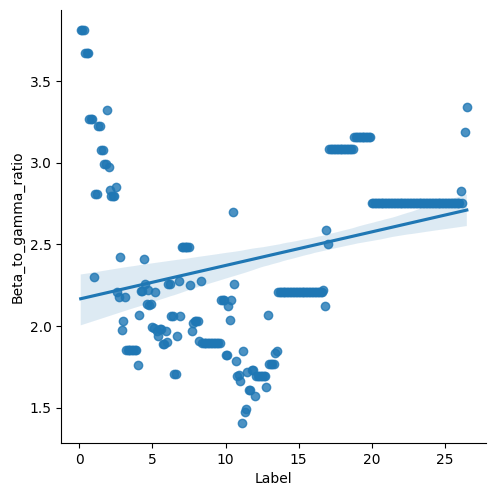

Sbj ID:  823


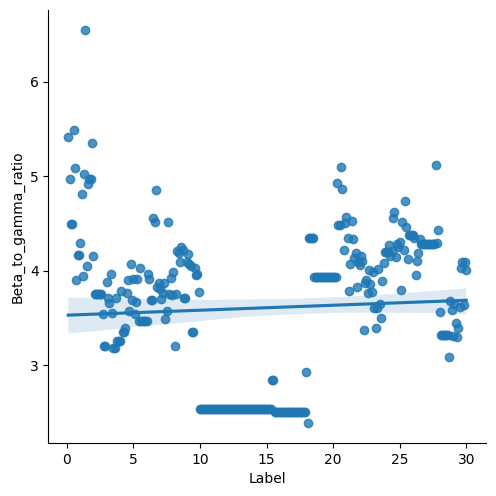

Sbj ID:  838


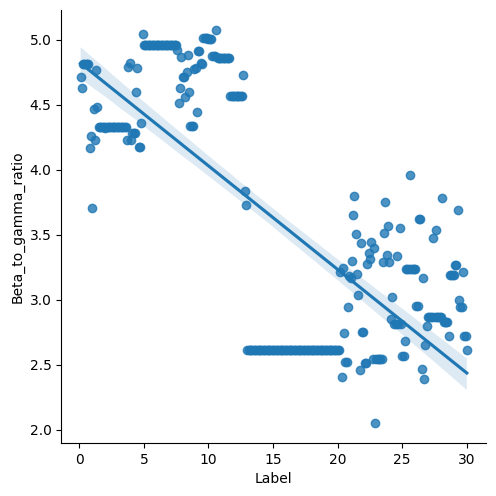

Sbj ID:  854


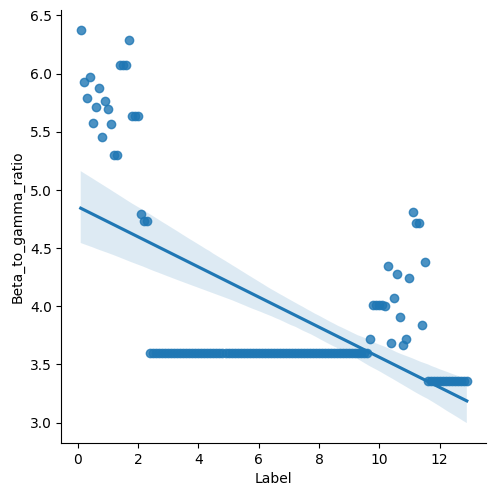

Sbj ID:  884


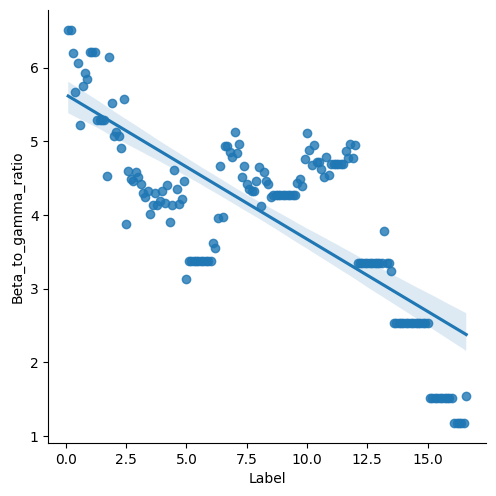

Sbj ID:  893


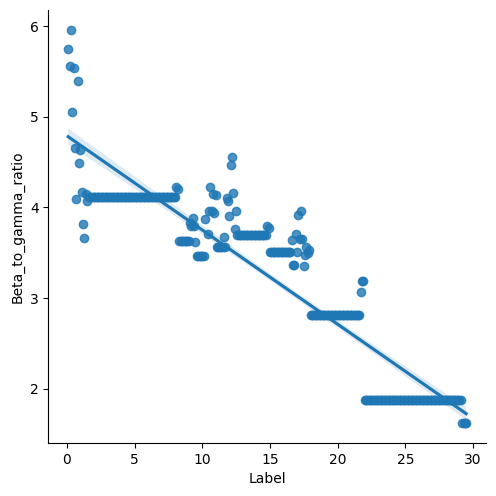

Sbj ID:  912


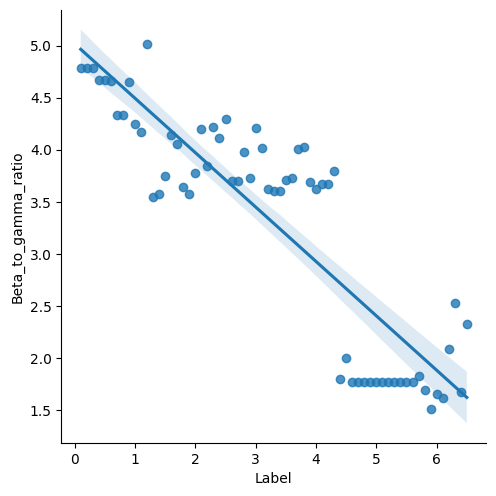

Sbj ID:  914


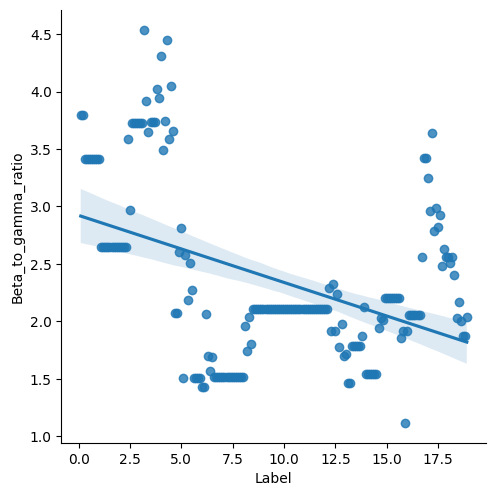

Sbj ID:  933


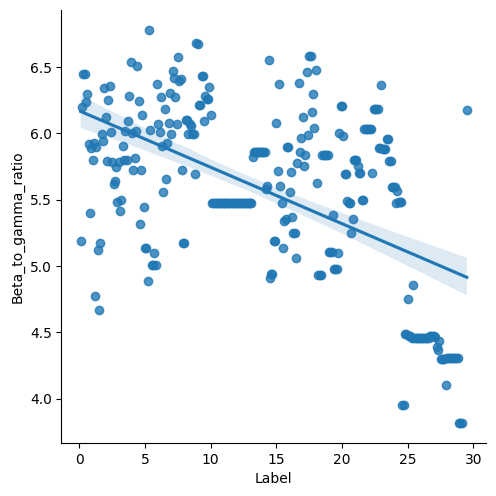

Sbj ID:  943


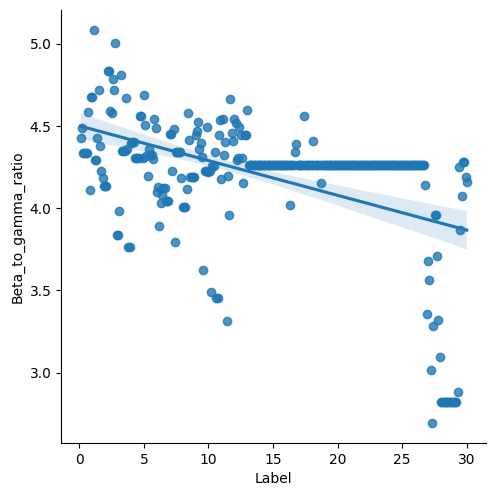

Sbj ID:  949


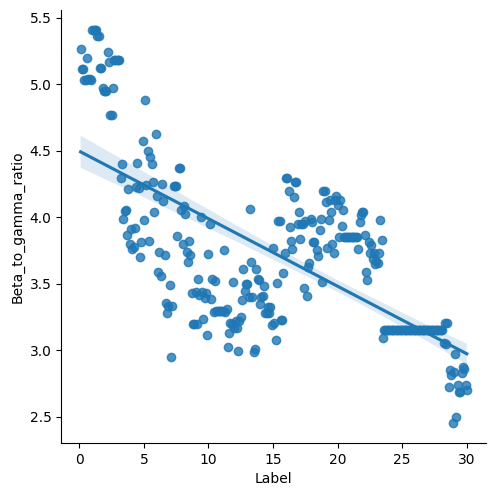

Sbj ID:  962


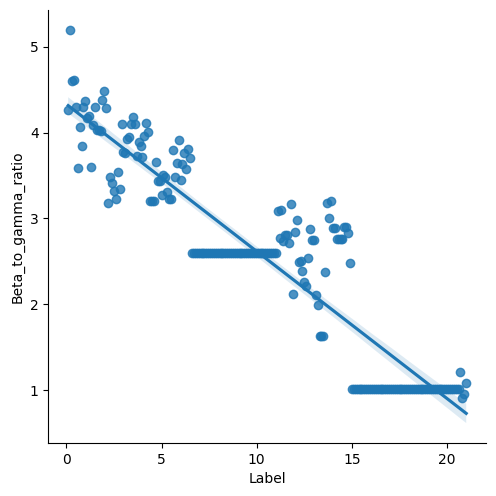

Sbj ID:  967


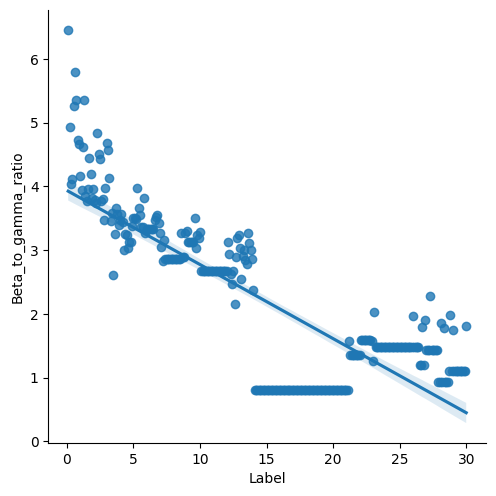

In [75]:
import seaborn as sns
import matplotlib.pyplot as plt

for i in mydata['Sbj_ID'].unique():
    print('Sbj ID: ', i)
    sns.pairplot(mydata[mydata['Sbj_ID'] == i], x_vars=['Label'], y_vars=['Beta_to_gamma_ratio'], height=5, aspect=1, kind='reg')
    plt.show()

Sbj ID:  2


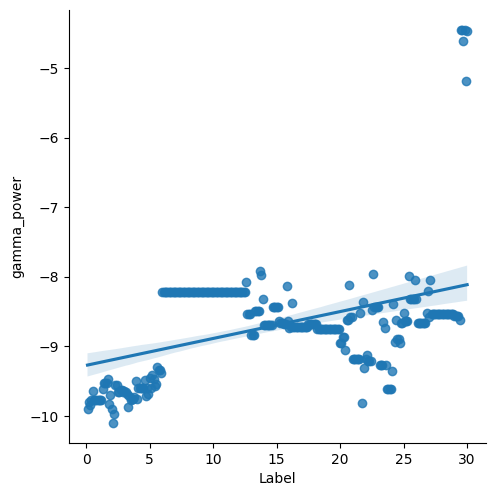

Sbj ID:  35


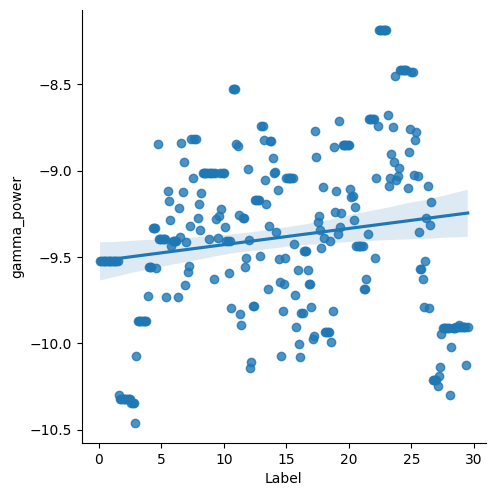

Sbj ID:  56


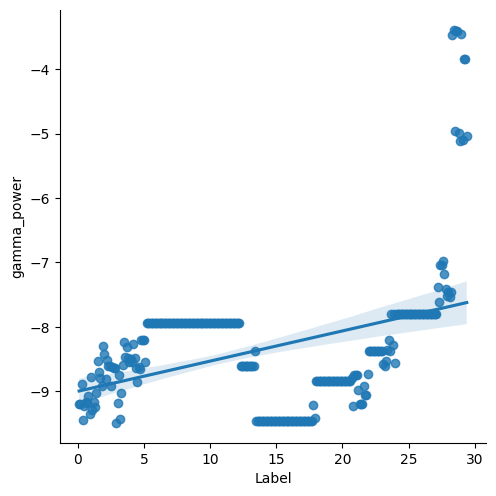

Sbj ID:  77


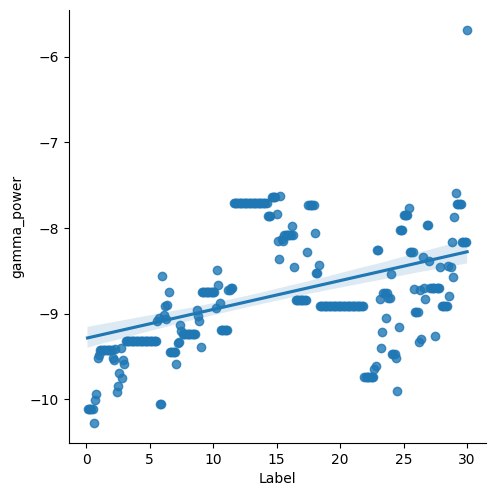

Sbj ID:  159


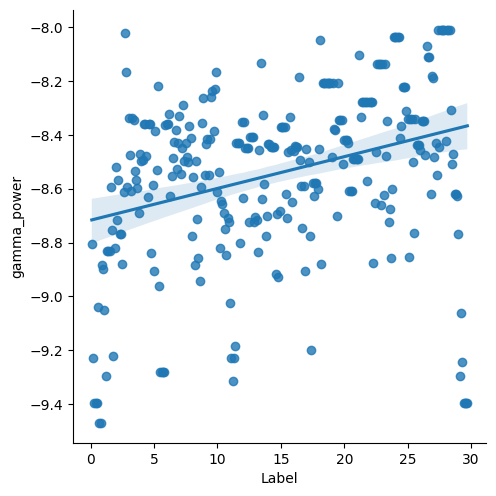

Sbj ID:  284


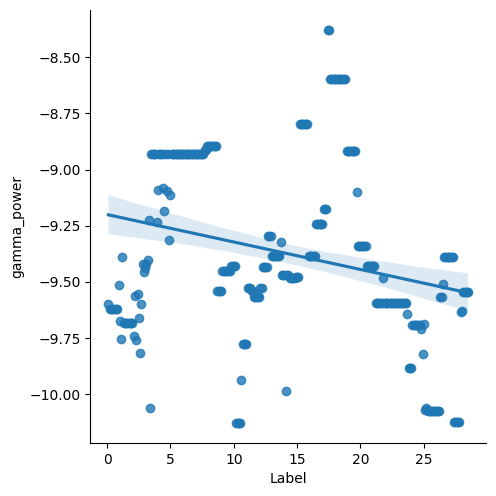

Sbj ID:  288


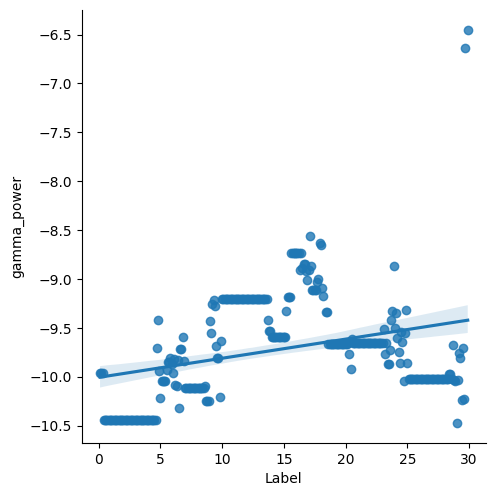

Sbj ID:  344


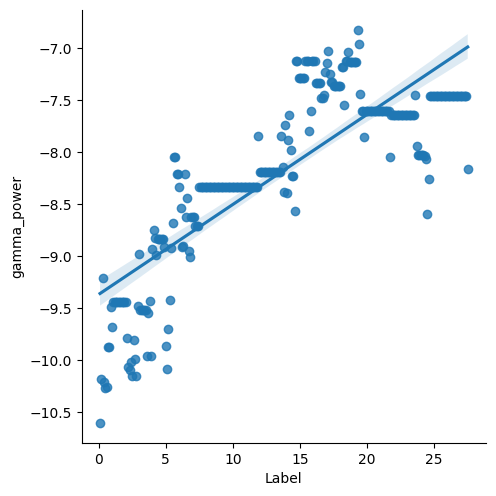

Sbj ID:  382


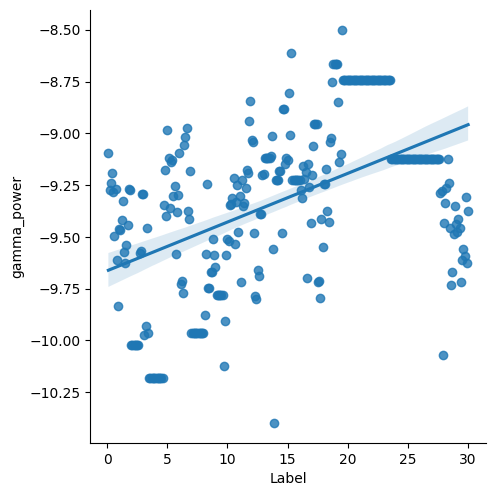

Sbj ID:  384


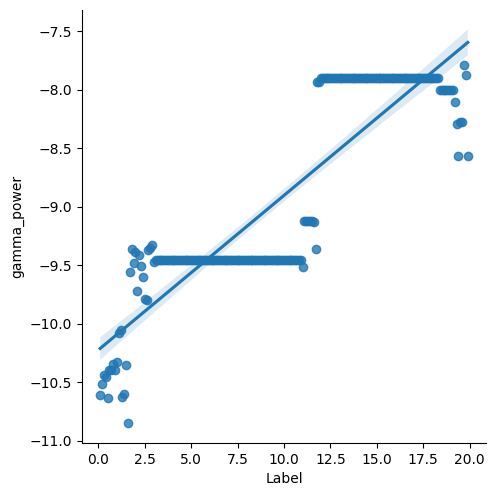

Sbj ID:  416


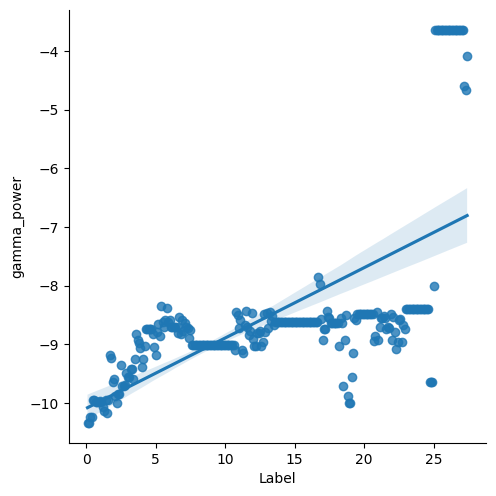

Sbj ID:  419


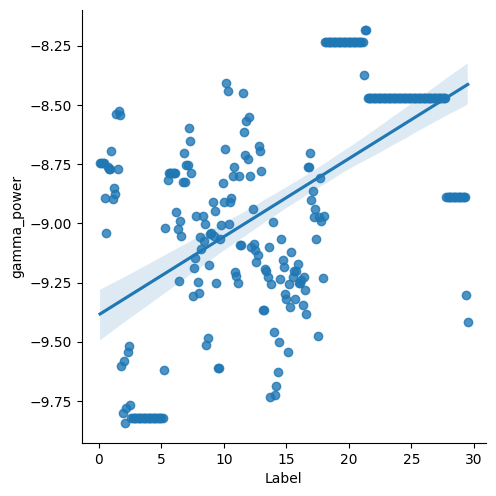

Sbj ID:  458


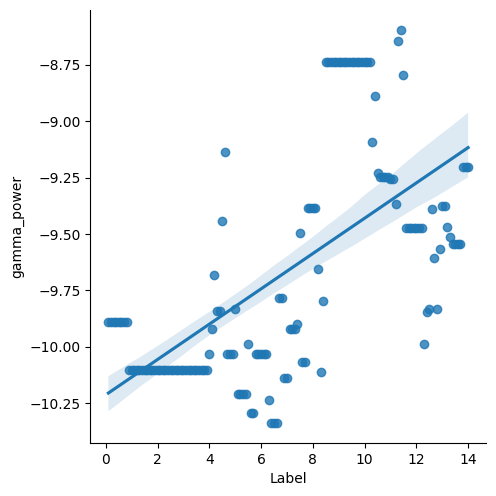

Sbj ID:  460


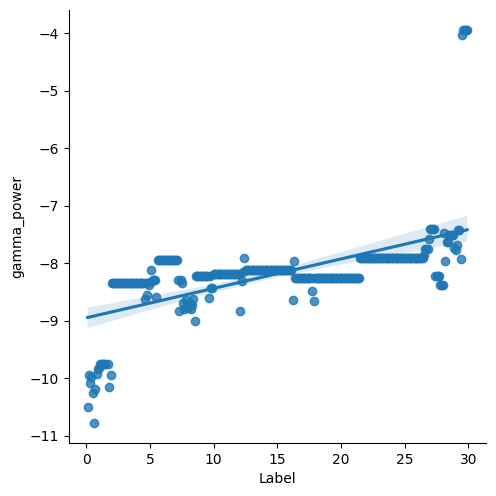

Sbj ID:  490


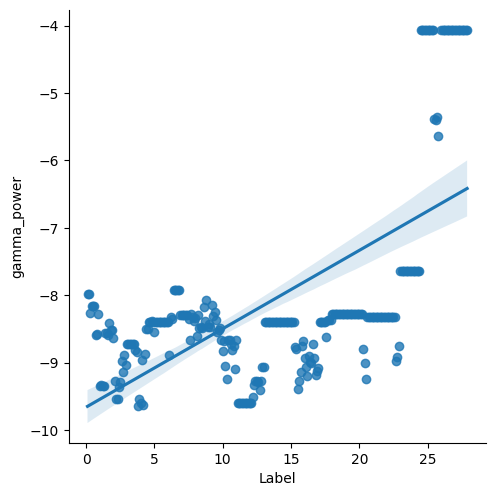

Sbj ID:  491


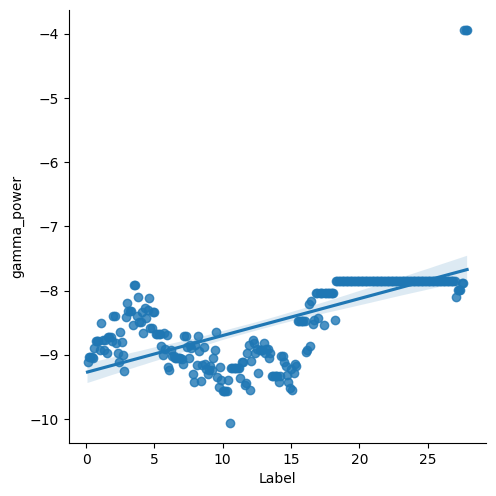

Sbj ID:  518


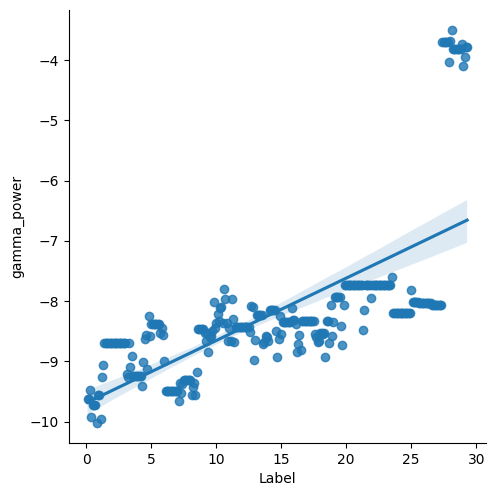

Sbj ID:  519


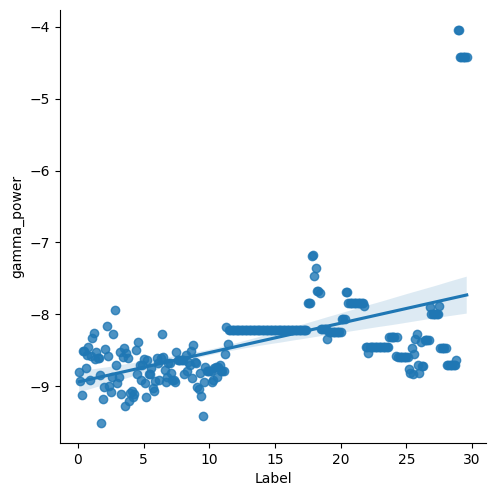

Sbj ID:  581


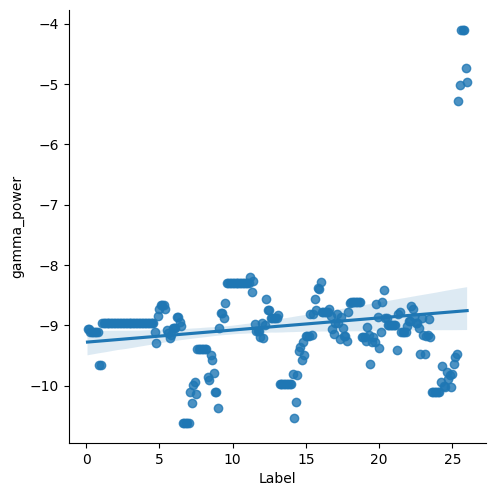

Sbj ID:  586


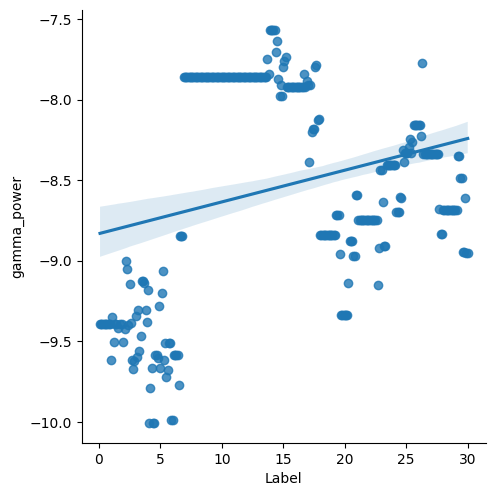

Sbj ID:  596


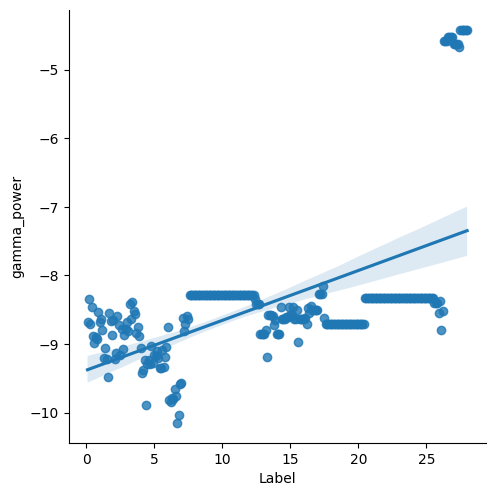

Sbj ID:  632


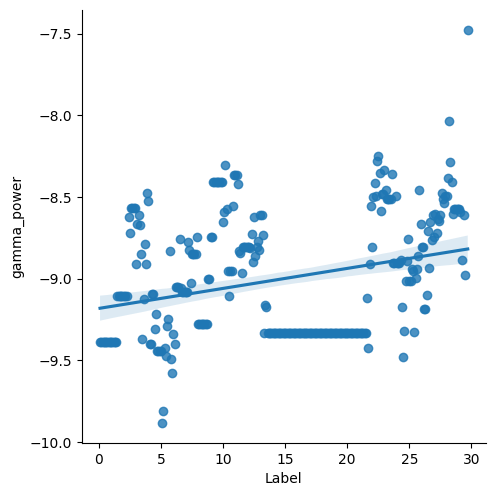

Sbj ID:  664


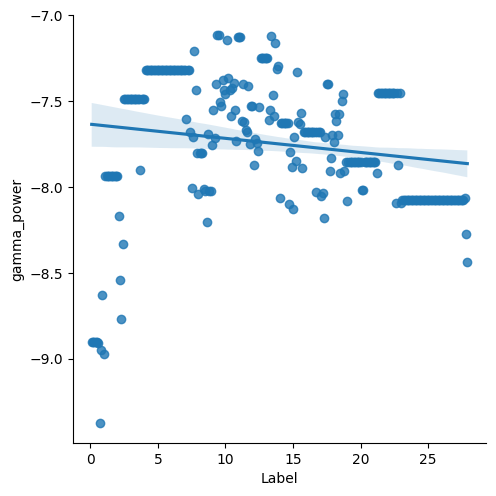

Sbj ID:  726


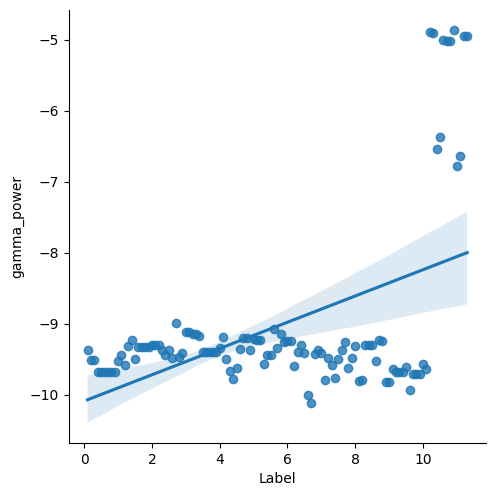

Sbj ID:  755


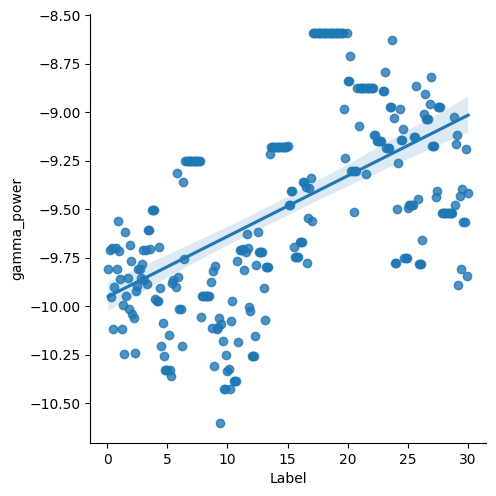

Sbj ID:  762


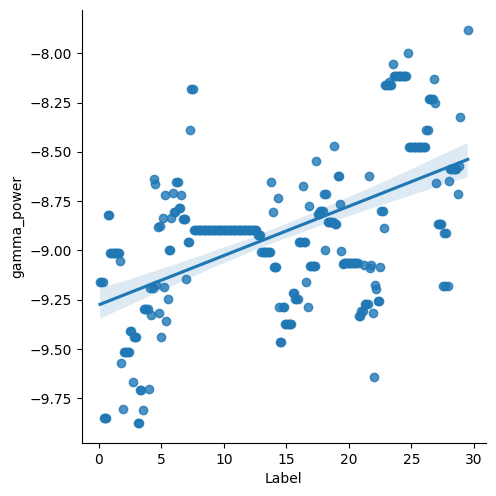

Sbj ID:  782


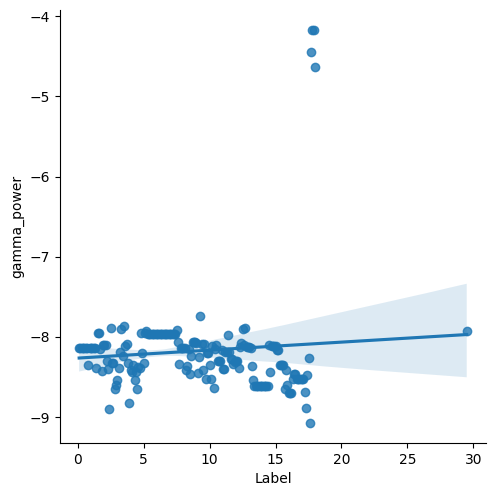

Sbj ID:  800


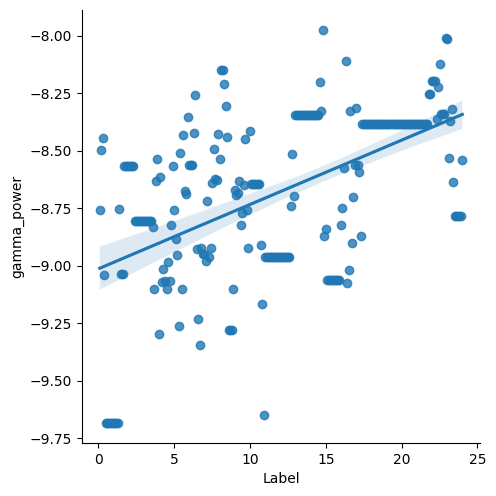

Sbj ID:  812


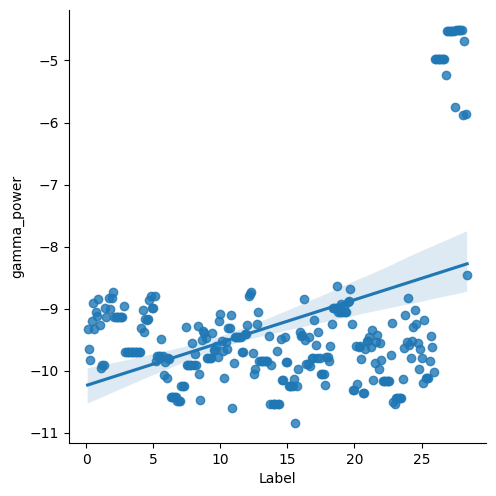

Sbj ID:  821


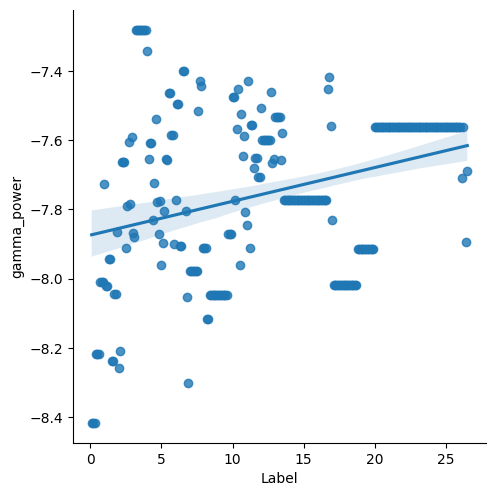

Sbj ID:  823


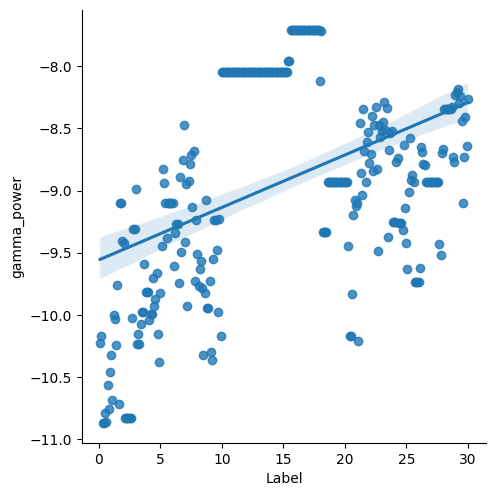

Sbj ID:  838


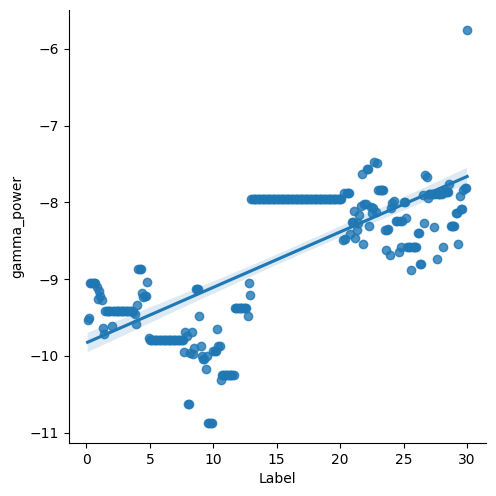

Sbj ID:  854


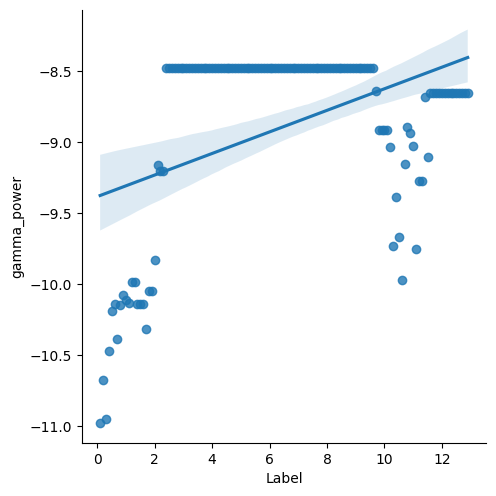

Sbj ID:  884


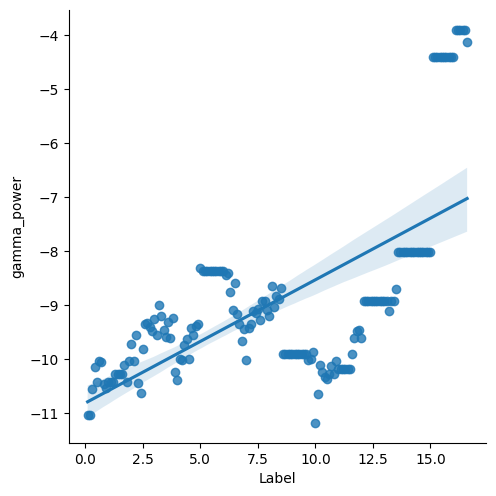

Sbj ID:  893


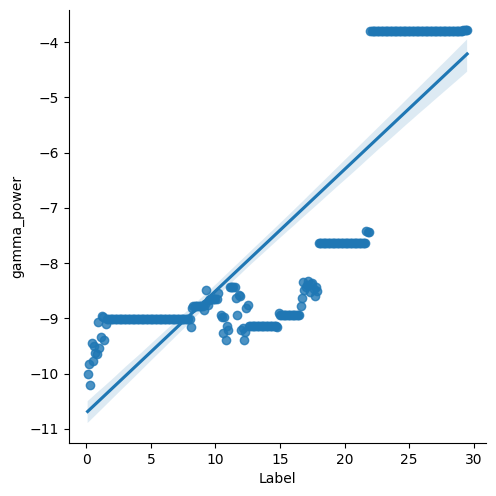

Sbj ID:  912


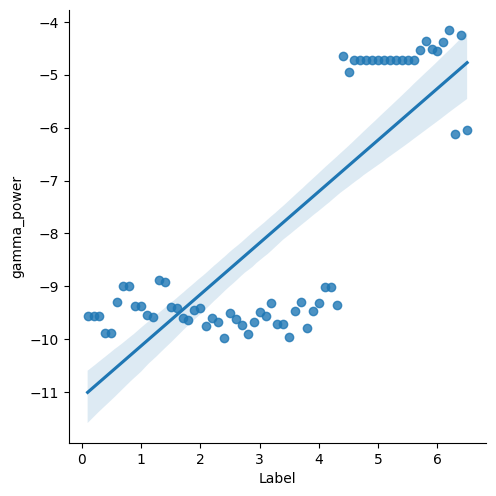

Sbj ID:  914


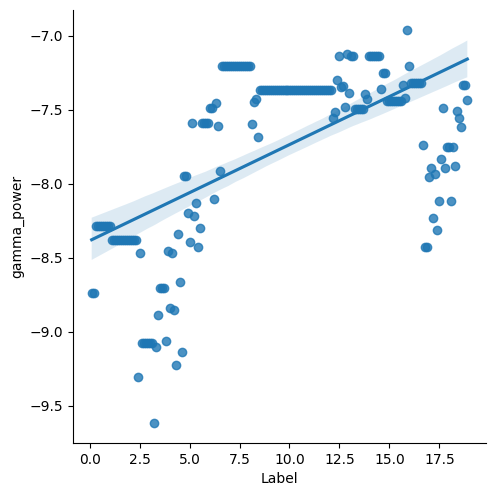

Sbj ID:  933


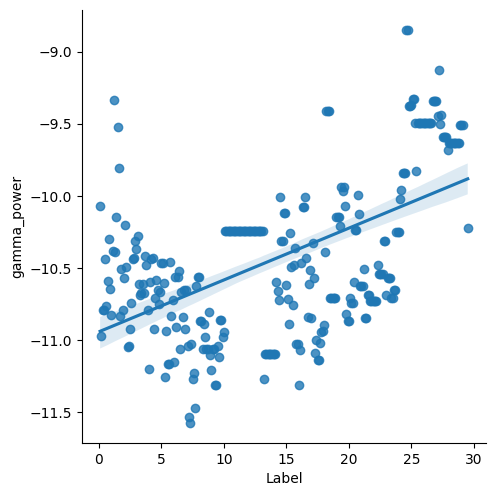

Sbj ID:  943


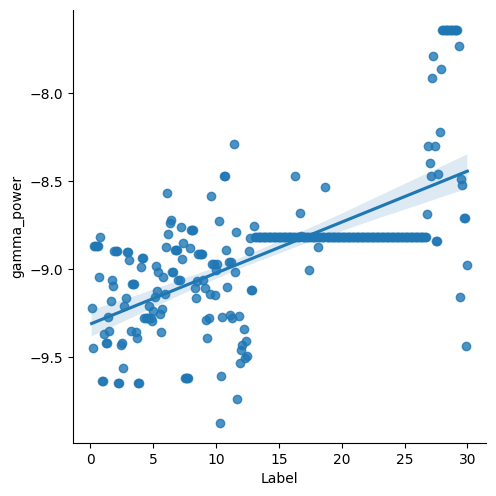

Sbj ID:  949


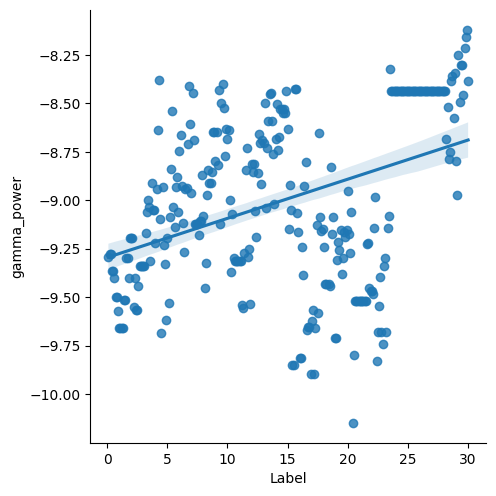

Sbj ID:  962


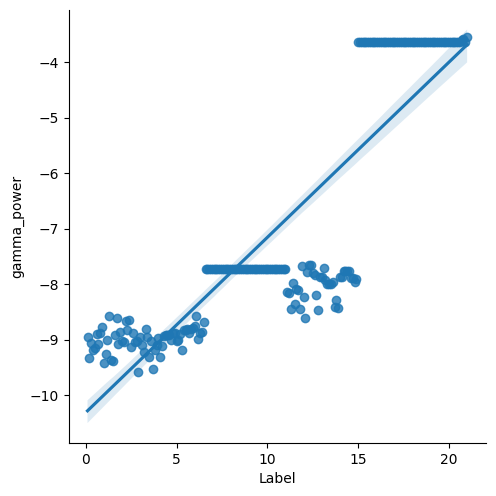

Sbj ID:  967


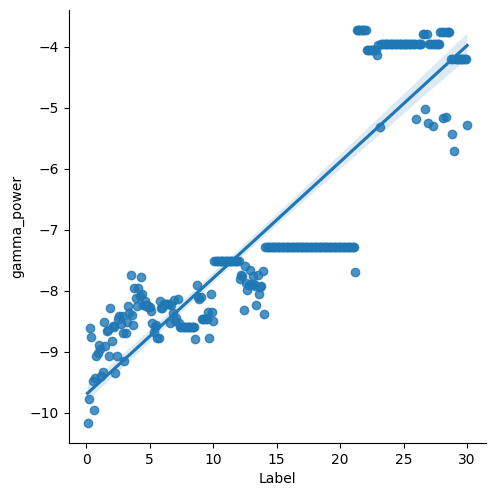

In [71]:
import seaborn as sns
import matplotlib.pyplot as plt

for i in mydata['Sbj_ID'].unique():
    print('Sbj ID: ', i)
    sns.pairplot(mydata[mydata['Sbj_ID'] == i], x_vars=['Label'], y_vars=['gamma_power'], height=5, aspect=1, kind='reg')
    plt.show()

# Regression from single feature veactor of extracted EEG period 

In [14]:
import pandas as pd
import numpy as np
import sklearn
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_val_predict

## Random Forest on the whole dataset

In [35]:
# Create X and y from dataframes to use in scikit-learn (drop Label, DleepStage, Sbj_ID and ifCleanOnset columns)

X = mydata.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)
y = mydata['Label']

# Split the data into training and testing sets

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

# Create a random forest Regressor

rf = RandomForestRegressor(n_estimators=100)
 
# Perform cross-validation and get the predictions

predictions = cross_val_predict(rf, X_train, y_train, cv=10)



In [36]:
import matplotlib.pyplot as plt

# Create a function for plotting the sorted feature importances in a long horizontal bar chart and increased font size

def plot_feature_importances(model, X):
    importances = model.feature_importances_
    indices = np.argsort(importances)[::-1]
    names = [X.columns[i] for i in indices]
    fig, ax = plt.subplots(figsize=(16, 24), dpi=80)
    ax.barh(range(X.shape[1]), importances[indices], align='center')
    ax.set_yticks(range(X.shape[1]))
    ax.set_yticklabels(names, fontsize=16)
    ax.set_xlabel('Importance')
    ax.set_ylabel('Feature')
    ax.set_title('Feature importances')
    plt.show()

    return importances, indices, names

# Create a funciton for evaluating the performance of the model on the test data

def evaluate_performance_test(model, X_test, y_test):

    predictions = model.predict(X_test)

    errors = abs(y_test - predictions)
    mape = 100 * (errors / y_test)
    accuracy = 100 - np.mean(mape)
    mse = sklearn.metrics.mean_squared_error(y_test, predictions)
    rmse = np.sqrt(mse)
    r2 = sklearn.metrics.r2_score(y_test, predictions)


    print('Mean Absolute Error:', round(np.mean(errors), 2))
    print('Accuracy:', round(accuracy, 2), '%.')
    print('Mean Squared Error:', round(mse, 2))
    print('Root Mean Squared Error:', round(rmse, 2))
    print('R2:', round(r2, 2))


    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1)
    plt.scatter(y_test, predictions)
    plt.xlabel('Actual time to sleep onset')
    plt.ylabel('Predicted time to sleep onset')
    plt.title('Actual vs Predicted time to sleep onset')
    plt.show()

    residuals = y_test - predictions
    plt.scatter(y_test, residuals)
    plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1)
    plt.xlabel('Actual time to sleep onset')
    plt.ylabel('Residuals')
    plt.title('Actual vs Residuals')
    plt.show()

    plt.hist(residuals)
    plt.xlabel('Residuals')
    plt.ylabel('Frequency')
    plt.title('Residuals distribution')
    plt.show()

    return predictions, errors, mape, accuracy, residuals

# Create a function for evaluating the performance of the model on the training data given the predictions it produced

def evaluate_performance_train(model, X_train, y_train, predictions):
    
    errors = abs(y_train - predictions)
    mape = 100 * (errors / y_train)
    accuracy = 100 - np.mean(mape)
    mse = sklearn.metrics.mean_squared_error(y_train, predictions)
    rmse = np.sqrt(mse)
    r2 = sklearn.metrics.r2_score(y_train, predictions)


    print('Mean Absolute Error:', round(np.mean(errors), 2))
    print('Accuracy:', round(accuracy, 2), '%.')
    print('Mean Squared Error:', round(mse, 2))
    print('Root Mean Squared Error:', round(rmse, 2))
    print('R2:', round(r2, 2))

    plt.plot([y_train.min(), y_train.max()], [y_train.min(), y_train.max()], 'k--', lw=1)
    plt.scatter(y_train, predictions)
    plt.xlabel('Actual time to sleep onset')
    plt.ylabel('Predicted time to sleep onset')
    plt.title('Actual vs Predicted time to sleep onset')
    plt.show()

    residuals = y_train - predictions
    plt.scatter(y_train, residuals)
    plt.plot([y_train.min(), y_train.max()], [0, 0], 'k--', lw=1)
    plt.xlabel('Actual time to sleep onset')
    plt.ylabel('Residuals')
    plt.title('Actual vs Residuals')
    plt.show()

    plt.hist(residuals)
    plt.xlabel('Residuals')
    plt.ylabel('Frequency')
    plt.title('Residuals distribution')
    plt.show()

    return errors, mape, accuracy, residuals, mse, rmse, r2

Mean Absolute Error: 2.58
Accuracy: 8.42 %.
Mean Squared Error: 16.54
Root Mean Squared Error: 4.07
R2: 0.76


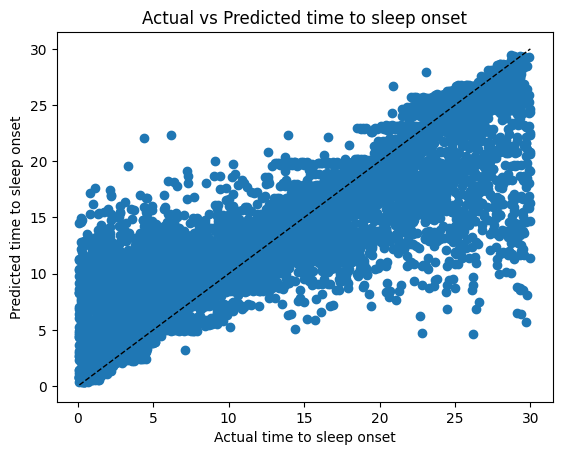

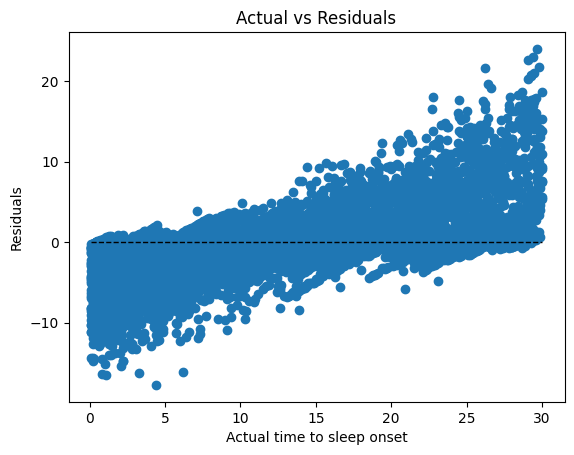

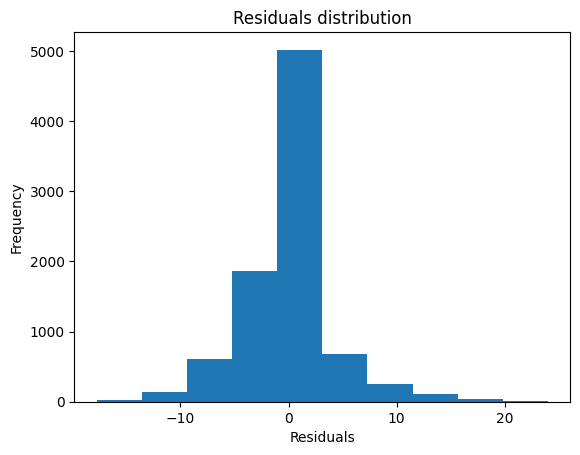

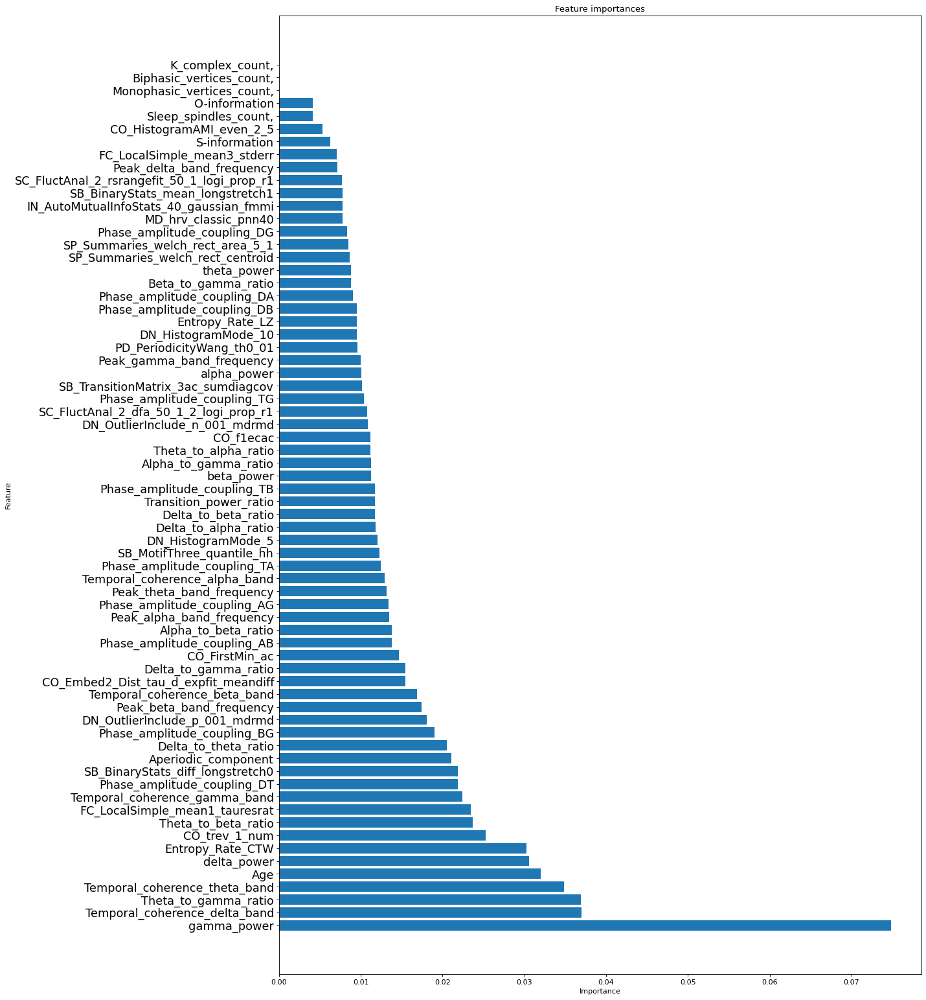

In [37]:
# evaluate the predictions made during cross-validation

errors, mape, accuracy, residuals, mse, rmse, r2 = evaluate_performance_train(rf, X_train, y_train, predictions)


# Plot the feature importances
rf.fit(X_train, y_train)
importances, indices, names = plot_feature_importances(rf, X_train)

Mean Absolute Error: 2.46
Accuracy: 31.68 %.
Mean Squared Error: 15.58
Root Mean Squared Error: 3.95
R2: 0.77


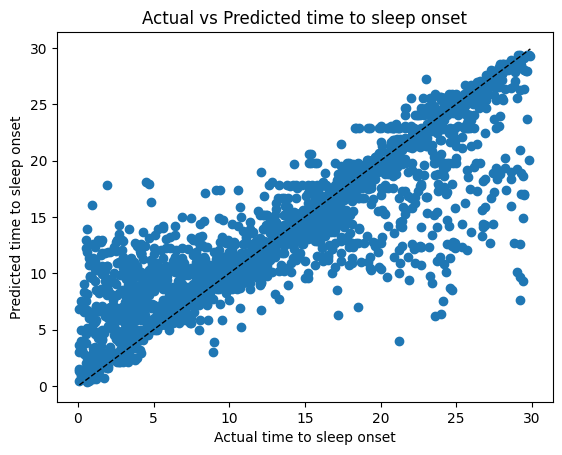

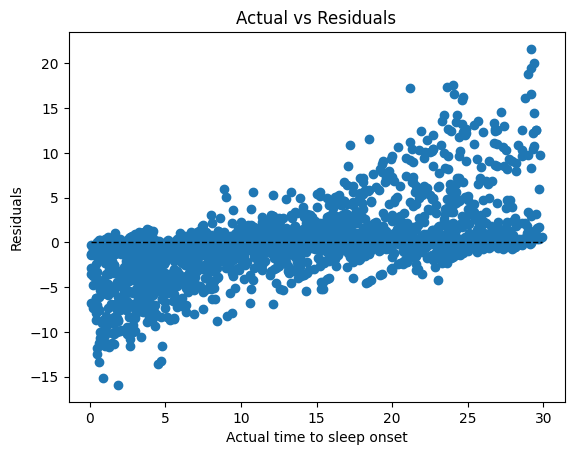

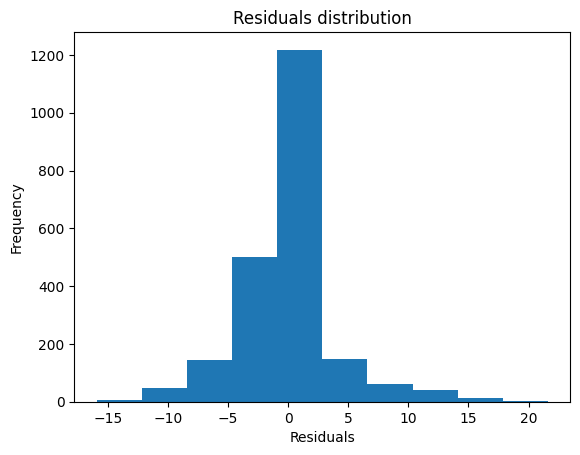

In [38]:
# Evaluate the performance of the model on the test data

predictions, errors, mape, accuracy, residuals,  = evaluate_performance_test(rf, X_test, y_test)



## Random forest only on clean sleep onsets (no intermittent single N2 epochs prior to sleep onset (2 consecutive epochs of N2)) ##

Mean Absolute Error: 2.46
Accuracy: 6.9 %.
Mean Squared Error: 15.17
Root Mean Squared Error: 3.9
R2: 0.78


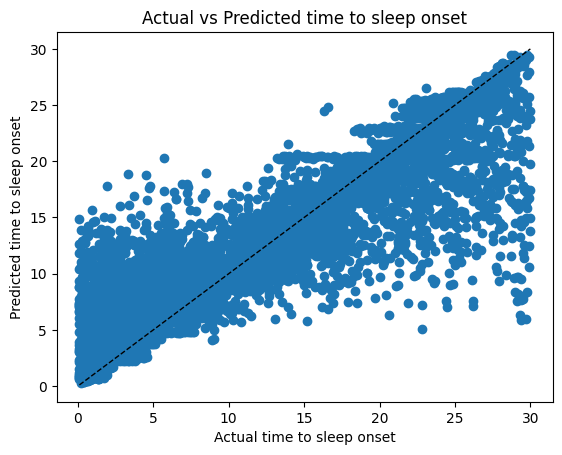

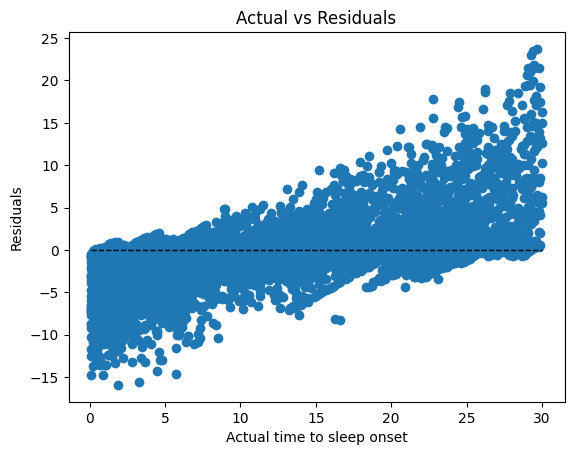

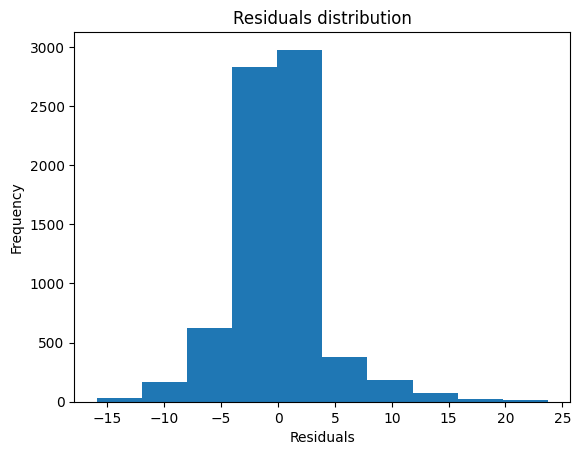

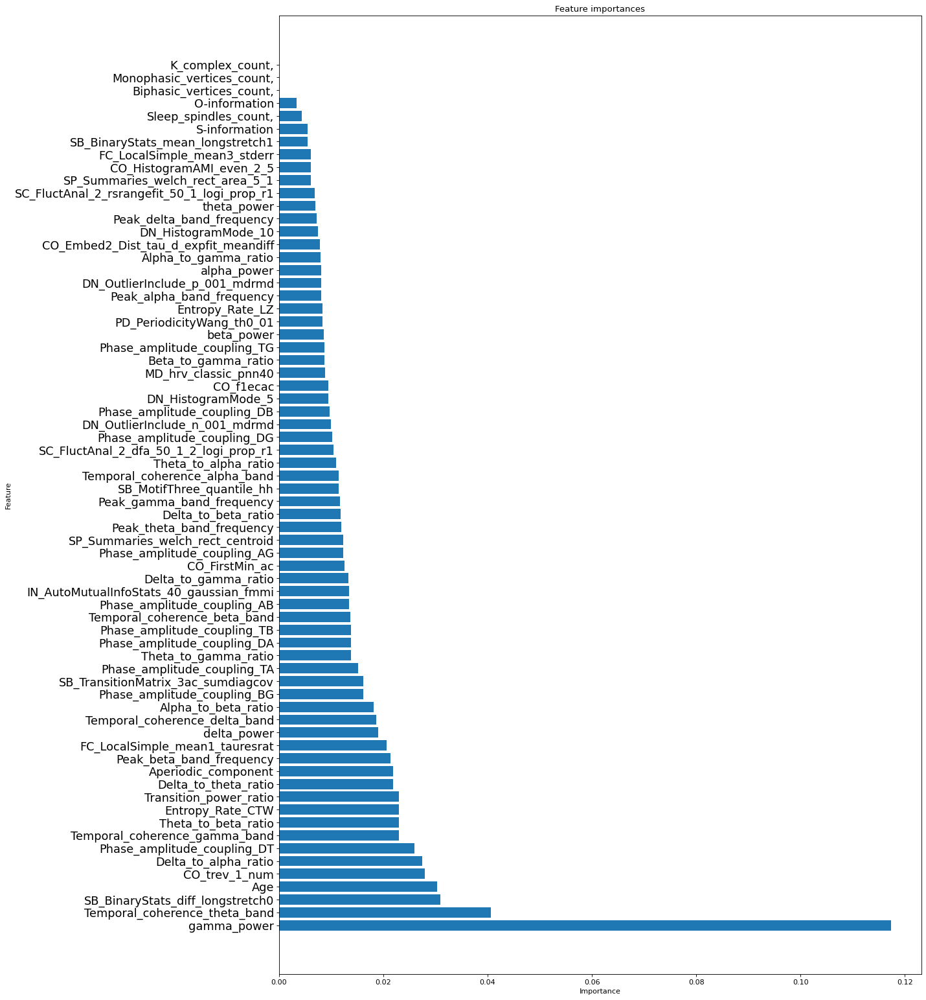

In [39]:
# Create a new dataset only with ifCleanOnset = 1

mydata_clean = mydata[mydata['ifCleanOnset'] == 1]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_clean = mydata_clean.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)

y_clean = mydata_clean['Label']

# Split the data into training and testing sets

X_train_clean, X_test_clean, y_train_clean, y_test_clean = train_test_split(X_clean, y_clean, test_size=0.2)

# Create a random forest Regressor

rf_clean = RandomForestRegressor(n_estimators=100)

# Perform cross-validation and get the predictions

predictions_clean = cross_val_predict(rf_clean, X_train_clean, y_train_clean, cv=10)

# evaluate the predictions made during cross-validation

errors_clean, mape_clean, accuracy_clean, residuals_clean, mse_clean, rmse_clean, r2_clean  = evaluate_performance_train(rf_clean, X_train_clean, y_train_clean, predictions_clean)

# Plot the feature importances
rf_clean.fit(X_train_clean, y_train_clean)

importances_clean, indices_clean, names_clean = plot_feature_importances(rf_clean, X_train_clean)




Mean Absolute Error: 2.33
Accuracy: 31.17 %.
Mean Squared Error: 14.24
Root Mean Squared Error: 3.77
R2: 0.79


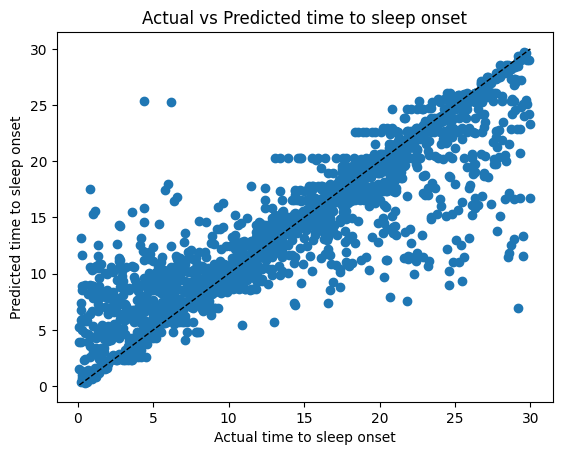

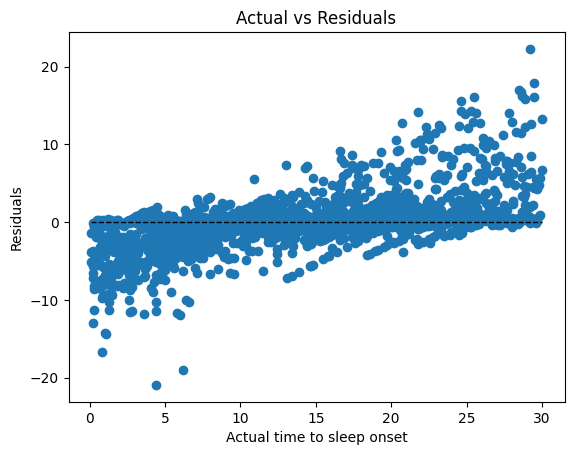

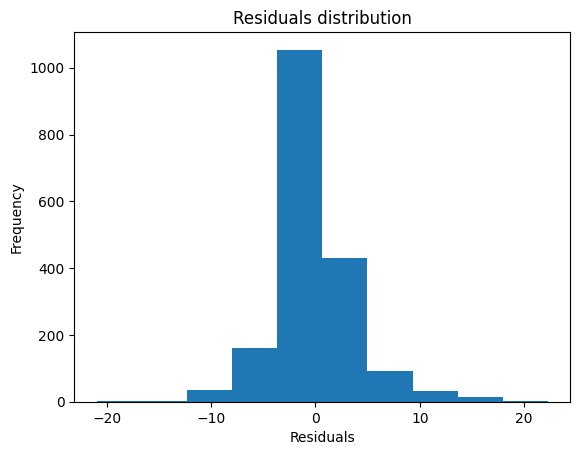

In [40]:
# Evaluate the performance of the model on the test data

predictions_clean, errors_clean, mape_clean, accuracy_clean, residuals_clean  = evaluate_performance_test(rf_clean, X_test_clean, y_test_clean)

## Random forest on **clean onset** and **15 minutes prior to sleep onset** (instead of 30 minutes) ##

Mean Absolute Error: 1.59
Accuracy: 19.13 %.
Mean Squared Error: 5.22
Root Mean Squared Error: 2.28
R2: 0.72


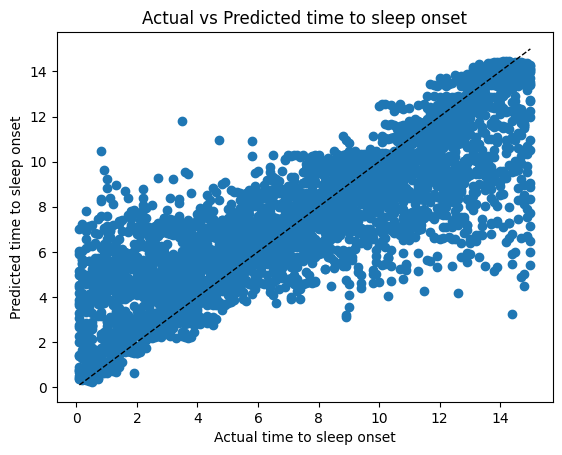

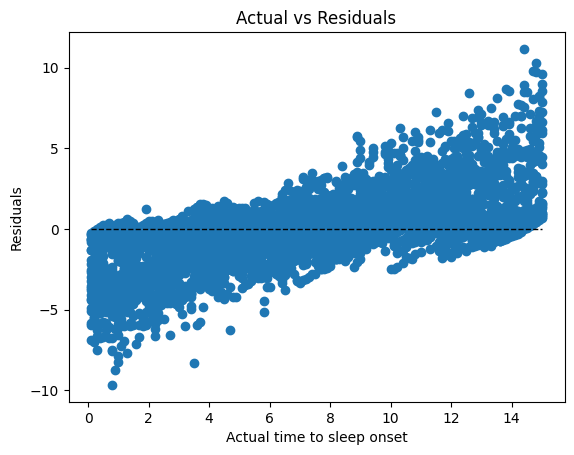

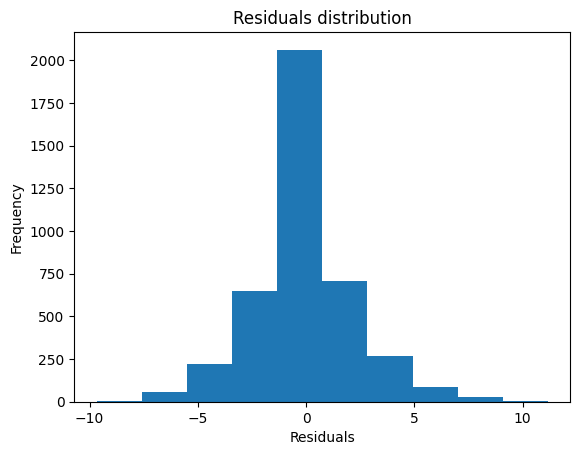

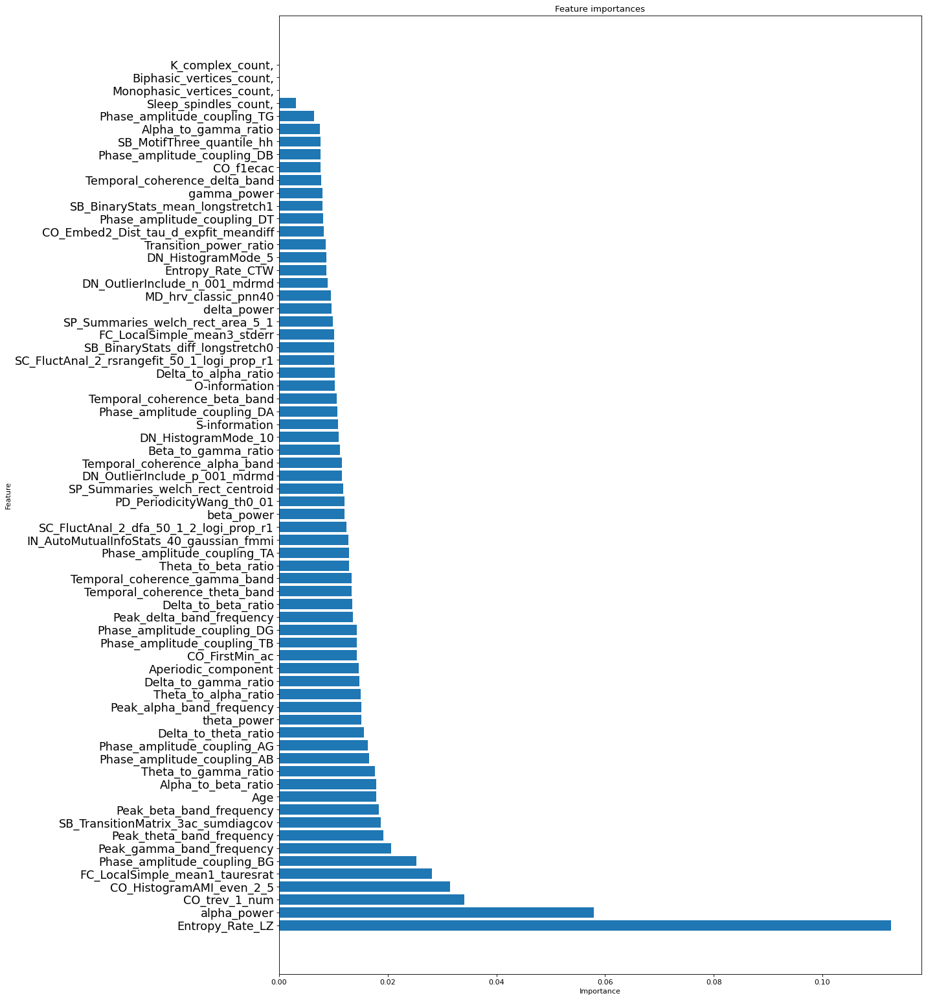

In [41]:
# Look at the clean onset (ifCleanOnset = 1) data and no longer than 15 minutes before the onset (Label <=15)

mydata_clean_15 = mydata_clean[mydata_clean['Label'] <= 15]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_clean_15 = mydata_clean_15.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)

y_clean_15 = mydata_clean_15['Label']

# Split the data into training and testing sets

X_train_clean_15, X_test_clean_15, y_train_clean_15, y_test_clean_15 = train_test_split(X_clean_15, y_clean_15, test_size=0.2)

# Create a random forest Regressor

rf_clean_15 = RandomForestRegressor(n_estimators=100)

# Perform cross-validation and get the predictions

predictions_clean_15 = cross_val_predict(rf_clean_15, X_train_clean_15, y_train_clean_15, cv=10)

# evaluate the predictions made during cross-validation

errors_clean_15, mape_clean_15, accuracy_clean_15, residuals_clean_15, mse_clean_15, rmse_clean_15, r2_clean_15 = evaluate_performance_train(rf_clean_15, X_train_clean_15, y_train_clean_15, predictions_clean_15)

# Plot the feature importances

rf_clean_15.fit(X_train_clean_15, y_train_clean_15)

importances_clean_15, indices_clean_15, names_clean_15 = plot_feature_importances(rf_clean_15, X_train_clean_15)




Mean Absolute Error: 1.64
Accuracy: -0.72 %.
Mean Squared Error: 5.58
Root Mean Squared Error: 2.36
R2: 0.71


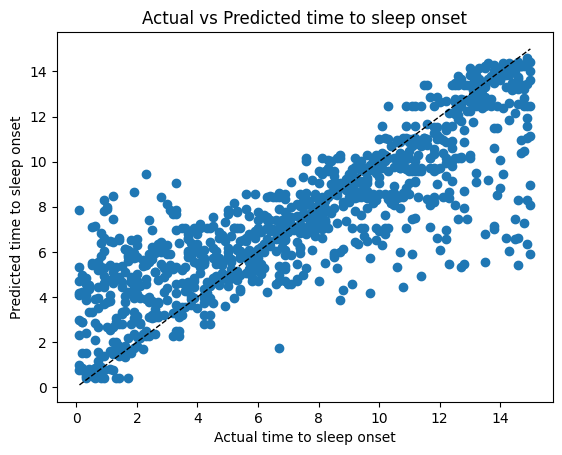

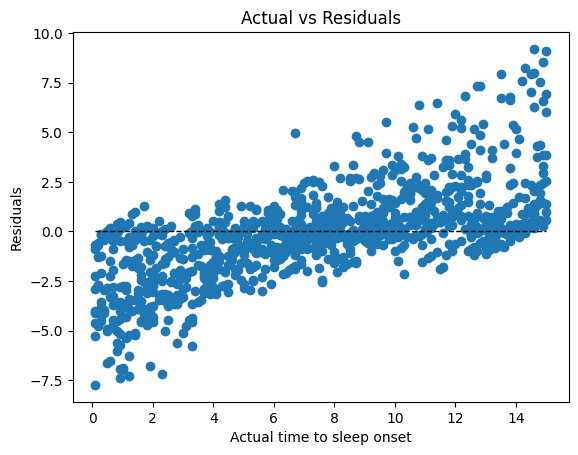

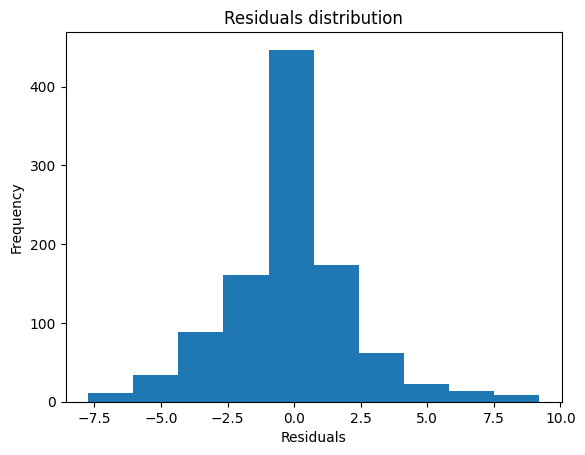

In [42]:
# Evaluate the performance of the model on the test data

predictions_clean_15, errors_clean_15, mape_clean_15, accuracy_clean_15, residuals_clean_15  = evaluate_performance_test(rf_clean_15, X_test_clean_15, y_test_clean_15)

Mean Absolute Error: 1.25
Accuracy: 20.25 %.
Mean Squared Error: 2.92
Root Mean Squared Error: 1.71
R2: 0.65


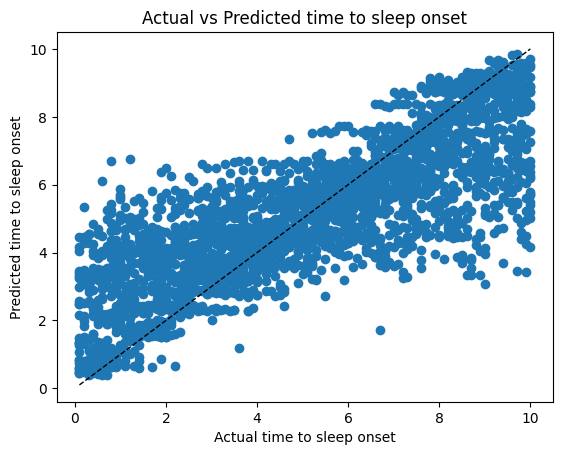

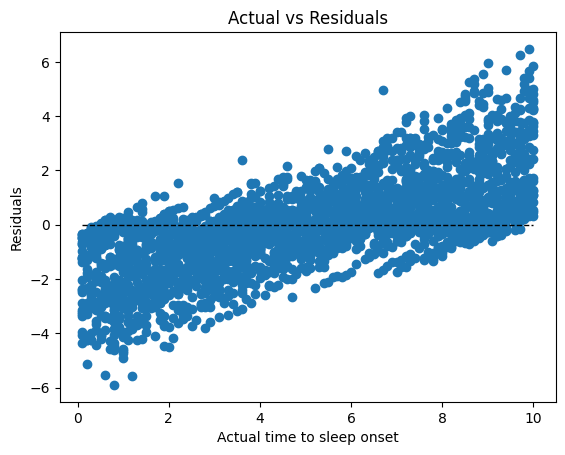

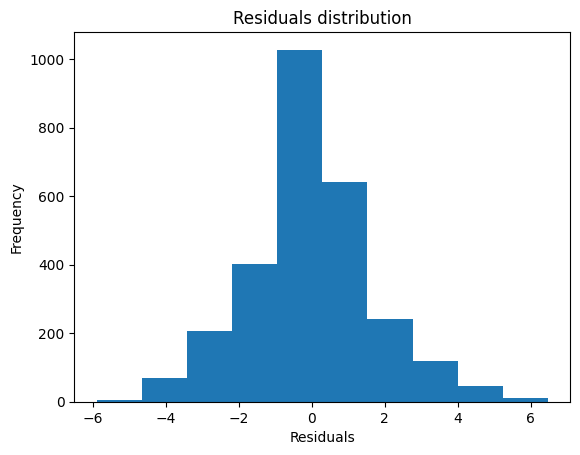

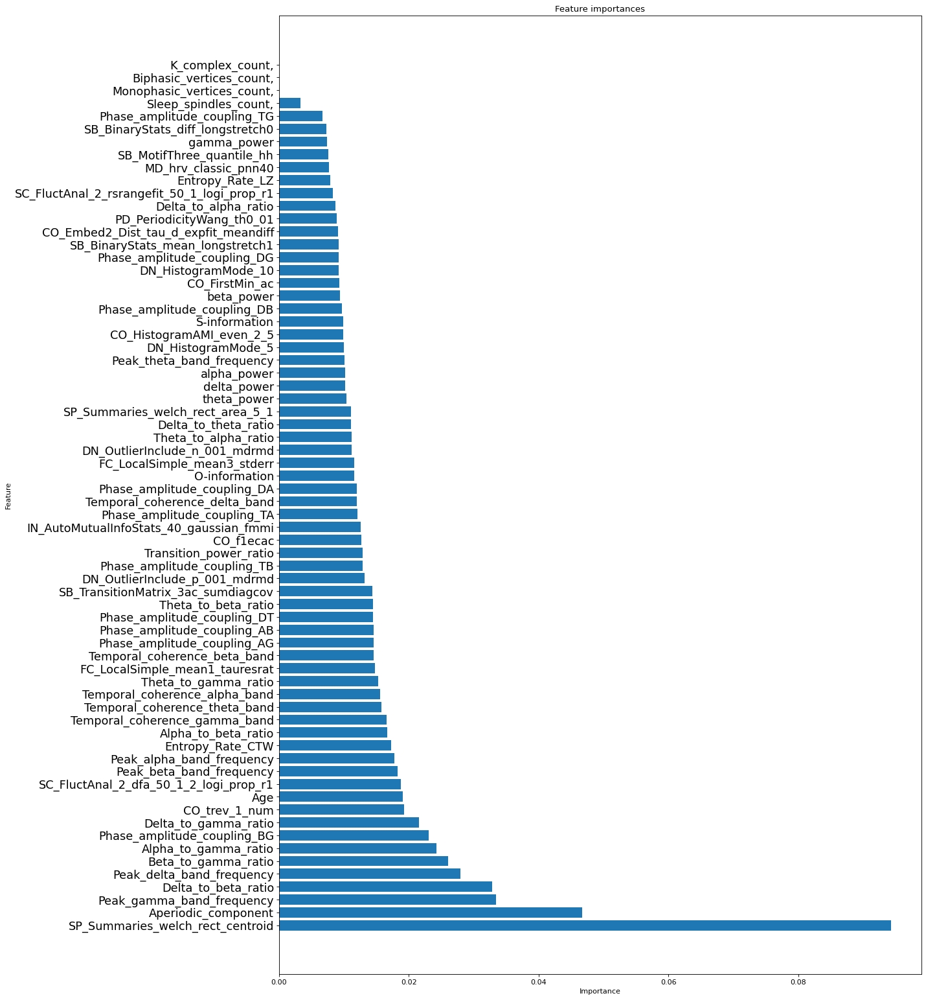

In [43]:

# Look at the clean onset (ifCleanOnset = 1) data and no longer than 10 minutes before the onset (Label <=10)

mydata_clean_10 = mydata_clean[mydata_clean['Label'] <= 10]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_clean_10 = mydata_clean_10.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)

y_clean_10 = mydata_clean_10['Label']

# Split the data into training and testing sets

X_train_clean_10, X_test_clean_10, y_train_clean_10, y_test_clean_10 = train_test_split(X_clean_10, y_clean_10, test_size=0.2)

# Create a random forest Regressor

rf_clean_10 = RandomForestRegressor(n_estimators=100)

# Perform cross-validation and get the predictions

predictions_clean_10 = cross_val_predict(rf_clean_10, X_train_clean_10, y_train_clean_10, cv=10)

# evaluate the predictions made during cross-validation

errors_clean_10, mape_clean_10, accuracy_clean_10, residuals_clean_10, mse_clean_10, rmse_clean_10, r2_clean_10 = evaluate_performance_train(rf_clean_10, X_train_clean_10, y_train_clean_10, predictions_clean_10)

# Plot the feature importances

rf_clean_10.fit(X_train_clean_10, y_train_clean_10)

importances_clean_10, indices_clean_10, names_clean_10 = plot_feature_importances(rf_clean_10, X_train_clean_10)




Mean Absolute Error: 1.21
Accuracy: 10.87 %.
Mean Squared Error: 2.81
Root Mean Squared Error: 1.67
R2: 0.66


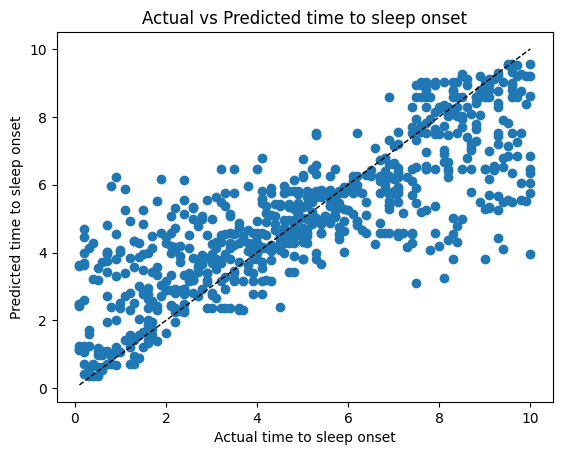

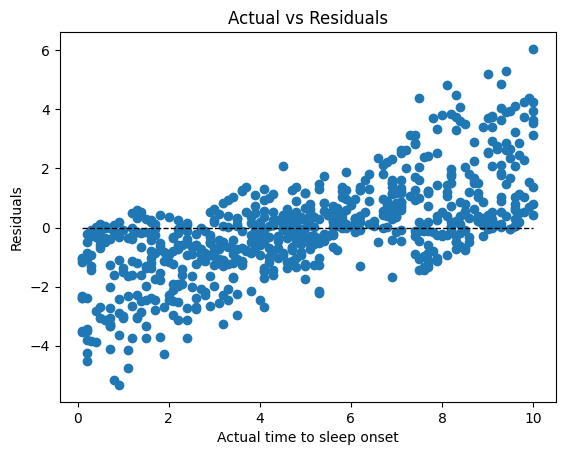

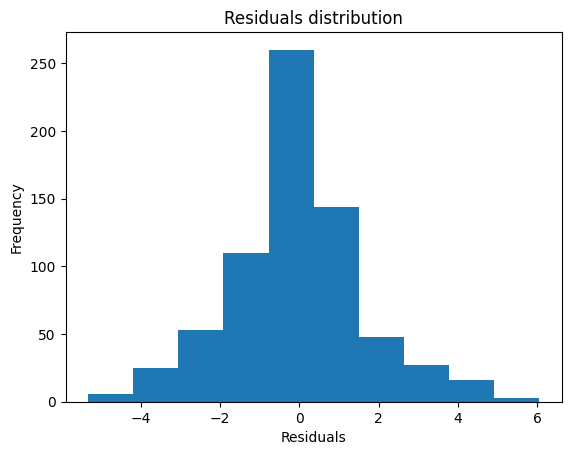

In [44]:
# Evaluate the performance of the model on the test data

predictions_clean_10, errors_clean_10, mape_clean_10, accuracy_clean_10, residuals_clean_10  = evaluate_performance_test(rf_clean_10, X_test_clean_10, y_test_clean_10)

## Random forest on **clean onset** and **30-15 minutes prior to sleep onset** ##

Mean Absolute Error: 1.55
Accuracy: 92.61 %.
Mean Squared Error: 5.16
Root Mean Squared Error: 2.27
R2: 0.7


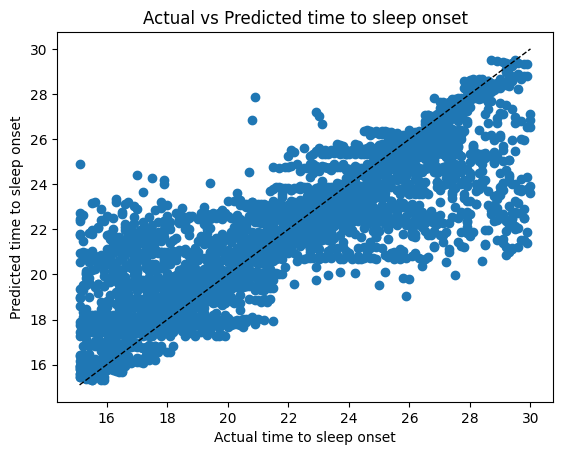

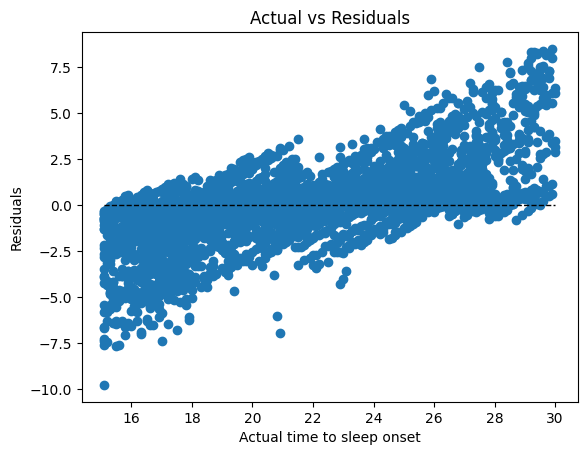

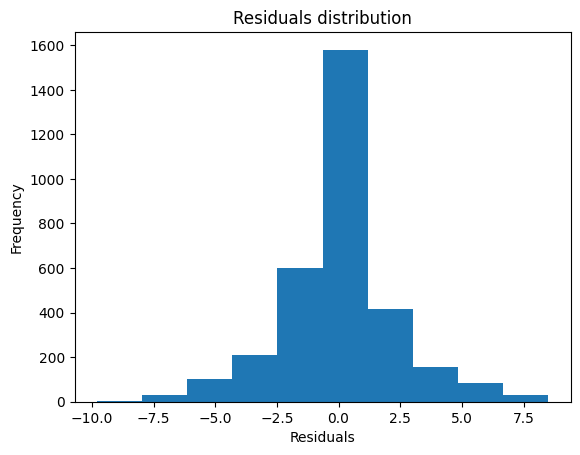

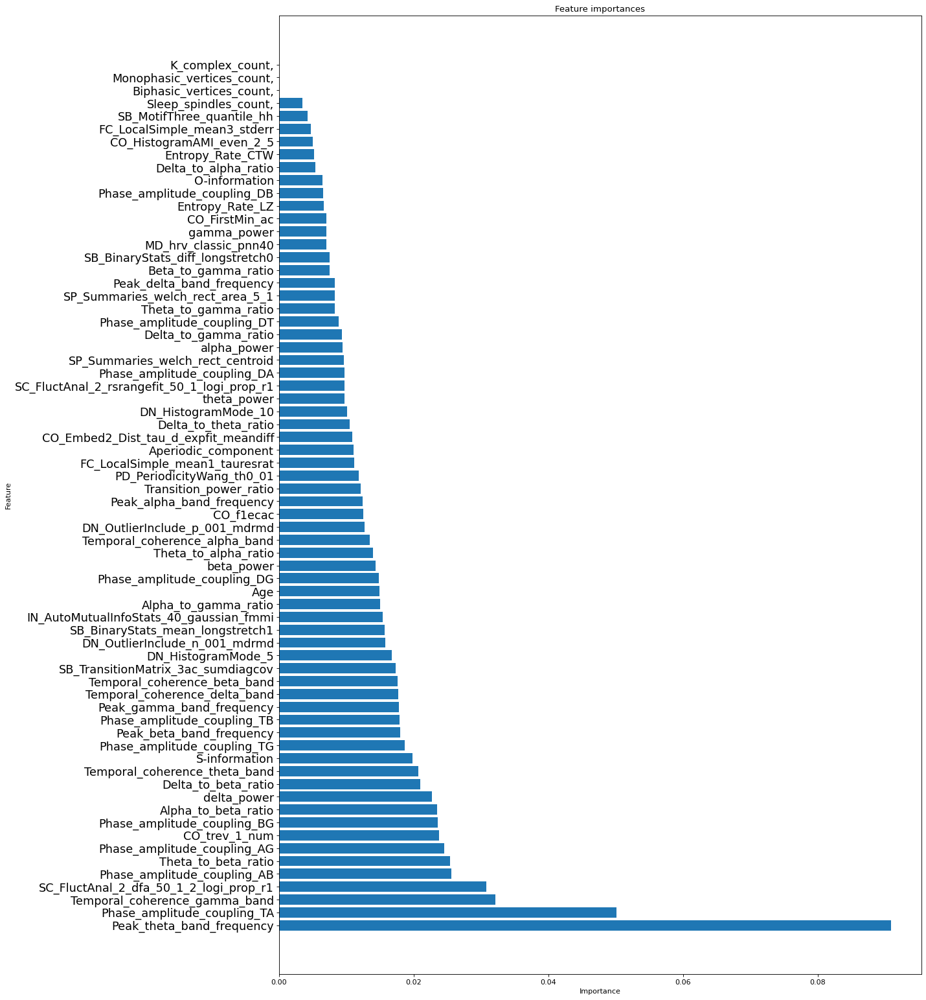

In [45]:
# Repeat the same for ifCleanOnset = 1 and Label > 15

mydata_clean_15_1 = mydata_clean[mydata_clean['Label'] > 15]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_clean_15_1 = mydata_clean_15_1.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)

y_clean_15_1 = mydata_clean_15_1['Label']

# Split the data into training and testing sets

X_train_clean_15_1, X_test_clean_15_1, y_train_clean_15_1, y_test_clean_15_1 = train_test_split(X_clean_15_1, y_clean_15_1, test_size=0.2)

# Create a random forest Regressor

rf_clean_15_1 = RandomForestRegressor(n_estimators=100)

# Perform cross-validation and get the predictions

predictions_clean_15_1 = cross_val_predict(rf_clean_15_1, X_train_clean_15_1, y_train_clean_15_1, cv=10)

# evaluate the predictions made during cross-validation

errors_clean_15_1, mape_clean_15_1, accuracy_clean_15_1, residuals_clean_15_1, mse_clean_15_1, rmse_clean_15_1, r2_clean_15_1 = evaluate_performance_train(rf_clean_15_1, X_train_clean_15_1, y_train_clean_15_1, predictions_clean_15_1)

# Plot the feature importances

rf_clean_15_1.fit(X_train_clean_15_1, y_train_clean_15_1)

importances_clean_15_1, indices_clean_15_1, names_clean_15_1 = plot_feature_importances(rf_clean_15_1, X_train_clean_15_1)



Mean Absolute Error: 1.43
Accuracy: 93.32 %.
Mean Squared Error: 4.44
Root Mean Squared Error: 2.11
R2: 0.73


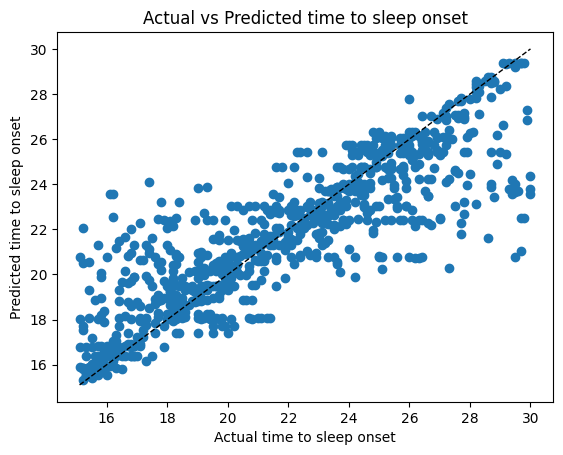

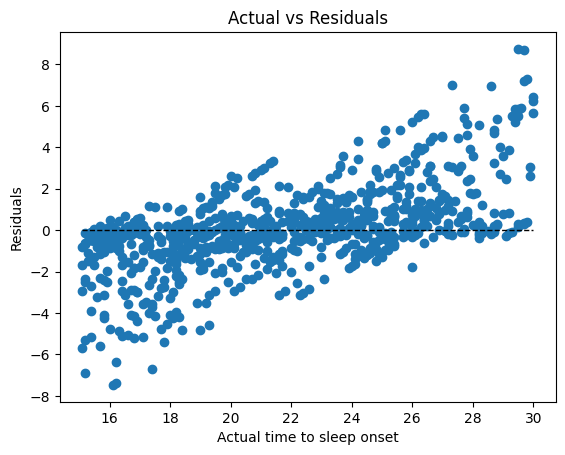

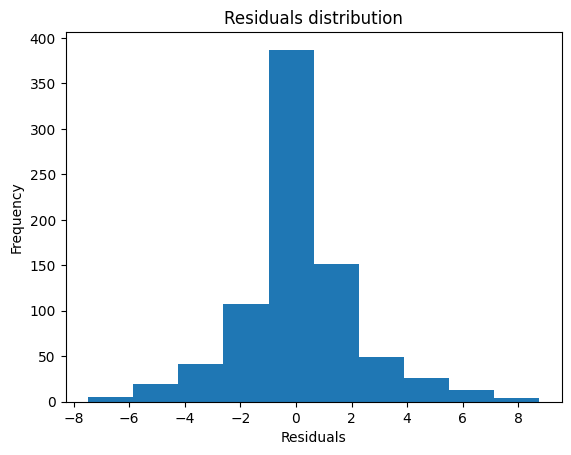

In [46]:
# Evaluate the performance of the model on the test data

predictions_clean_15_1, errors_clean_15_1, mape_clean_15_1, accuracy_clean_15_1, residuals_clean_15_1  = evaluate_performance_test(rf_clean_15_1, X_test_clean_15_1, y_test_clean_15_1)

## Random Forest: Performing analysis to predict test subjects from train subjects ##

In [40]:
# Identify how many unique subjects are in the dataset

mydata['Sbj_ID'].nunique()


42

In [41]:
# Identify how many unique subjects are in the dataset with clean onset

mydata_clean['Sbj_ID'].nunique()

35

In [22]:
import random
from sklearn.utils import shuffle

Mean Absolute Error: 6.8
Accuracy: -13.87 %.
Mean Squared Error: 73.21
Root Mean Squared Error: 8.56
R2: -0.04


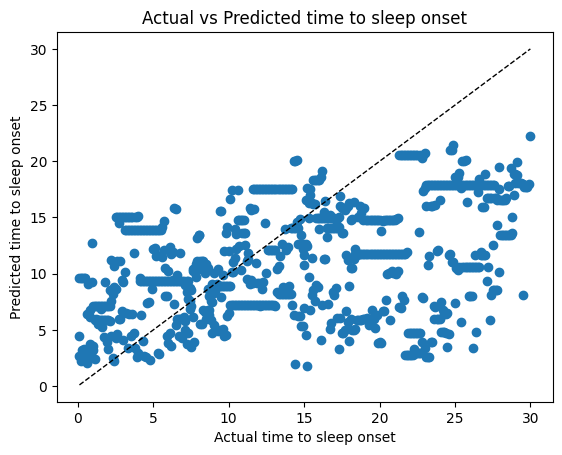

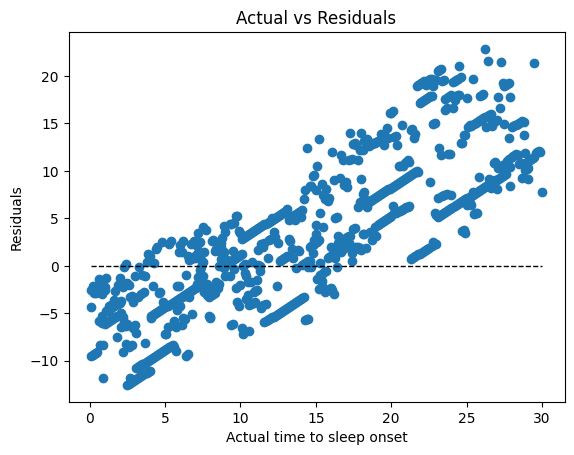

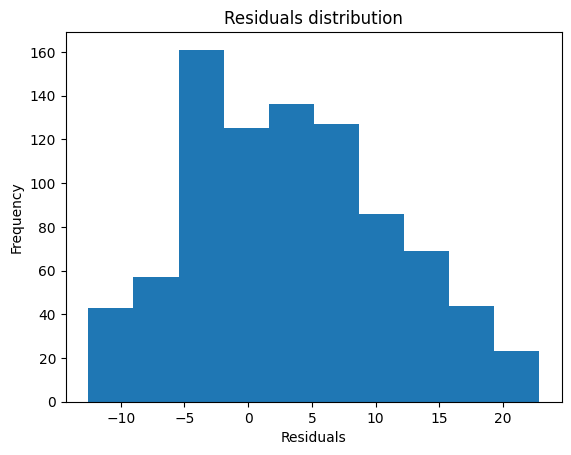

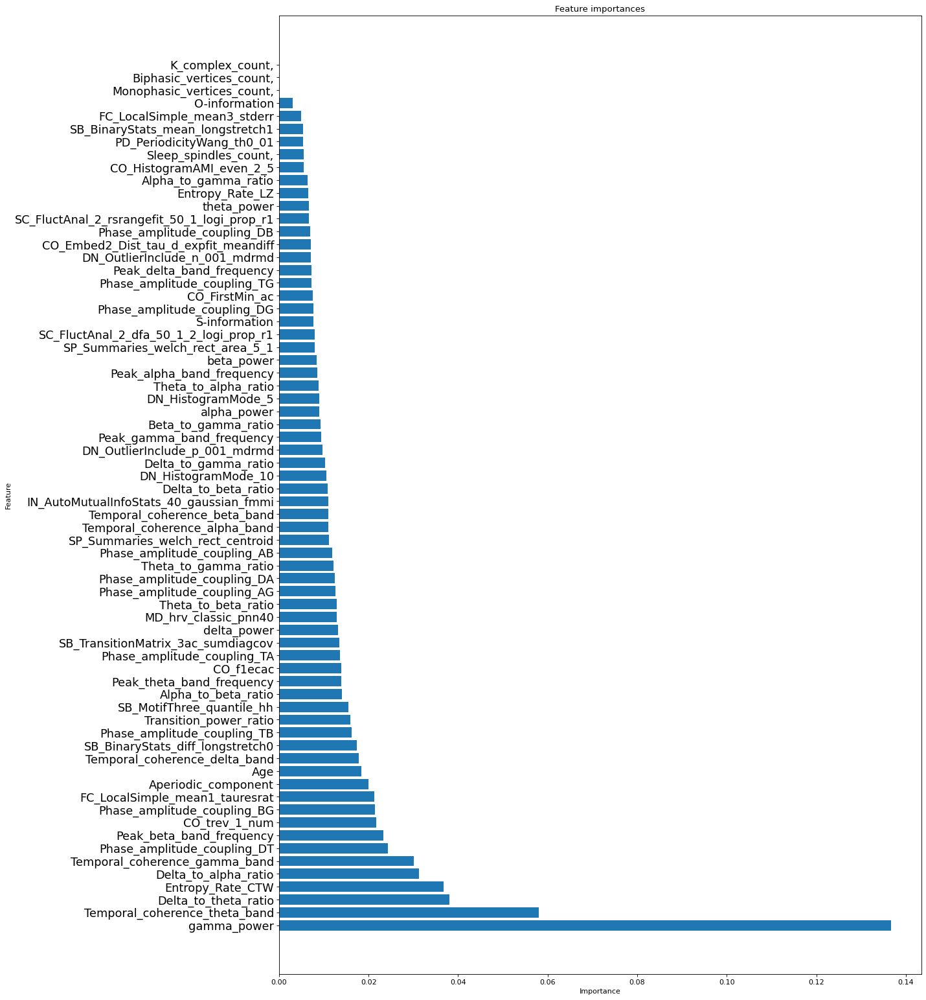

In [23]:
# choose 3 subjects to test the model and the rest to train it

# Create a list of the unique subjects

unique_subjects = mydata_clean['Sbj_ID'].unique()

# Shuffle the list of unique subjects

random.shuffle(unique_subjects)

# Choose 3 subjects to test the model

test_subjects = unique_subjects[0:3]

# Create a dataframe with the rest of the subjects to train the model

train_subjects = unique_subjects[3:]

# Create a dataframe with the test subjects

test_data = mydata_clean[mydata_clean['Sbj_ID'].isin(test_subjects)]

# Create a dataframe with the train subjects

train_data = mydata_clean[mydata_clean['Sbj_ID'].isin(train_subjects)]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_train = train_data.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)

y_train = train_data['Label']

X_test = test_data.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)

y_test = test_data['Label']

# Shuffle the data

#X_train, y_train = shuffle(X_train, y_train, random_state=0)

# Create a random forest Regressor

rf = RandomForestRegressor(n_estimators=200)

rf.fit(X_train, y_train)

# Predict the test data

predictions = rf.predict(X_test)

# evaluate the predictions made during cross-validation

errors, mape, accuracy, residuals, mse, rmse, r2 = evaluate_performance_train(rf, X_test, y_test, predictions)

# Plot the feature importances

importances, indices, names = plot_feature_importances(rf, X_train)






Mean Absolute Error: 3.48
Accuracy: -30.67 %.
Mean Squared Error: 16.22
Root Mean Squared Error: 4.03
R2: 0.13


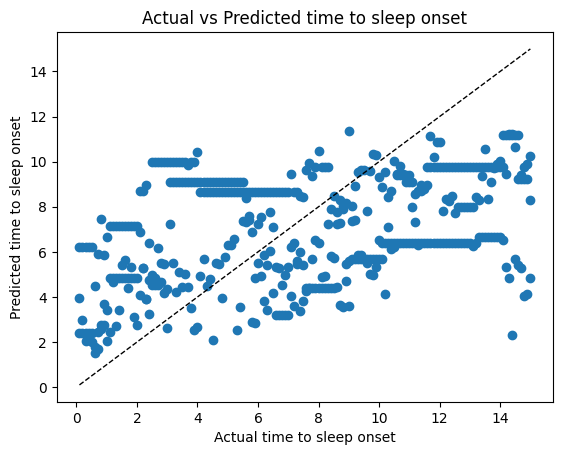

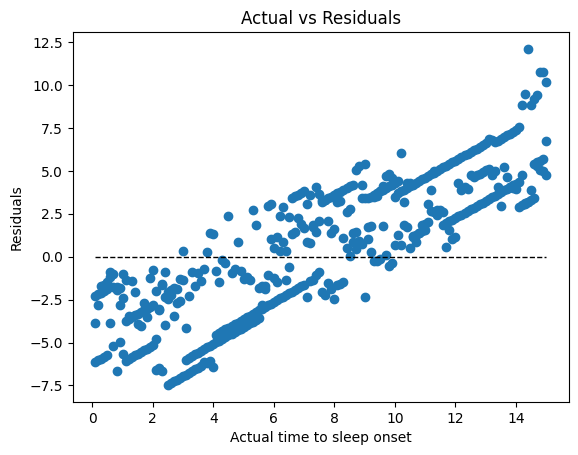

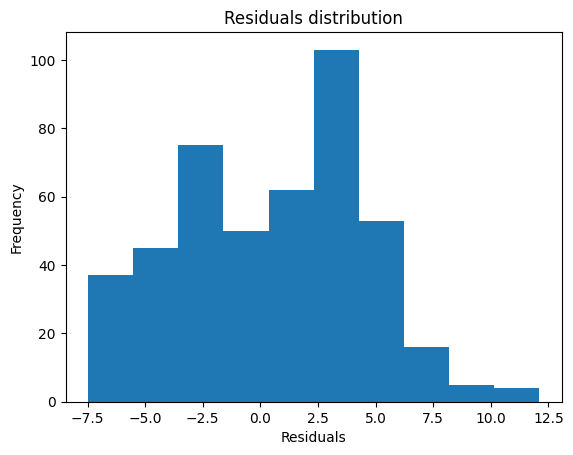

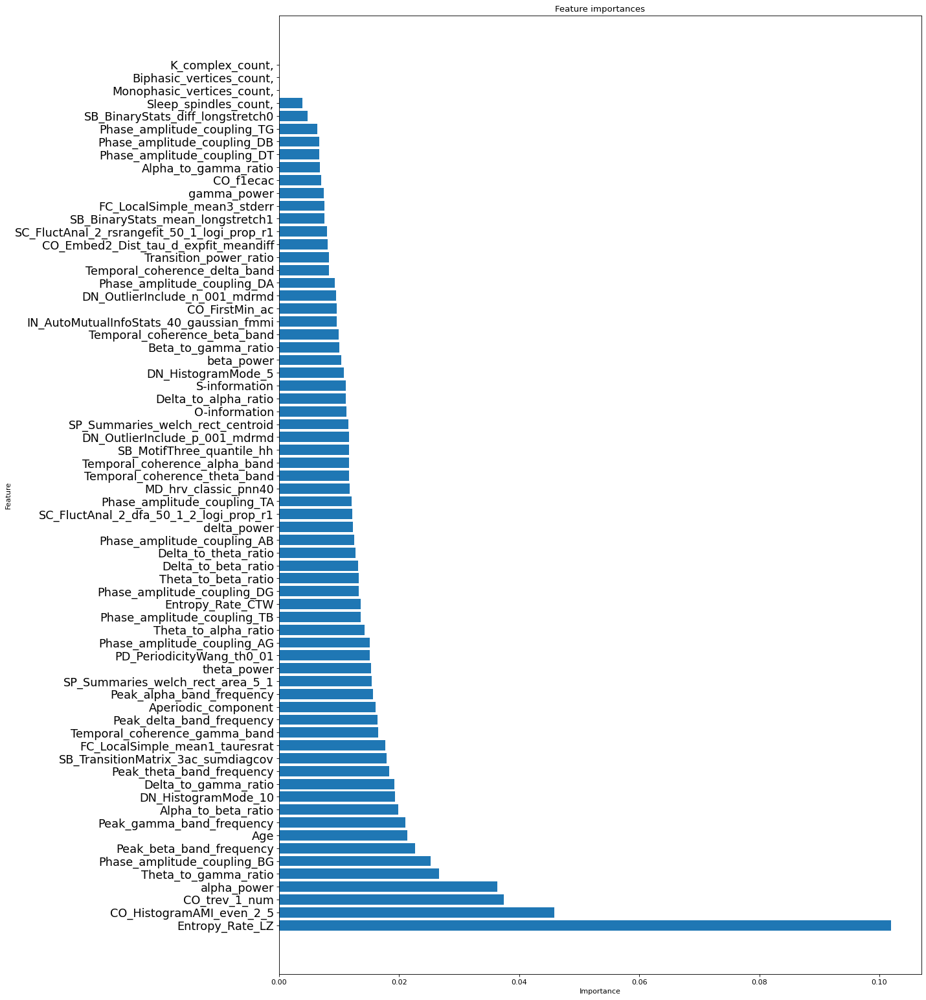

In [24]:
# Repeat the task on the clean data with no longer than 15 minutes before the onset (Label <=15)

# Create a dataframe with the test subjects

test_data_15 = mydata_clean_15[mydata_clean_15['Sbj_ID'].isin(test_subjects)]

# Create a dataframe with the train subjects

train_data_15 = mydata_clean_15[mydata_clean_15['Sbj_ID'].isin(train_subjects)]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_train_15 = train_data_15.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)

y_train_15 = train_data_15['Label']

X_test_15 = test_data_15.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)

y_test_15 = test_data_15['Label']

# Shuffle the data

#X_train_15, y_train_15 = shuffle(X_train_15, y_train_15, random_state=0)

# Create a random forest Regressor

rf_15 = RandomForestRegressor(n_estimators=150, )

rf_15.fit(X_train_15, y_train_15)

# Predict the test data

predictions_15 = rf_15.predict(X_test_15)

# evaluate the predictions made during cross-validation

errors_15, mape_15, accuracy_15, residuals_15, mse_15, rmse_15, r2_15 = evaluate_performance_train(rf_15, X_test_15, y_test_15, predictions_15)

# Plot the feature importances

importances_15, indices_15, names_15 = plot_feature_importances(rf_15, X_train_15)






Mean Absolute Error: 2.4
Accuracy: -8.68 %.
Mean Squared Error: 8.65
Root Mean Squared Error: 2.94
R2: -0.04


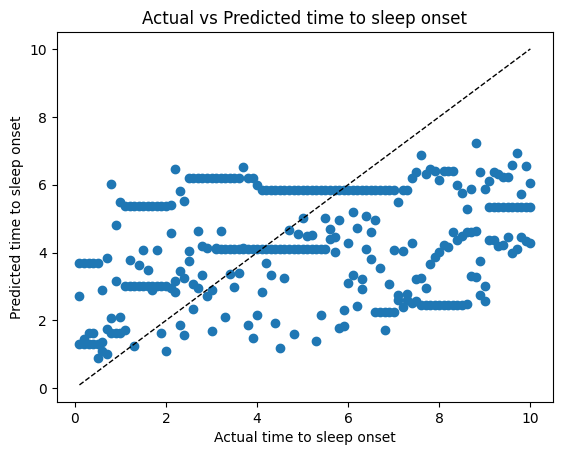

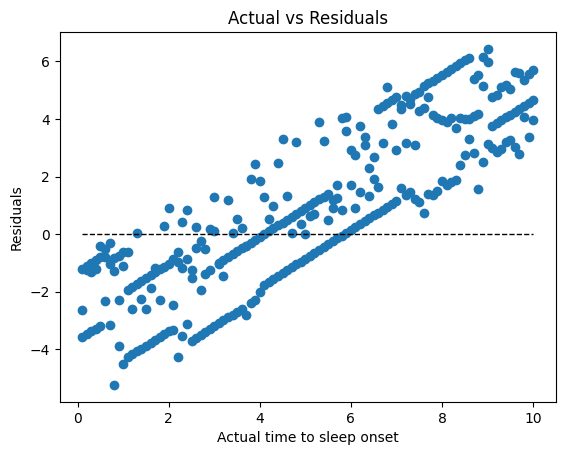

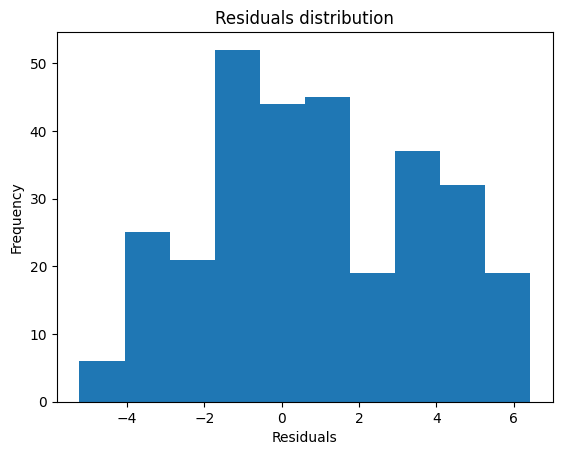

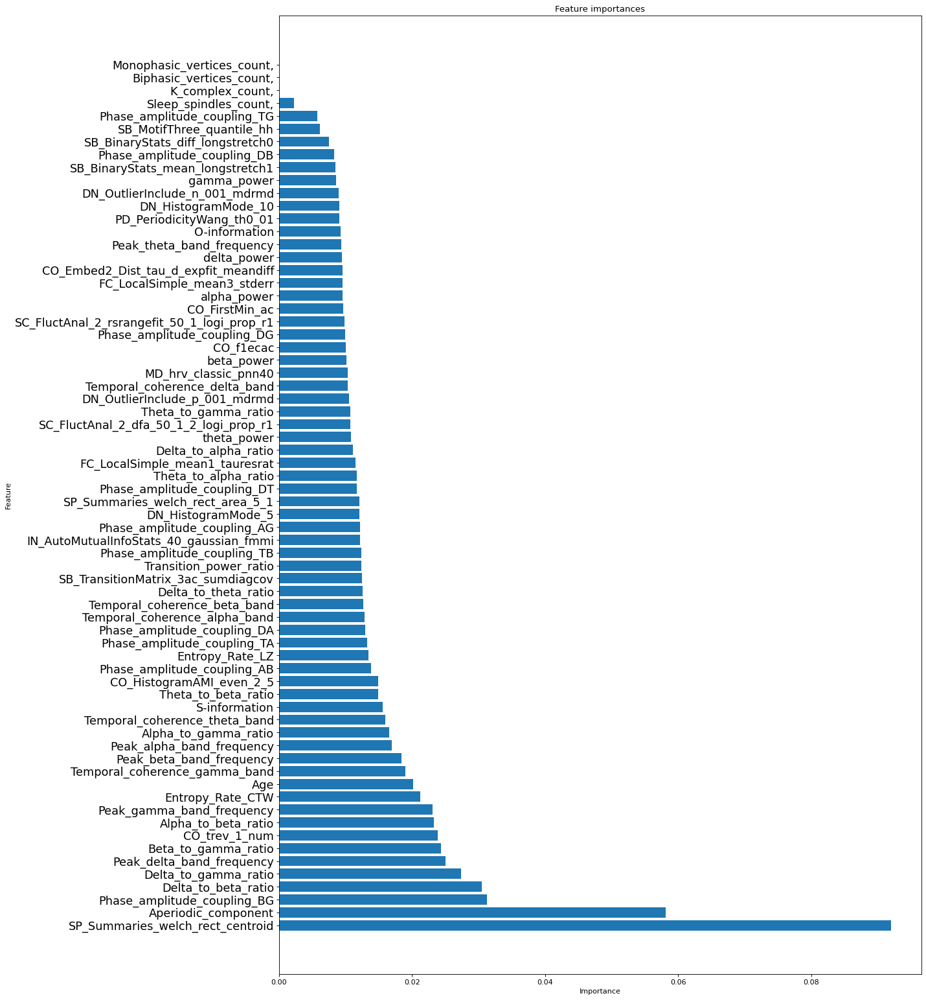

In [25]:
# Repeat the task on the clean data with no longer than 10 minutes before the onset (Label <=10)

# Create a dataframe with the test subjects


test_data_10 = mydata_clean_10[mydata_clean_10['Sbj_ID'].isin(test_subjects)]

# Create a dataframe with the train subjects

train_data_10 = mydata_clean_10[mydata_clean_10['Sbj_ID'].isin(train_subjects)]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)


X_train_10 = train_data_10.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)

y_train_10 = train_data_10['Label']

X_test_10 = test_data_10.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)

y_test_10 = test_data_10['Label']

# Shuffle the data

#X_train_10, y_train_10 = shuffle(X_train_10, y_train_10, random_state=0)

# Create a random forest Regressor

rf_10 = RandomForestRegressor(n_estimators=150)

rf_10.fit(X_train_10, y_train_10)

# Predict the test data

predictions_10 = rf_10.predict(X_test_10)

# evaluate the predictions made during cross-validation

errors_10, mape_10, accuracy_10, residuals_10, mse_10, rmse_10, r2_10 = evaluate_performance_train(rf_10, X_test_10, y_test_10, predictions_10)

# Plot the feature importances

importances_10, indices_10, names_10 = plot_feature_importances(rf_10, X_train_10)



# Try scaling the data


In [321]:
# Create a dataframe with the test subjects from mydata
# drop nan and inf values

mydata = mydata.dropna()

test_data_mydata = mydata[mydata['Sbj_ID'].isin(test_subjects)]

# Create a dataframe with the train subjects from mydata

train_data_mydata = mydata[mydata['Sbj_ID'].isin(train_subjects)]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_train_mydata = train_data_mydata.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)

y_train_mydata = train_data_mydata['Label']

X_test_mydata = test_data_mydata.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)

y_test_mydata = test_data_mydata['Label']

# Shuffle the data

X_train_mydata, y_train_mydata = shuffle(X_train_mydata, y_train_mydata, random_state=0)




Mean Absolute Error: 2.42
Accuracy: 16.69 %.
Mean Squared Error: 15.17
Root Mean Squared Error: 3.89
R2: 0.78


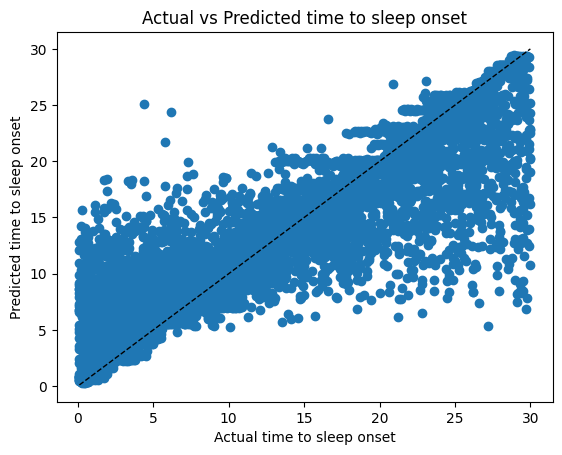

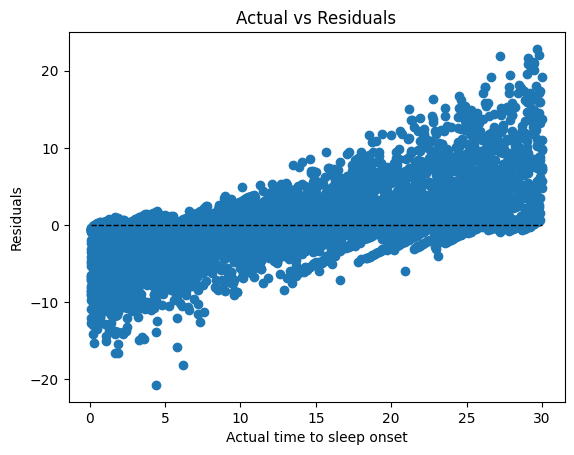

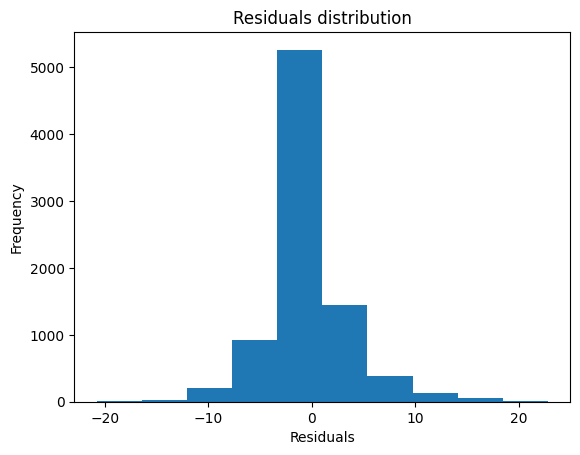

NotFittedError: This RandomForestRegressor instance is not fitted yet. Call 'fit' with appropriate arguments before using this estimator.

In [323]:
# perfrom min-max scaling on the data

from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()



X_train_scaled = scaler.fit_transform(X_train_mydata)

X_test_scaled = scaler.transform(X_test_mydata)

# Create a random forest Regressor

rf_scaled = RandomForestRegressor(n_estimators=150)

# Cross-validate the model

predictions_scaled = cross_val_predict(rf_scaled, X_train_scaled, y_train_mydata, cv=10)

# evaluate the predictions made during cross-validation

errors_scaled, mape_scaled, accuracy_scaled, residuals_scaled, mse_scaled, rmse_scaled, r2_scaled = evaluate_performance_train(rf_scaled, X_train_scaled, y_train_mydata, predictions_scaled)




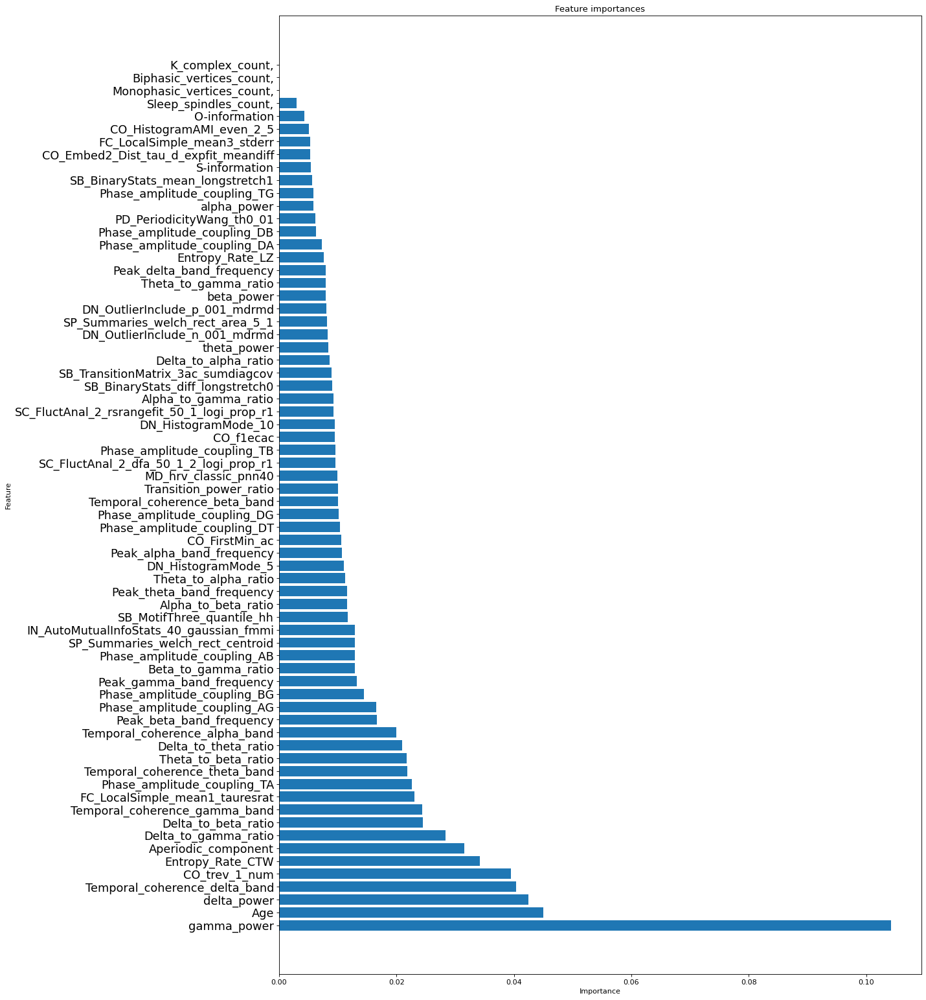

Mean Absolute Error: 6.17
Accuracy: -70.78 %.
Mean Squared Error: 59.07
Root Mean Squared Error: 7.69
R2: 0.16


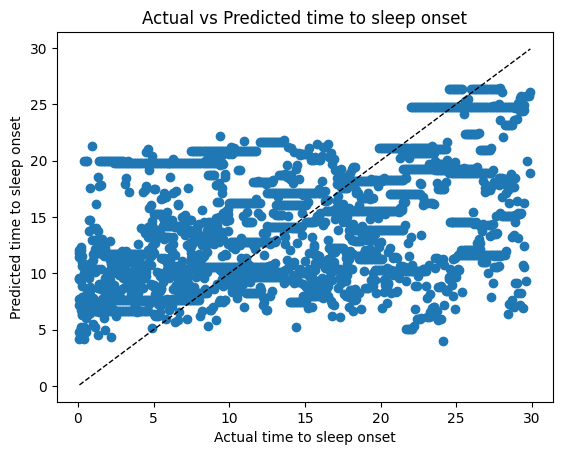

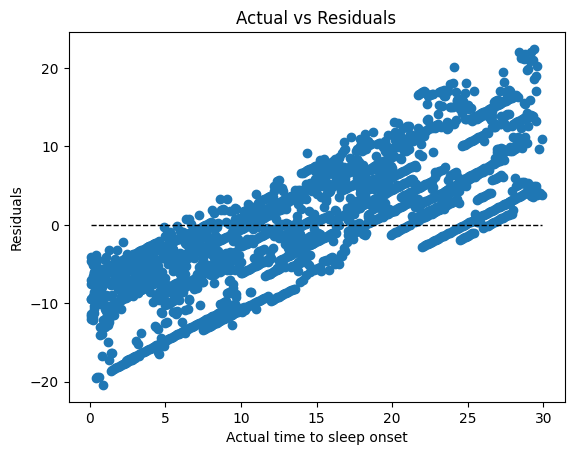

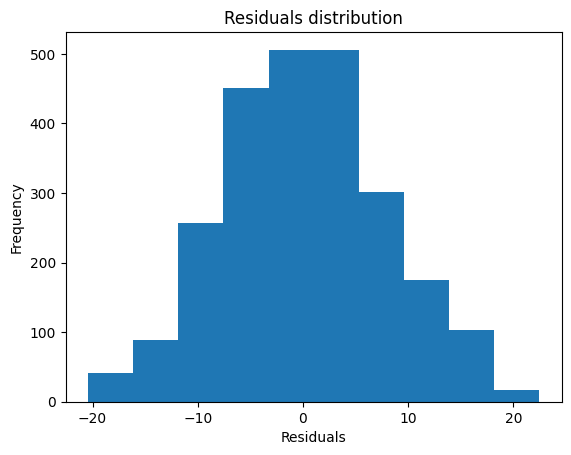

In [325]:

# Plot the feature importances

importances_scaled, indices_scaled, names_scaled = plot_feature_importances(rf_scaled, X_train)

# evaluate the predictions made during test
errors_scaled, mape_scaled, accuracy_scaled, residuals_scaled, predictions_scaled = evaluate_performance_test(rf_scaled, X_test_scaled, y_test_mydata)

# Random Forest Classification: Performing analysis to predict test subjects from train subjects

In [227]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

In [245]:
# take mydata and copy into  a new dataframe. in the new dataframe, switch the labels to 5 minute bins (classes '5 minutes before onset, 10 minutes before onset, 15 minutes before onset')
# and then run the model on the new dataframe

# create a new dataframe

mydata_5 = mydata.copy()

# delete rows with NaN values

mydata_5 = mydata_5.dropna()

# create a new column with the new labels

mydata_5['Label_5'] = mydata_5['Label'].apply(lambda x: 5 if x <= 5 else (10 if x <= 10 else (15 if x <= 15 else (20 if x <=20 else 25))))

# Perform a classification task on the new dataframe

# Create a dataframe with the test subjects

test_data_5 = mydata_5[mydata_5['Sbj_ID'].isin(test_subjects)]

# Create a dataframe with the train subjects

train_data_5 = mydata_5[mydata_5['Sbj_ID'].isin(train_subjects)]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_train_5 = train_data_5.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset', 'Label_5'], axis=1)

y_train_5 = train_data_5['Label_5']

X_test_5 = test_data_5.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset', 'Label_5'], axis=1)

y_test_5 = test_data_5['Label_5']

# Shuffle the data

#X_train_5, y_train_5 = shuffle(X_train_5, y_train_5, random_state=0)

# Create a random forest classfier and do cross-validation

rf_5 = RandomForestClassifier(n_estimators=150)

predictions_cv = cross_val_predict(rf_5, X_train_5, y_train_5, cv=10)



Accuracy: 0.3460979156568105


Text(0.5, 23.52222222222222, 'Predicted label')

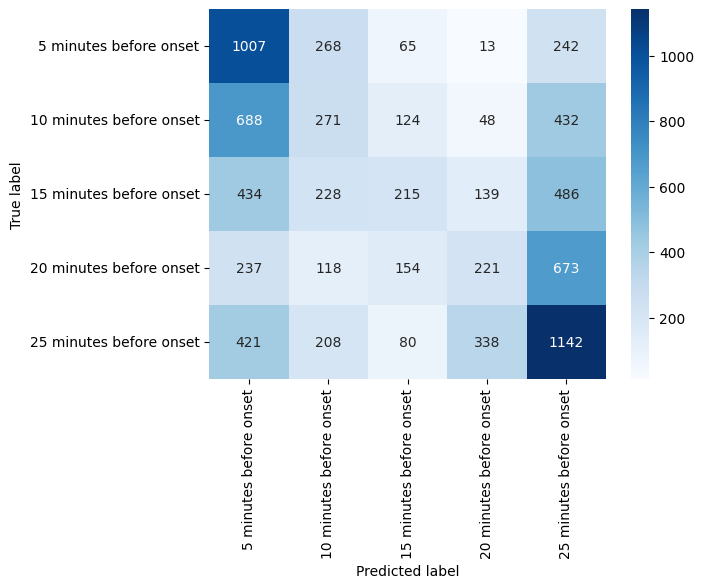

In [248]:
# evaluate the perfromance of the model

accuracy = accuracy_score(y_train_5, predictions_cv)
print(f'Accuracy: {accuracy}')

# plot the confusion matrix

# include the names of the classes in the confusion matrix
cm = confusion_matrix(y_train_5, predictions_cv)
cm_df = pd.DataFrame(cm,
                        index = ['5 minutes before onset', '10 minutes before onset', '15 minutes before onset', '20 minutes before onset', '25 minutes before onset'],
                        columns = ['5 minutes before onset', '10 minutes before onset', '15 minutes before onset', '20 minutes before onset', '25 minutes before onset'])
sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')
plt.ylabel('True label')
plt.xlabel('Predicted label')







In [249]:
# plot the classification report

class_report = classification_report(y_train_5, predictions_cv)
print(class_report)




              precision    recall  f1-score   support

           5       0.36      0.63      0.46      1595
          10       0.25      0.17      0.20      1563
          15       0.34      0.14      0.20      1502
          20       0.29      0.16      0.20      1403
          25       0.38      0.52      0.44      2189

    accuracy                           0.35      8252
   macro avg       0.32      0.33      0.30      8252
weighted avg       0.33      0.35      0.32      8252



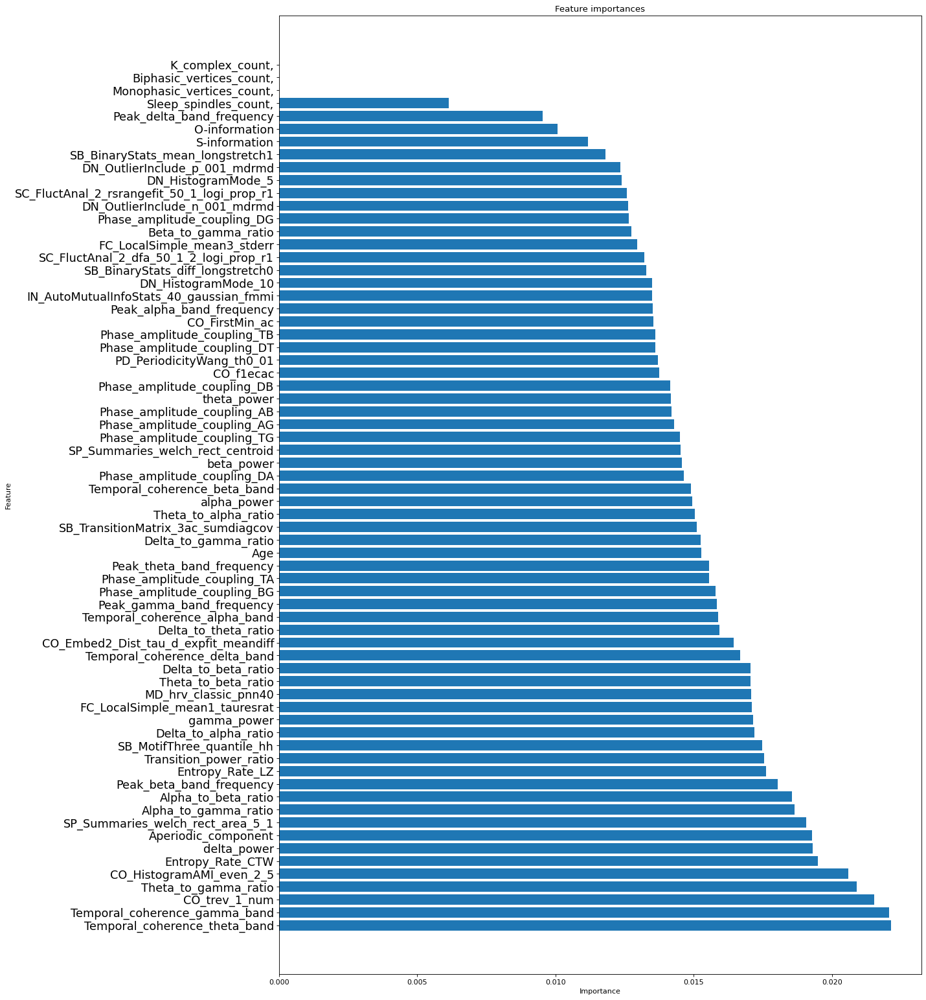

In [250]:
# Plot the feature importances
rf_5.fit(X_train_5, y_train_5)
importances_cv, indices_cv, names_cv = plot_feature_importances(rf_5, X_train_5)

In [251]:

# Predict the test data

predictions_5 = rf_5.predict(X_test_5)

# evaluate the predictions made during test 

accuracy_5 = accuracy_score(y_test_5, predictions_5)
print(f'Accuracy: {accuracy_5}')




Accuracy: 0.3237657864523536


In [253]:
# plot the confusion matrix

print(classification_report(y_test_5, predictions_5))

              precision    recall  f1-score   support

           5       0.22      0.56      0.32       150
          10       0.28      0.29      0.28       150
          15       0.30      0.19      0.23       150
          20       0.32      0.07      0.12       150
          25       0.56      0.42      0.48       271

    accuracy                           0.32       871
   macro avg       0.34      0.31      0.29       871
weighted avg       0.37      0.32      0.31       871



Text(0.5, 23.52222222222222, 'Predicted label')

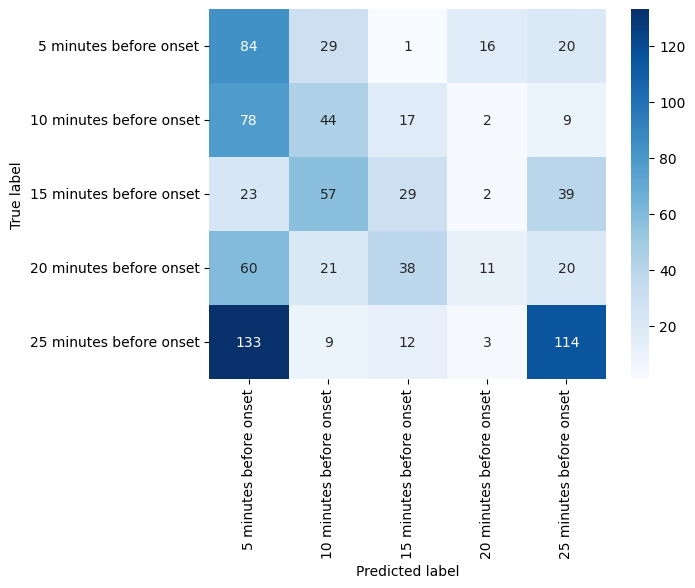

In [254]:
import seaborn as sns
import matplotlib.pyplot as plt

# include the names of the classes in the confusion matrix
cm = confusion_matrix(y_test_5, predictions_5)
cm_df = pd.DataFrame(cm,
                        index = ['5 minutes before onset', '10 minutes before onset', '15 minutes before onset', '20 minutes before onset', '25 minutes before onset'],
                        columns = ['5 minutes before onset', '10 minutes before onset', '15 minutes before onset', '20 minutes before onset', '25 minutes before onset'])
sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')
plt.ylabel('True label')
plt.xlabel('Predicted label')



In [255]:
# Create a new dataframe with the labels 10 minutes before onset and 20 minutes before onset and 30 minutes before onset

mydata_10 = mydata.copy()

# delete rows with NaN values

mydata_10 = mydata_10.dropna()

# create a new column with the new labels

mydata_10['Label_10'] = mydata_10['Label'].apply(lambda x: 10 if x <= 10 else (20 if x <= 20 else 30))

# Perform a classification task on the new dataframe

# Create a dataframe with the test subjects

test_data_10 = mydata_10[mydata_10['Sbj_ID'].isin(test_subjects)]

# Create a dataframe with the train subjects

train_data_10 = mydata_10[mydata_10['Sbj_ID'].isin(train_subjects)]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_train_10 = train_data_10.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset', 'Label_10'], axis=1)

y_train_10 = train_data_10['Label_10']

X_test_10 = test_data_10.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset', 'Label_10'], axis=1)

y_test_10 = test_data_10['Label_10']

# Shuffle the data

X_train_10, y_train_10 = shuffle(X_train_10, y_train_10, random_state=0)

# Create a random forest classfier and do cross-validation

rf_10 = RandomForestClassifier(n_estimators=150)

predictions_cv = cross_val_predict(rf_10, X_train_10, y_train_10, cv=10)




Accuracy: 0.8750605913717887


Text(0.5, 23.52222222222222, 'Predicted label')

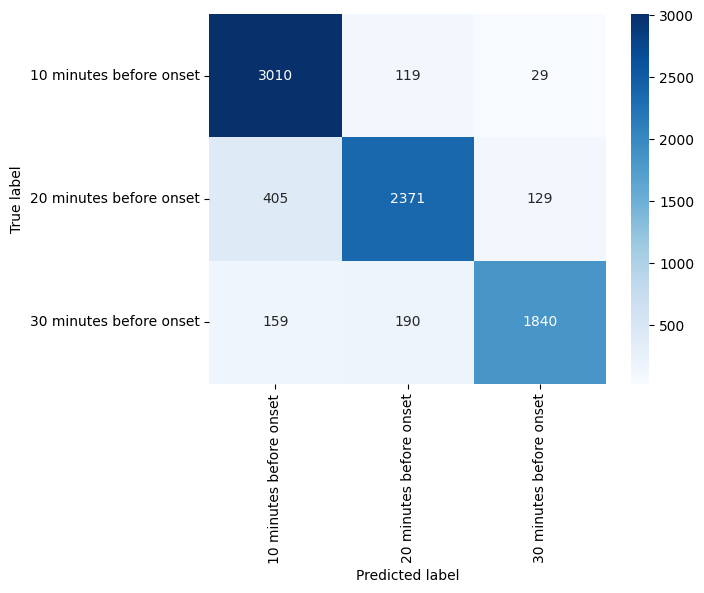

In [256]:
# evaluate the perfromance of the model

accuracy = accuracy_score(y_train_10, predictions_cv)

print(f'Accuracy: {accuracy}')

# plot the confusion matrix

# include the names of the classes in the confusion matrix
cm = confusion_matrix(y_train_10, predictions_cv)
cm_df = pd.DataFrame(cm,
                        index = ['10 minutes before onset', '20 minutes before onset', '30 minutes before onset'],
                        columns = ['10 minutes before onset', '20 minutes before onset', '30 minutes before onset'])
sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')
plt.ylabel('True label')
plt.xlabel('Predicted label')




Accuracy: 0.5384615384615384
              precision    recall  f1-score   support

          10       0.46      0.88      0.60       300
          20       0.61      0.41      0.49       300
          30       0.88      0.30      0.45       271

    accuracy                           0.54       871
   macro avg       0.65      0.53      0.51       871
weighted avg       0.64      0.54      0.52       871



Text(0.5, 23.52222222222222, 'Predicted label')

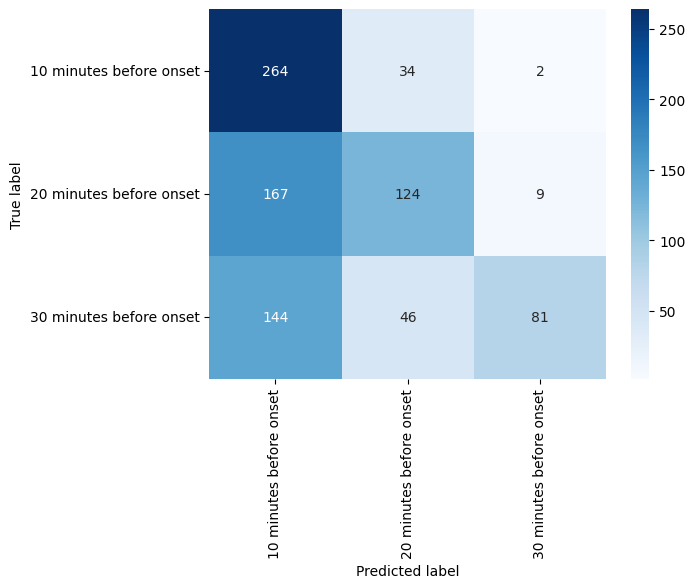

In [258]:
# try it with the test data 
rf_10.fit(X_train_10, y_train_10)
predictions_10 = rf_10.predict(X_test_10)

# evaluate the predictions made during test

accuracy_10 = accuracy_score(y_test_10, predictions_10)

print(f'Accuracy: {accuracy_10}')

# plot the confusion matrix

print(classification_report(y_test_10, predictions_10))

import seaborn as sns
import matplotlib.pyplot as plt

# include the names of the classes in the confusion matrix

cm = confusion_matrix(y_test_10, predictions_10)
cm_df = pd.DataFrame(cm,
                        index = ['10 minutes before onset', '20 minutes before onset', '30 minutes before onset'],
                        columns = ['10 minutes before onset', '20 minutes before onset', '30 minutes before onset'])
sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')
plt.ylabel('True label')
plt.xlabel('Predicted label')



In [298]:
# get train and test subjects from sbj_ID column in mydata(uniques)


participants = mydata['Sbj_ID'].unique()

# randomly select 80% of the participants for training and 20% for testing

train_subjects = np.random.choice(participants, int(len(participants)*0.8), replace=False)

test_subjects = [x for x in participants if x not in train_subjects]







In [299]:
train_subjects, test_subjects 

(array([ 77,  35, 284, 416, 664, 159, 823, 914, 821, 632, 962, 782, 838,
        812, 755, 943, 491, 967,   2, 519,  56, 949, 581, 596, 382, 884,
        726, 586, 800, 419, 384, 458, 912]),
 [288, 344, 460, 490, 518, 762, 854, 893, 933])

In [300]:
# Try to perfrom min-max scaling on the data per subject 

# Create a new dataframe with the labels 10 minutes before onset and 20 minutes before onset and 30 minutes before onset

mydata_10 = mydata.copy()

# delete rows with NaN values

mydata_10 = mydata_10.dropna()

# create a new column with the new labels

mydata_10['Label'] = mydata_10['Label'].apply(lambda x: 10 if x <= 10 else (20 if x <= 20 else 30))

# exclude biphasic_vertices_count and k_complex_count columns

mydata_10 = mydata_10.drop(['Biphasic_vertices_count,', 'K_complex_count,', 'Monophasic_vertices_count,'], axis=1)

# perform min-max scaling only of the features and not the labels, SleepStage, Sbj_ID and ifCleanOnset, age columns

mydata_10[mydata_10.columns[5:]] = mydata_10[mydata_10.columns[5:]].apply(lambda x: (x - x.min()) / (x.max() - x.min()))


# find nan values

mydata_10.isnull().sum()



Label                    0
Sbj_ID                   0
Age                      0
ifCleanOnset             0
SleepStage               0
                        ..
Entropy_Rate_LZ          0
Aperiodic_component      0
Sleep_spindles_count,    0
O-information            0
S-information            0
Length: 69, dtype: int64

In [301]:
# Perform a classification task on the new dataframe

# Create a dataframe with the test subjects

test_data_10 = mydata_10[mydata_10['Sbj_ID'].isin(test_subjects)]

# Create a dataframe with the train subjects

train_data_10 = mydata_10[mydata_10['Sbj_ID'].isin(train_subjects)]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_train_10 = train_data_10.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset', 'Label'], axis=1)

y_train_10 = train_data_10['Label']

X_test_10 = test_data_10.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset', 'Label'], axis=1)

y_test_10 = test_data_10['Label']

# Shuffle the data

X_train_10, y_train_10 = shuffle(X_train_10, y_train_10, random_state=0)

# Create a random forest classfier and do cross-validation

rf_10 = RandomForestClassifier(n_estimators=150)

predictions_cv = cross_val_predict(rf_10, X_train_10, y_train_10, cv=10)

Accuracy: 0.8668240850059031


Text(0.5, 23.52222222222222, 'Predicted label')

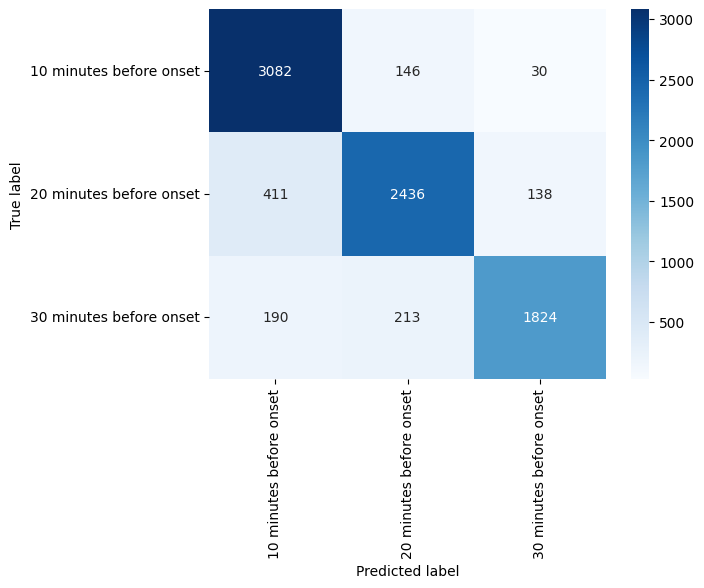

In [302]:
# evaluate the perfromance of the model

accuracy = accuracy_score(y_train_10, predictions_cv)

print(f'Accuracy: {accuracy}')

# plot the confusion matrix

# include the names of the classes in the confusion matrix
cm = confusion_matrix(y_train_10, predictions_cv)

cm_df = pd.DataFrame(cm,
                        index = ['10 minutes before onset', '20 minutes before onset', '30 minutes before onset'],
                        columns = ['10 minutes before onset', '20 minutes before onset', '30 minutes before onset'])
sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')

plt.ylabel('True label')
plt.xlabel('Predicted label')



Accuracy: 0.5024529844644318
              precision    recall  f1-score   support

          10       0.52      0.77      0.62       899
          20       0.45      0.35      0.40       827
          30       0.53      0.34      0.41       720

    accuracy                           0.50      2446
   macro avg       0.50      0.49      0.48      2446
weighted avg       0.50      0.50      0.48      2446



Text(0.5, 23.52222222222222, 'Predicted label')

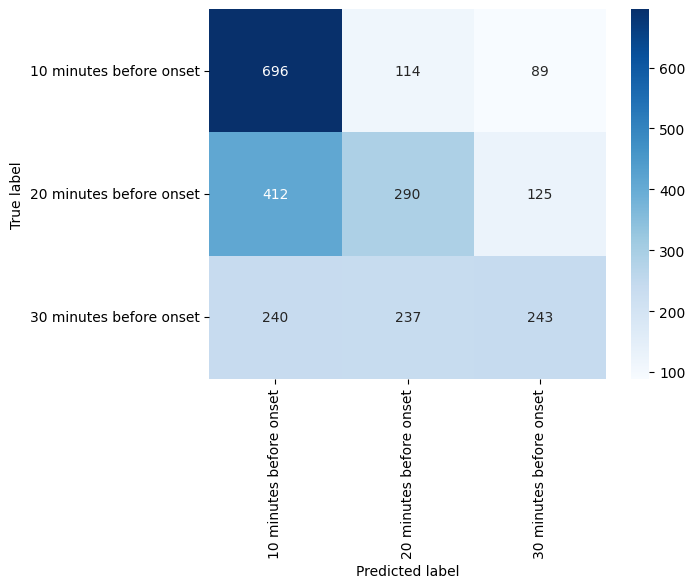

In [304]:
# try it with the test data

rf_10.fit(X_train_10, y_train_10)
predictions_10 = rf_10.predict(X_test_10)

# evaluate the predictions made during test

accuracy_10 = accuracy_score(y_test_10, predictions_10)
print(f'Accuracy: {accuracy_10}')

# plot the confusion matrix

print(classification_report(y_test_10, predictions_10))

import seaborn as sns
import matplotlib.pyplot as plt

# include the names of the classes in the confusion matrix

cm = confusion_matrix(y_test_10, predictions_10)
cm_df = pd.DataFrame(cm,
                        index = ['10 minutes before onset', '20 minutes before onset', '30 minutes before onset'],
                        columns = ['10 minutes before onset', '20 minutes before onset', '30 minutes before onset'])
sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')
plt.ylabel('True label')
plt.xlabel('Predicted label')



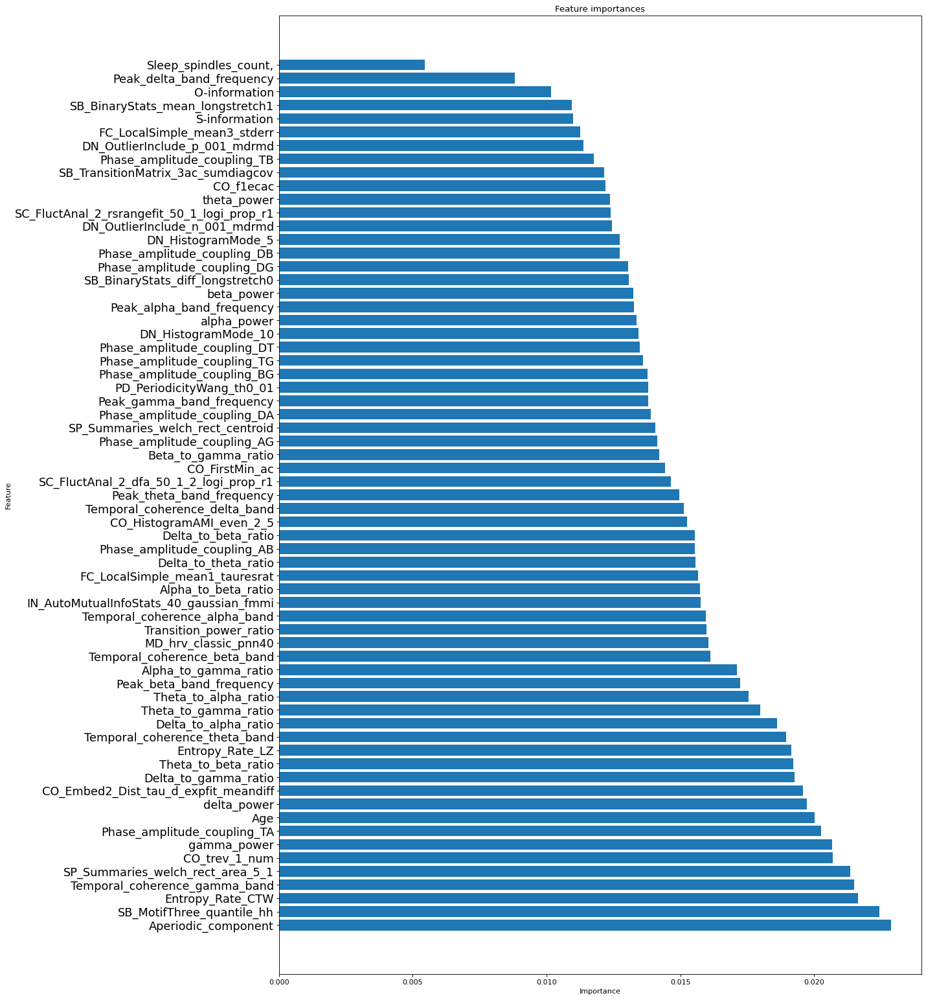

In [305]:
# plot the feature importance

importances_cv, indices_cv, names_cv = plot_feature_importances(rf_10, X_train_10)


Accuracy: 0.9195985832349469


Text(0.5, 23.52222222222222, 'Predicted label')

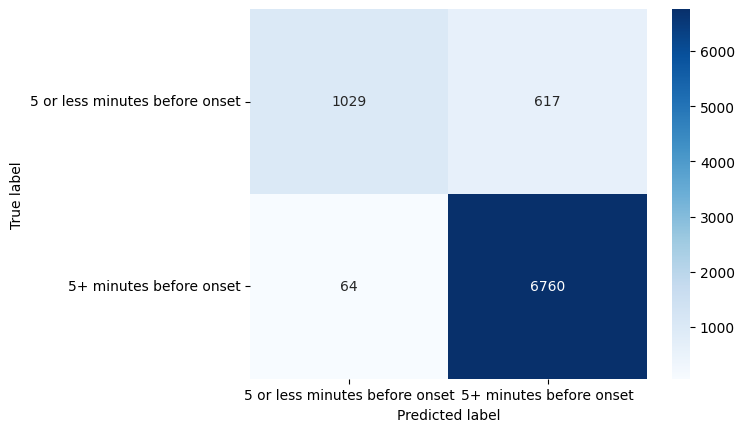

In [314]:
# Build  new dataset with less than 5 minutes before onset and more than 5 minutes before onset

# Create a new dataframe with the labels less than 5 minutes before onset and more than 5 minutes before onset

mydata_5 = mydata.copy()

# delete rows with NaN values

mydata_5 = mydata_5.dropna()

# create a new column with the new labels

mydata_5['Label'] = mydata_5['Label'].apply(lambda x: 5 if x <= 5 else 30)

# exclude biphasic_vertices_count and k_complex_count columns

mydata_5 = mydata_5.drop(['Biphasic_vertices_count,', 'K_complex_count,', 'Monophasic_vertices_count,'], axis=1)

# perform min-max scaling only of the features and not the labels, SleepStage, Sbj_ID and ifCleanOnset, age columns

mydata_5[mydata_5.columns[5:]] = mydata_5[mydata_5.columns[5:]].apply(lambda x: (x - x.min()) / (x.max() - x.min()))



# Perform a classification task on the new dataframe

# Create a dataframe with the test subjects

test_data_5 = mydata_5[mydata_5['Sbj_ID'].isin(test_subjects)]

# Create a dataframe with the train subjects

train_data_5 = mydata_5[mydata_5['Sbj_ID'].isin(train_subjects)]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_train_5 = train_data_5.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset', 'Label'], axis=1)

y_train_5 = train_data_5['Label']

X_test_5 = test_data_5.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset', 'Label'], axis=1)

y_test_5 = test_data_5['Label']

# Shuffle the data

X_train_5, y_train_5 = shuffle(X_train_5, y_train_5, random_state=0)

# Create a random forest classfier and do cross-validation

rf_5 = RandomForestClassifier(n_estimators=150)

predictions_cv = cross_val_predict(rf_5, X_train_5, y_train_5, cv=10)

# evaluate the perfromance of the model

accuracy = accuracy_score(y_train_5, predictions_cv)

print(f'Accuracy: {accuracy}')

# plot the confusion matrix

# include the names of the classes in the confusion matrix

cm = confusion_matrix(y_train_5, predictions_cv)

cm_df = pd.DataFrame(cm,
                        index = ['5 or less minutes before onset', '5+ minutes before onset'],
                        columns = ['5 or less minutes before onset', '5+ minutes before onset'])
sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')

plt.ylabel('True label')
plt.xlabel('Predicted label')





In [315]:
# classification report

print(classification_report(y_train_5, predictions_cv))



              precision    recall  f1-score   support

           5       0.94      0.63      0.75      1646
          30       0.92      0.99      0.95      6824

    accuracy                           0.92      8470
   macro avg       0.93      0.81      0.85      8470
weighted avg       0.92      0.92      0.91      8470



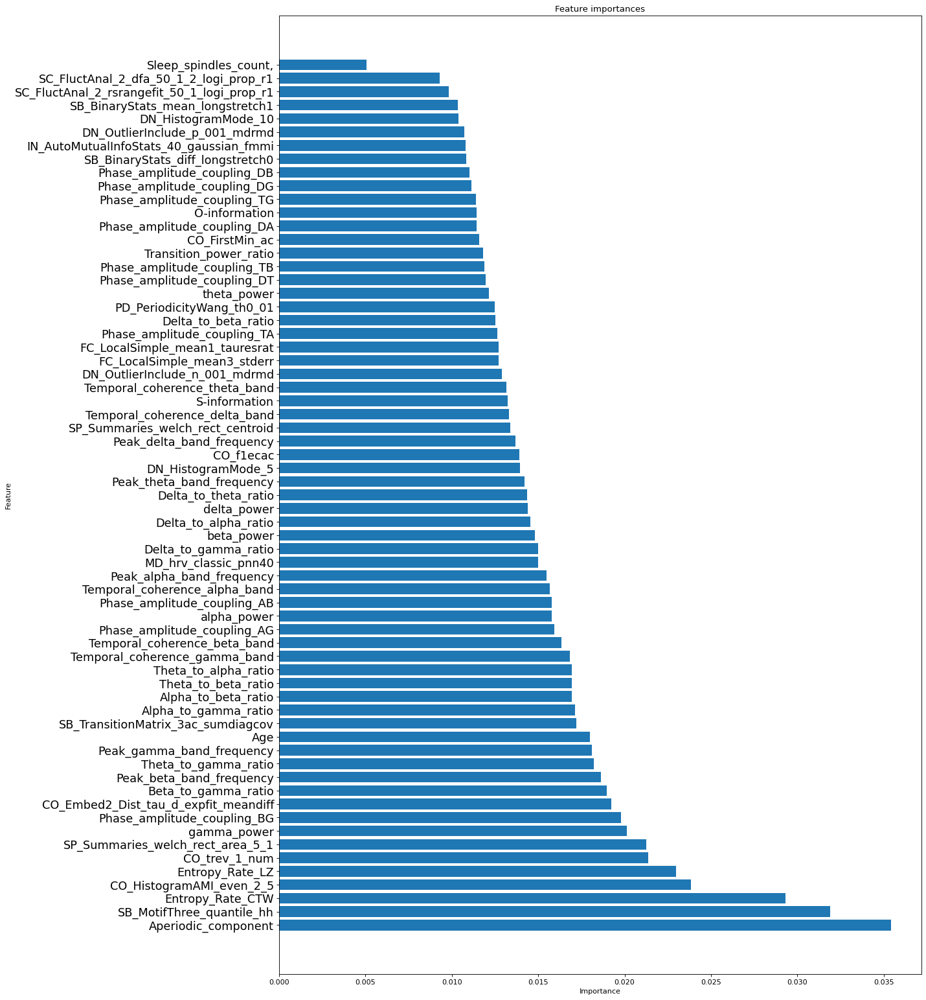

In [316]:
# fit the model with the train data

rf_5.fit(X_train_5, y_train_5)

# plot the feature importance
importances_cv, indices_cv, names_cv = plot_feature_importances(rf_5, X_train_5)





Accuracy: 0.7964022894521668
              precision    recall  f1-score   support

           5       0.42      0.27      0.33       449
          30       0.85      0.91      0.88      1997

    accuracy                           0.80      2446
   macro avg       0.63      0.59      0.60      2446
weighted avg       0.77      0.80      0.78      2446

              precision    recall  f1-score   support

           5       0.42      0.27      0.33       449
          30       0.85      0.91      0.88      1997

    accuracy                           0.80      2446
   macro avg       0.63      0.59      0.60      2446
weighted avg       0.77      0.80      0.78      2446



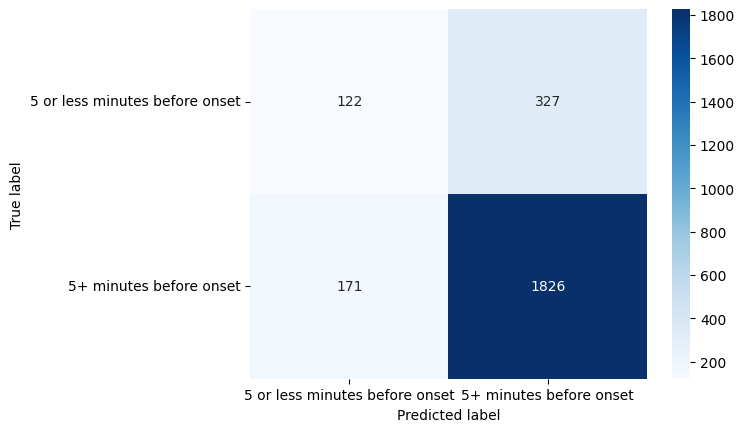

In [317]:
# predict the test data

predictions_5 = rf_5.predict(X_test_5)

# evaluate the predictions made during test

accuracy_5 = accuracy_score(y_test_5, predictions_5)
print(f'Accuracy: {accuracy_5}')

# plot the confusion matrix

print(classification_report(y_test_5, predictions_5))

import seaborn as sns
import matplotlib.pyplot as plt

# include the names of the classes in the confusion matrix

cm = confusion_matrix(y_test_5, predictions_5)

cm_df = pd.DataFrame(cm,
                        index = ['5 or less minutes before onset', '5+ minutes before onset'],      
                        columns = ['5 or less minutes before onset', '5+ minutes before onset'])
sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')
plt.ylabel('True label')
plt.xlabel('Predicted label')


# classification report

print(classification_report(y_test_5, predictions_5))


# Gradient Boosting Regression

In [47]:
# Repeat all of the above experiments with gradient boosting regressor
from sklearn.ensemble import GradientBoostingRegressor

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X = mydata.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)
y = mydata['Label']

# Split the data into training and testing sets

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Create a gradient boosting regressor
gbr = GradientBoostingRegressor(n_estimators=200)

# Perform cross-validation and get the predictions

predictions = cross_val_predict(gbr, X_train, y_train, cv=10)

Mean Absolute Error: 3.63
Accuracy: -28.71 %.
Mean Squared Error: 24.08
Root Mean Squared Error: 4.91
R2: 0.65


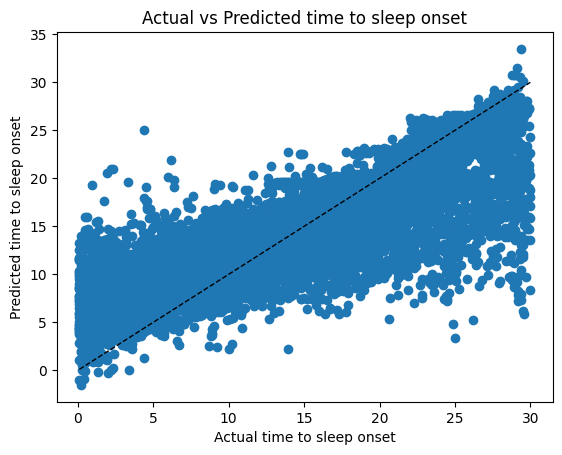

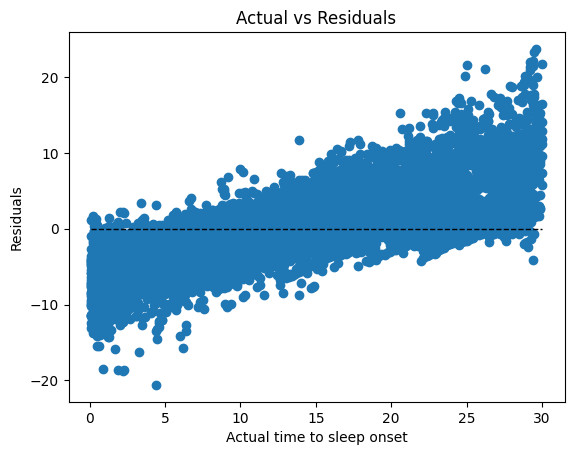

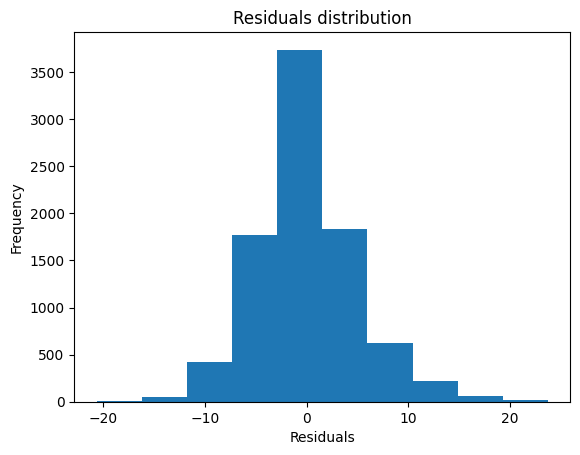

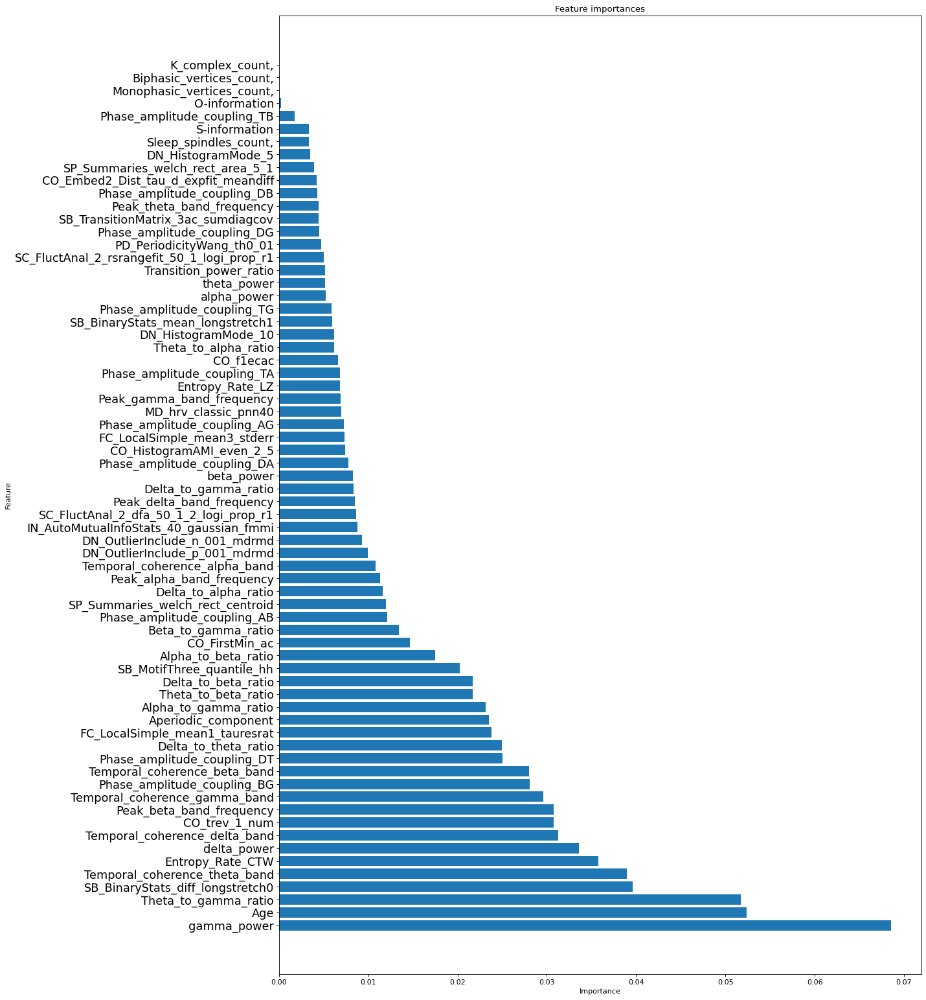

In [48]:
# evaluate the predictions made during cross-validation

errors, mape, accuracy, residuals, mse, rmse, r2 = evaluate_performance_train(gbr, X_train, y_train, predictions)


# Plot the feature importances
gbr.fit(X_train, y_train)
importances, indices, names = plot_feature_importances(gbr, X_train)

Mean Absolute Error: 3.59
Accuracy: 2.99 %.
Mean Squared Error: 23.49
Root Mean Squared Error: 4.85
R2: 0.65


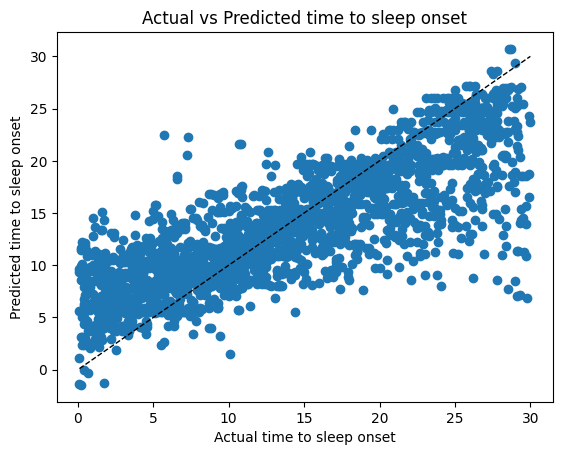

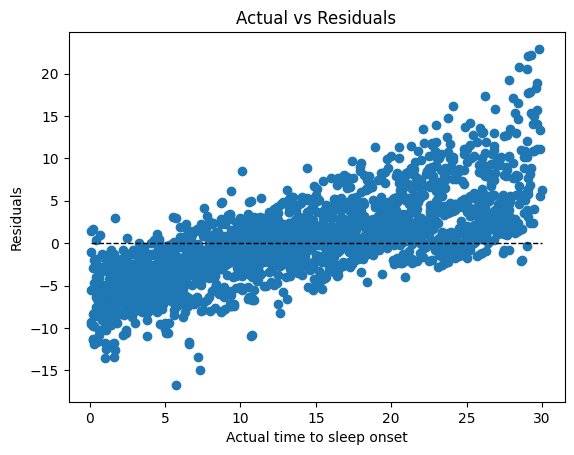

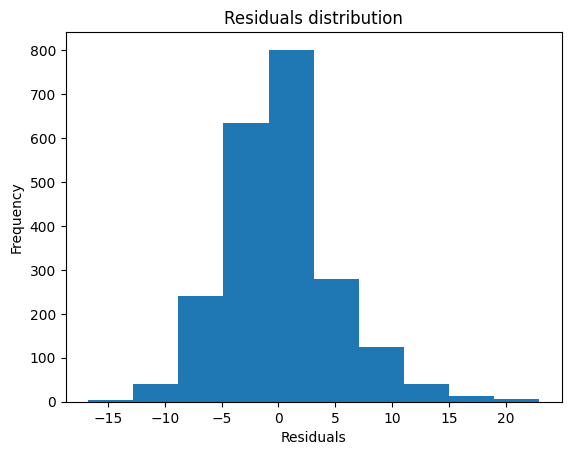

In [50]:
# Evaluate the performance on the test set

predictions_test, errors_test, mape_test, accuracy_test, residuals_test = evaluate_performance_test(gbr, X_test, y_test)


Mean Absolute Error: 3.45
Accuracy: -18.43 %.
Mean Squared Error: 22.42
Root Mean Squared Error: 4.74
R2: 0.67


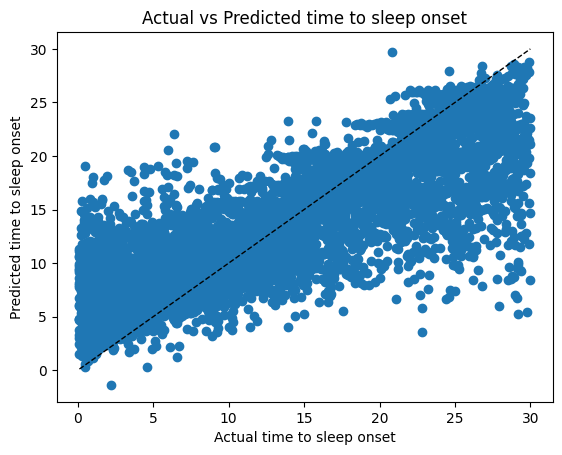

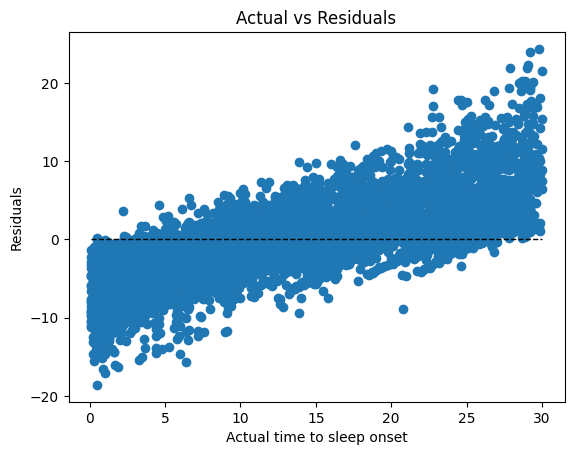

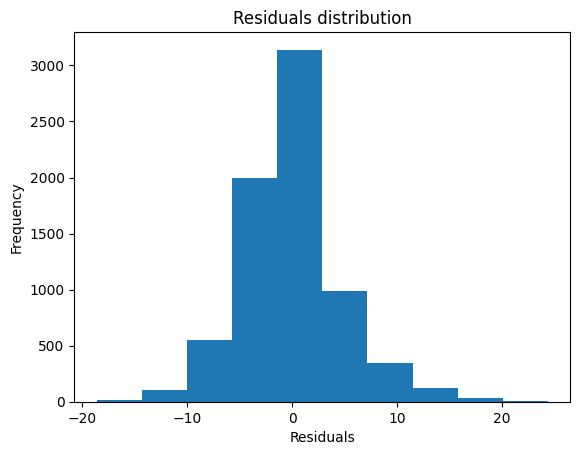

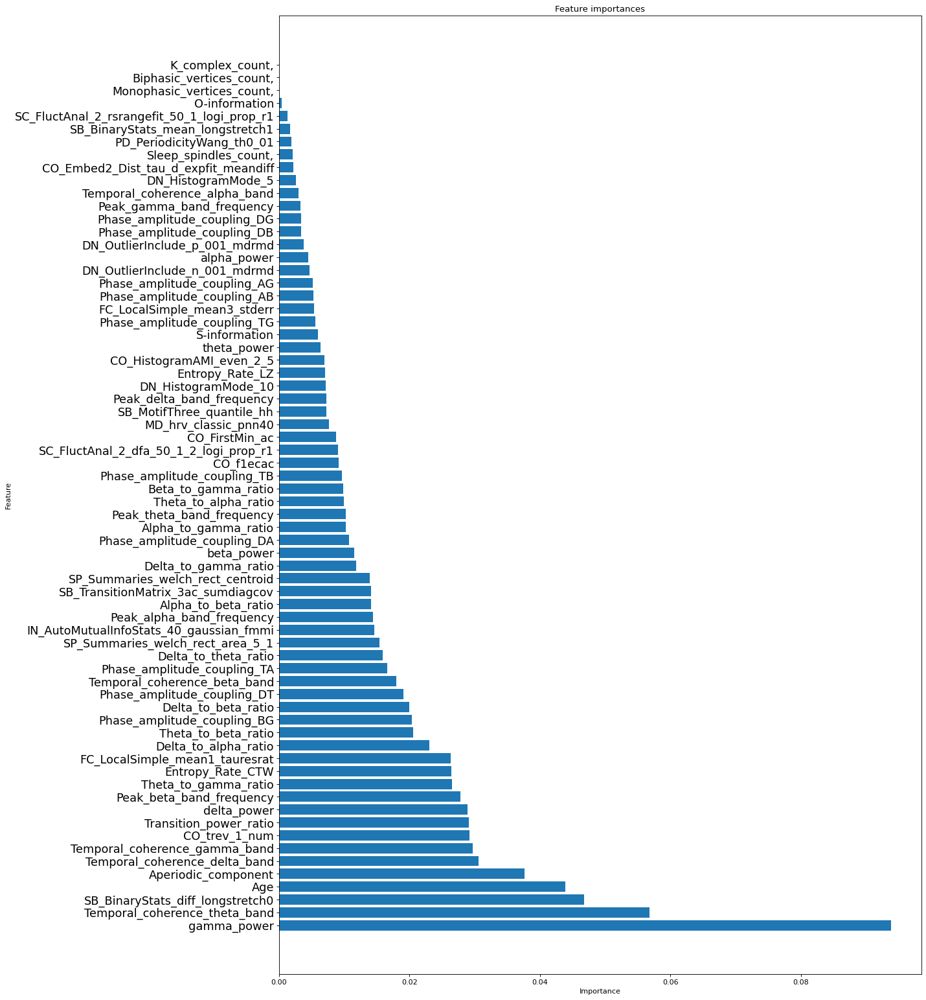

In [51]:
# Create a new dataset only with ifCleanOnset = 1
mydata_clean = mydata[mydata['ifCleanOnset'] == 1]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)
X_clean = mydata_clean.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)
y_clean = mydata_clean['Label']

# Split the data into training and testing sets
X_train_clean, X_test_clean, y_train_clean, y_test_clean = train_test_split(X_clean, y_clean, test_size=0.2, random_state=0)

# Create a gradient boosting regressor
gbr_clean = GradientBoostingRegressor(n_estimators=200)

# Perform cross-validation and get the predictions
predictions_clean = cross_val_predict(gbr_clean, X_train_clean, y_train_clean, cv=10)

# evaluate the predictions made during cross-validation
errors_clean, mape_clean, accuracy_clean, residuals_clean, mse_clean, rmse_clean, r2_clean = evaluate_performance_train(gbr_clean, X_train_clean, y_train_clean, predictions_clean)

# Plot the feature importances
gbr_clean.fit(X_train_clean, y_train_clean)
importances_clean, indices_clean, names_clean = plot_feature_importances(gbr_clean, X_train_clean)



Mean Absolute Error: 3.45
Accuracy: -36.55 %.
Mean Squared Error: 22.26
Root Mean Squared Error: 4.72
R2: 0.68


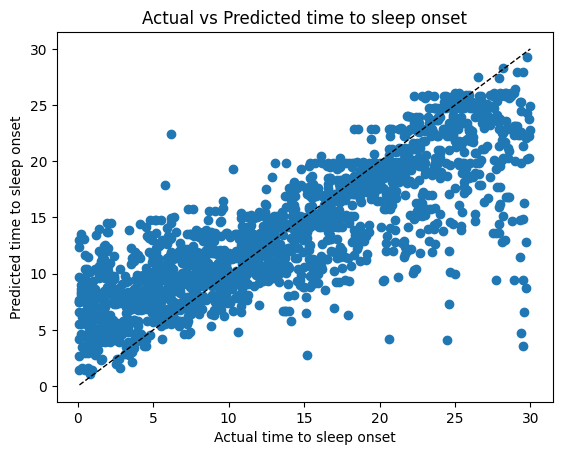

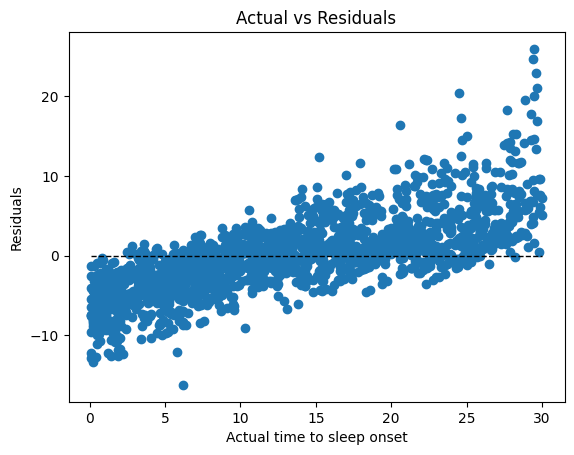

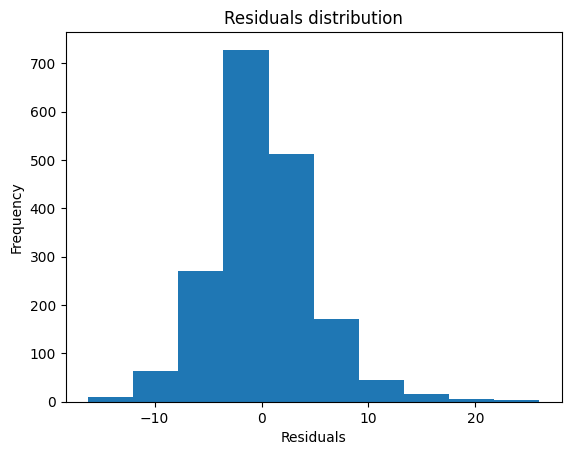

In [52]:

# Evaluate the performance on the test set

predictions_test_clean, errors_test_clean, mape_test_clean, accuracy_test_clean, residuals_test_clean = evaluate_performance_test(gbr_clean, X_test_clean, y_test_clean)

Mean Absolute Error: 1.92
Accuracy: -1.82 %.
Mean Squared Error: 6.56
Root Mean Squared Error: 2.56
R2: 0.65


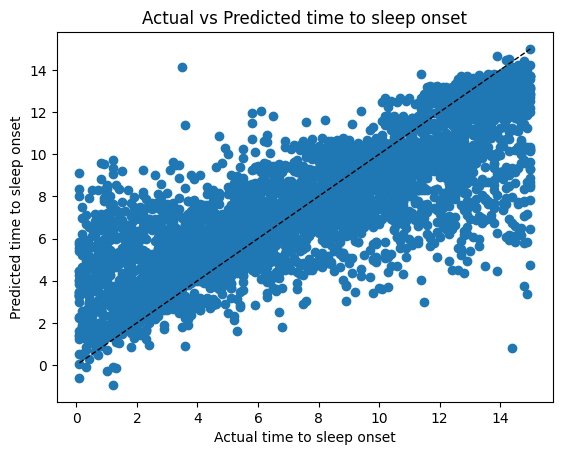

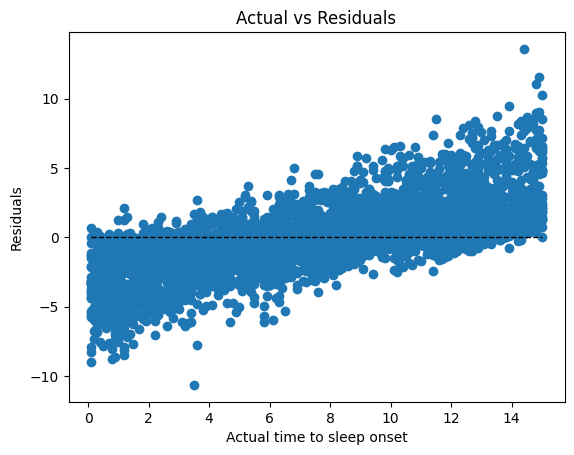

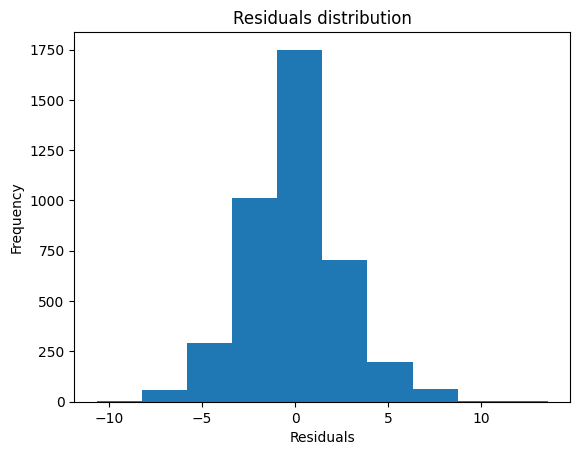

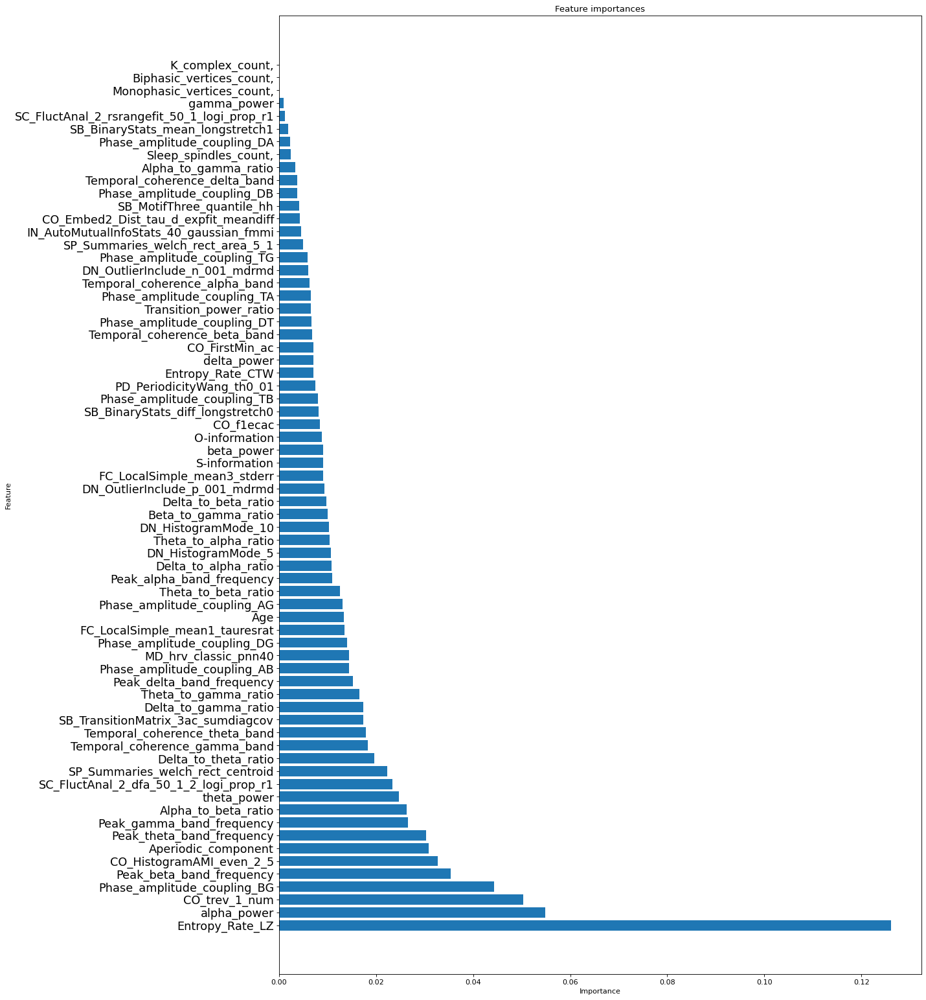

In [53]:
# # Repeat the task on the clean data with no longer than 15 minutes before the onset (Label <=15). Split the data into training and testing sets randomly


# Create a train dataframe 
X_clean_15 = mydata_clean_15.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)
y_clean_15 = mydata_clean_15['Label']

# Split the data into training and testing sets
X_train_15, X_test_15, y_train_15, y_test_15 = train_test_split(X_clean_15, y_clean_15, test_size=0.2, random_state=0)

# Create a gradient boosting regressor
gbr_clean_15 = GradientBoostingRegressor(n_estimators=200)

# Perform cross-validation and get the predictions
predictions_clean_15 = cross_val_predict(gbr_clean_15, X_train_15, y_train_15, cv=10)

# evaluate the predictions made during cross-validation
errors_clean_15, mape_clean_15, accuracy_clean_15, residuals_clean_15, mse_clean_15, rmse_clean_15, r2_clean_15 = evaluate_performance_train(gbr_clean_15, X_train_15, y_train_15, predictions_clean_15)

# Plot the feature importances
gbr_clean_15.fit(X_train_15, y_train_15)
importances_clean_15, indices_clean_15, names_clean_15 = plot_feature_importances(gbr_clean_15, X_train_15)





Mean Absolute Error: 1.83
Accuracy: 5.85 %.
Mean Squared Error: 5.87
Root Mean Squared Error: 2.42
R2: 0.68


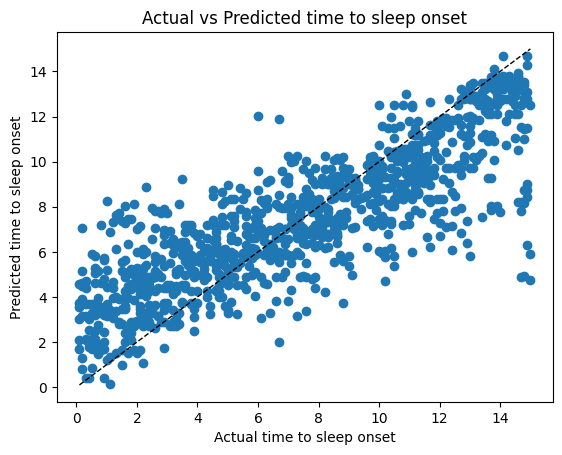

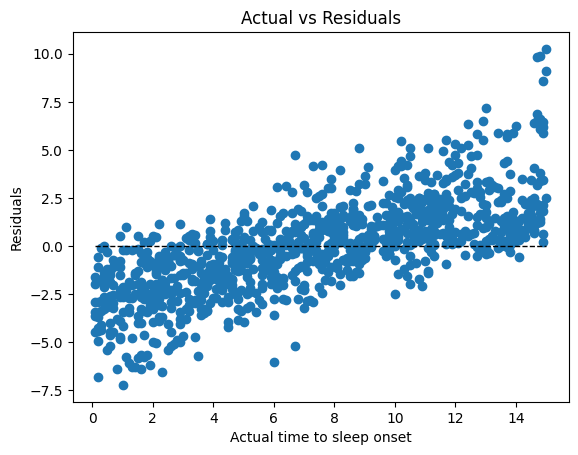

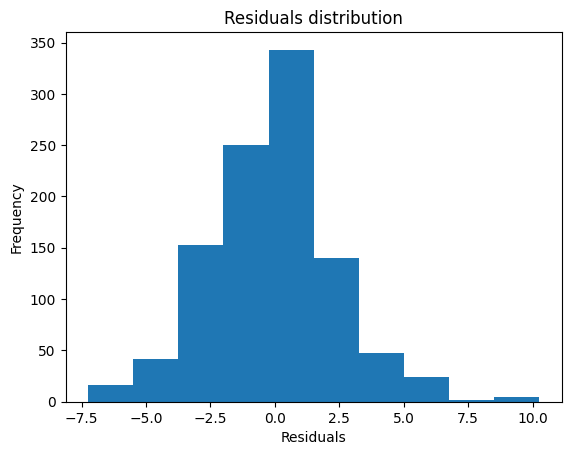

In [54]:
# Evaluate the performance on the test set

predictions_test_clean_15, errors_test_clean_15, mape_test_clean_15, accuracy_test_clean_15, residuals_test_clean_15 = evaluate_performance_test(gbr_clean_15, X_test_15, y_test_15)


Mean Absolute Error: 1.68
Accuracy: 92.02 %.
Mean Squared Error: 5.14
Root Mean Squared Error: 2.27
R2: 0.7


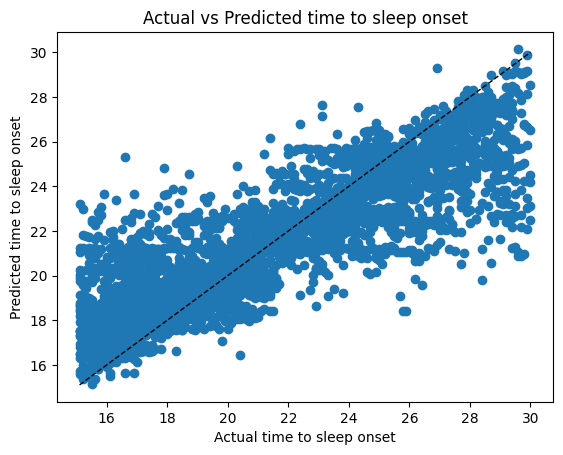

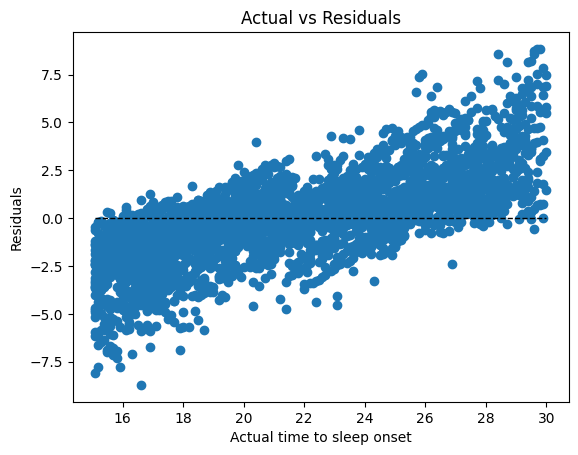

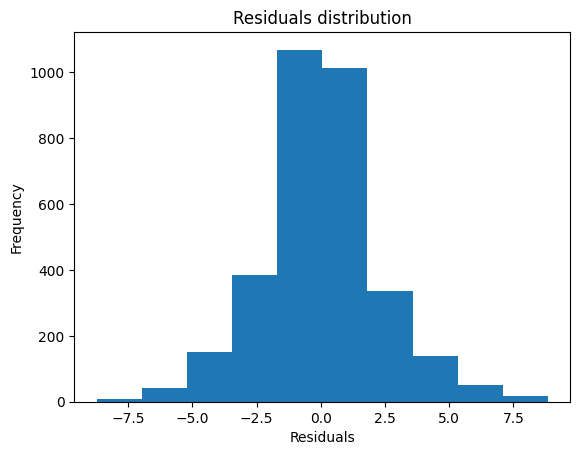

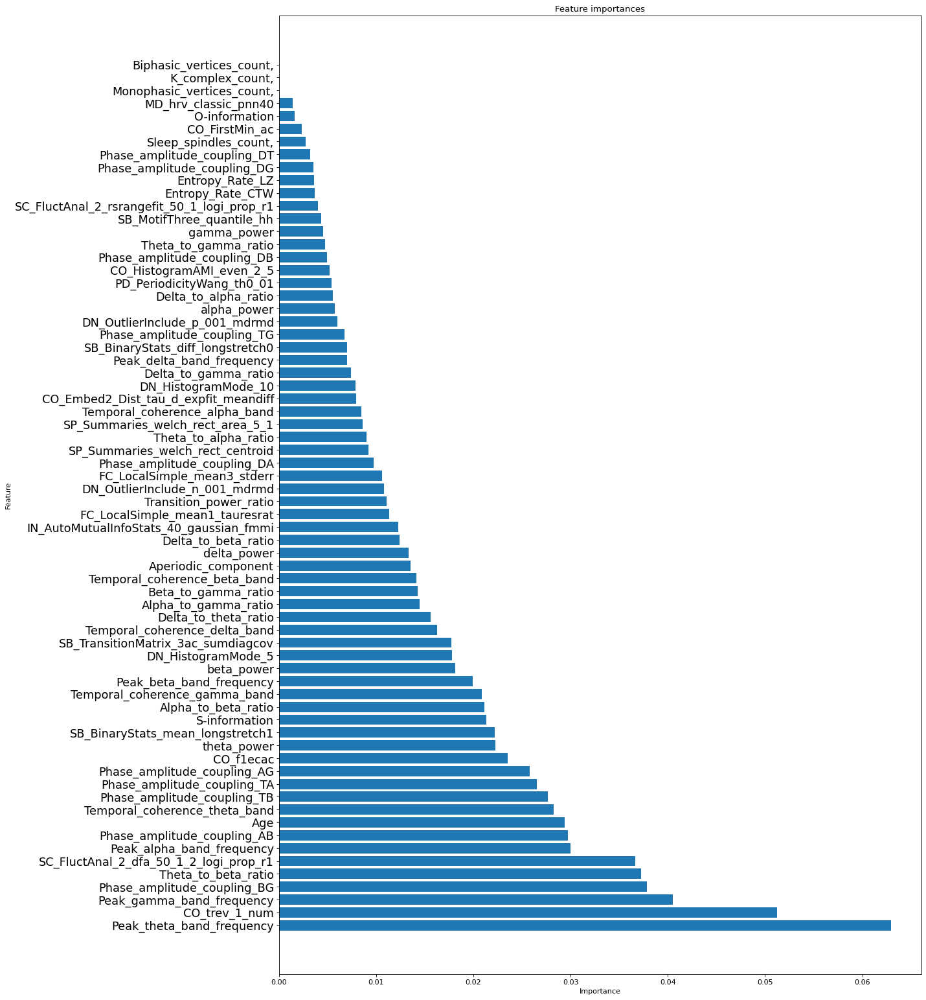

In [55]:
# # Repeat the task on the clean data with no longer than 15 minutes before the onset (Label > 15). Split the data into training and testing sets randomly

X_clean_15_1 = mydata_clean_15_1.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)
y_clean_15_1 = mydata_clean_15_1['Label']

# Split the data into training and testing sets

X_train_15_1, X_test_15_1, y_train_15_1, y_test_15_1 = train_test_split(X_clean_15_1, y_clean_15_1, test_size=0.2, random_state=0)

# Create a gradient boosting regressor

gbr_clean_15_1 = GradientBoostingRegressor(n_estimators=200)

# Perform cross-validation and get the predictions

predictions_clean_15_1 = cross_val_predict(gbr_clean_15_1, X_train_15_1, y_train_15_1, cv=10)

# evaluate the predictions made during cross-validation

errors_clean_15_1, mape_clean_15_1, accuracy_clean_15_1, residuals_clean_15_1, mse_clean_15_1, rmse_clean_15_1, r2_clean_15_1 = evaluate_performance_train(gbr_clean_15_1, X_train_15_1, y_train_15_1, predictions_clean_15_1)

# Plot the feature importances

gbr_clean_15_1.fit(X_train_15_1, y_train_15_1)

importances_clean_15_1, indices_clean_15_1, names_clean_15_1 = plot_feature_importances(gbr_clean_15_1, X_train_15_1)


Mean Absolute Error: 1.6
Accuracy: 92.35 %.
Mean Squared Error: 4.67
Root Mean Squared Error: 2.16
R2: 0.72


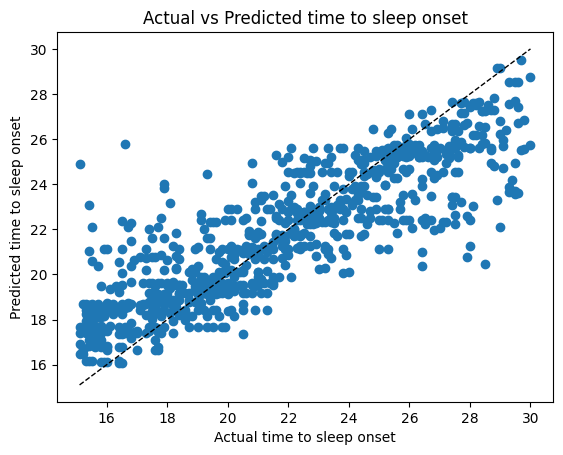

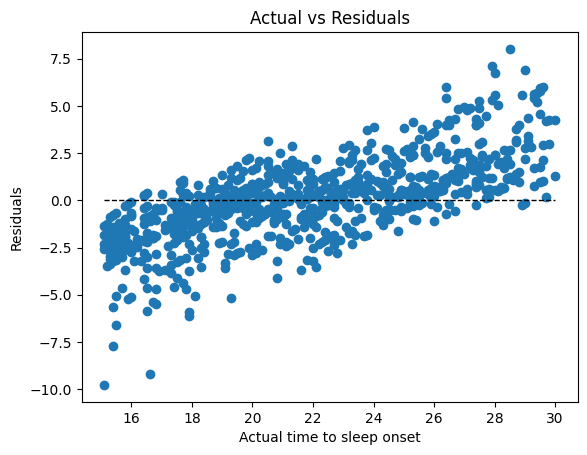

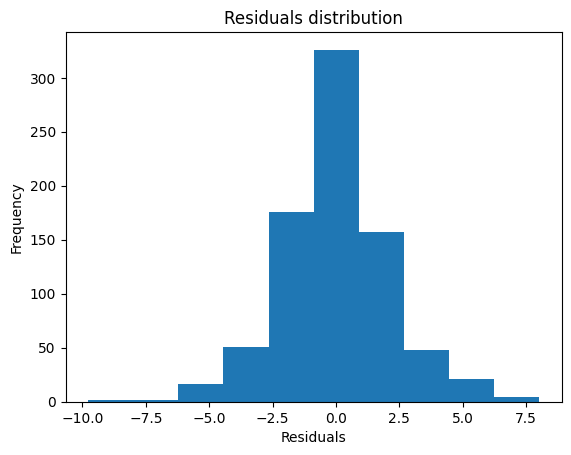

In [56]:
# evaluate the performance on the test set

predictions_test_clean_15_1, errors_test_clean_15_1, mape_test_clean_15_1, accuracy_test_clean_15_1, residuals_test_clean_15_1 = evaluate_performance_test(gbr_clean_15_1, X_test_15_1, y_test_15_1)

Mean Absolute Error: 3.56
Accuracy: -56.49 %.
Mean Squared Error: 19.2
Root Mean Squared Error: 4.38
R2: -0.03


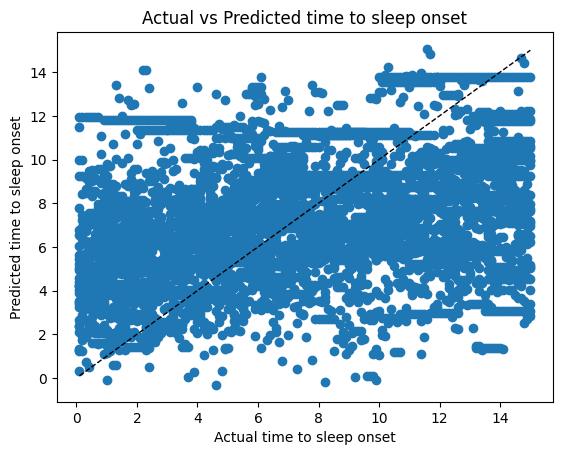

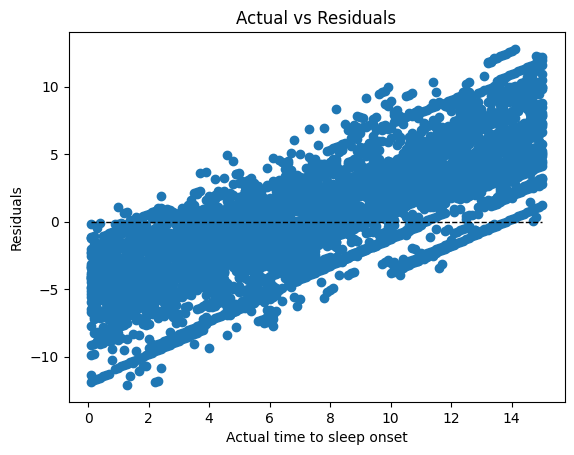

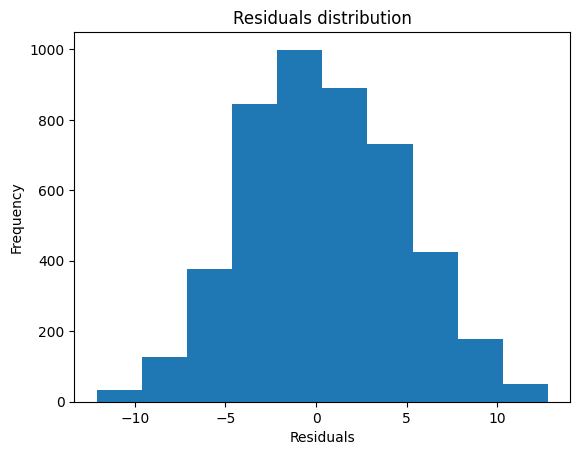

ValueError: too many values to unpack (expected 4)

In [57]:
# Repeat the task on the clean data with no longer than 15 minutes before the onset (Label <=15)

# Create a dataframe with the test subjects
test_data_15 = mydata_clean_15[mydata_clean_15['Sbj_ID'].isin(test_subjects)]

# Create a dataframe with the train subjects
train_data_15 = mydata_clean_15[mydata_clean_15['Sbj_ID'].isin(train_subjects)]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)
X_train_15 = train_data_15.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)
y_train_15 = train_data_15['Label']

X_test_15 = test_data_15.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)
y_test_15 = test_data_15['Label']

# Create a gradient boosting regressor
gbr_15 = GradientBoostingRegressor(n_estimators=200)

# Perform cross-validation and get the predictions
predictions_15 = cross_val_predict(gbr_15, X_train_15, y_train_15, cv=10)

# evaluate the predictions made during cross-validation
errors_15, mape_15, accuracy_15, residuals_15 = evaluate_performance_train(gbr_15, X_train_15, y_train_15, predictions_15)

# Plot the feature importances
gbr_15.fit(X_train_15, y_train_15)
importances_15, indices_15, names_15 = plot_feature_importances(gbr_15, X_train_15)


In [ ]:
# Evaluate the performance on the test set

predictions_test_15, errors_test_15, mape_test_15, accuracy_test_15, residuals_test_15 = evaluate_performance_test(gbr_15, X_test_15, y_test_15)

In [15]:
!pip install torch

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 55.8/55.8 MB 3.6 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.7/5.7 MB 5.4 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 6.6 MB/s eta 0:00:00a 0:00:01
  Using cached Jinja2-3.1.2-py3-none-any.whl (133 kB)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 536.2/536.2 kB 4.2 MB/s eta 0:00:00a 0:00:01


In [18]:
X.shape, y.shape

((10916, 68), (10916,))

In [19]:
# Reshape the features for RNN
X = X.reshape((-1, 68, 1))  # each sequence of 66 features is one sample

In [20]:
X.shape, y.shape

((10916, 68, 1), (10916,))

In [23]:
# Transform y from pandas series to numpy array
y = y.values

In [24]:

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Further split training data into training and validation sets
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.25, random_state=42)  # 0.25 x 0.8 = 0.2

# Convert to PyTorch tensors
X_train = torch.tensor(X_train, dtype=torch.float32)
y_train = torch.tensor(y_train, dtype=torch.float32)
X_val = torch.tensor(X_val, dtype=torch.float32)
y_val = torch.tensor(y_val, dtype=torch.float32)
X_test = torch.tensor(X_test, dtype=torch.float32)
y_test = torch.tensor(y_test, dtype=torch.float32)


In [78]:
mydata = pd.read_csv('/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/regression_so_samples_61_subjects.csv') 

In [82]:
# Assuming 'participant' is a column that specifies the participant for each row
participants = mydata['Sbj_ID'].unique()

# Reshape the data so that each participant's sequence is a separate sample
X_list = []
y_list = []

for participant in participants:
    participant_data = mydata[mydata['Sbj_ID'] == participant]

    # Delete rows with NaN values
    participant_data = participant_data.dropna()


    X_participant = participant_data.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)  # features
    y_participant = participant_data['Label'].values  # targets
    
    # Normalize the features
    scaler = MinMaxScaler()
    X_participant = scaler.fit_transform(X_participant)
    
    # Reshape the features for RNN
    X_participant = X_participant.reshape((-1, 68, 1))  # each participant's sequence of features is one sample
    
    X_list.append(torch.tensor(X_participant, dtype=torch.float32))
    y_list.append(torch.tensor(y_participant, dtype=torch.float32))

# Now X_list is a list of 2D tensors, and y_list is a list of 1D tensors
   

In [83]:
X_list[8].shape, y_list[8].shape

(torch.Size([300, 68, 1]), torch.Size([300]))

In [84]:
from torch.nn.utils.rnn import pad_sequence
from torch.utils.data import Dataset, DataLoader

class PaddedSequenceDataset(Dataset):
    def __init__(self, X_list, y_list):
        self.X_list = X_list
        self.y_list = y_list

    def __len__(self):
        return len(self.X_list)

    def __getitem__(self, idx):
        return self.X_list[idx], self.y_list[idx]

def collate_fn(batch):
    X_list, y_list = zip(*batch)
    
    # Compute lengths
    lengths = [len(X) for X in X_list]

    # Pad sequences
    X_padded = pad_sequence([X for X in X_list], batch_first=True)
    y_padded = pad_sequence([y for y in y_list], batch_first=True)

    return X_padded, y_padded, lengths



In [331]:
from sklearn.model_selection import train_test_split

batch_size = 1
# Split the data into train and test sets
X_train_list, X_test_list, y_train_list, y_test_list = train_test_split(X_list, y_list, test_size=0.2, random_state=42)

# Split the train set again into train and validation sets
X_train_list, X_val_list, y_train_list, y_val_list = train_test_split(X_train_list, y_train_list, test_size=0.25, random_state=42) # 0.25 x 0.8 = 0.2

# Create datasets for each set
train_dataset = PaddedSequenceDataset(X_train_list, y_train_list)
val_dataset = PaddedSequenceDataset(X_val_list, y_val_list)
test_dataset = PaddedSequenceDataset(X_test_list, y_test_list)

# Create dataloaders for each set
train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, collate_fn=collate_fn)
val_dataloader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, collate_fn=collate_fn)
test_dataloader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, collate_fn=collate_fn)

In [332]:
dataset = PaddedSequenceDataset(X_list, y_list)
dataloader = DataLoader(dataset, batch_size=1, shuffle=True, collate_fn=collate_fn)

In [340]:
class RNNModel(nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(RNNModel, self).__init__()
        
        self.hidden_size = hidden_size
        self.rnn = nn.RNN(input_size, hidden_size, batch_first=True)  
        self.fc = nn.Linear(hidden_size, output_size)               
    
    def forward(self, x, lengths):
        # Remove redundant dimension
        x = x.squeeze(dim=-1)
        
        # Ensure lengths is a 1D tensor of type long on the same device as the model
        lengths = torch.tensor(lengths).to(x.device).long()
        
        # Pack the sequences
        x_packed = nn.utils.rnn.pack_padded_sequence(x, lengths.cpu(), batch_first=True, enforce_sorted=False)
        
        # Process the sequences through the RNN
        out_packed, _ = self.rnn(x_packed)
        
        # Unpack the sequences
        out, _ = nn.utils.rnn.pad_packed_sequence(out_packed, batch_first=True)

        # Run the final fully connected layer only on the last output for each sequence
        #out_last = out[range(len(out)), lengths - 1, :]
        #out = self.fc(out_last)

        # Run the fully connected layer on each output element individually
        out = torch.stack([self.fc(out[i, :lengths[i]]) for i in range(len(out))])
  
        return out

In [358]:
class RNNModel(nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(RNNModel, self).__init__()

        self.hidden_size = hidden_size
        self.rnn = nn.RNN(input_size, hidden_size, batch_first=True)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, x, lengths):
        # Remove redundant dimension
        x = x.squeeze(dim=-1)

        # Ensure lengths is a 1D tensor of type long on the same device as the model
        lengths = torch.tensor(lengths).to(x.device).long()

        # Pack the sequences
        x_packed = nn.utils.rnn.pack_padded_sequence(x, lengths.cpu(), batch_first=True, enforce_sorted=False)

        # Process the sequences through the RNN
        packed_output, _ = self.rnn(x_packed)

        # Unpack the sequences
        output, _ = nn.utils.rnn.pad_packed_sequence(packed_output, batch_first=True)

        # Run the fully connected layer on each output of the sequence
        out = torch.stack([self.fc(output[i, :lengths[i]]) for i in range(len(output))])

        return out

In [359]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
num_epochs  = 50

input_size = 68
hidden_size = 512
output_size = 1
learning_rate = 0.005

In [360]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

model = RNNModel(input_size, hidden_size, output_size)
model = model.to(device)

criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

# For each epoch
for epoch in range(num_epochs):
    # Training phase
    model.train()
    epoch_loss = 0.0
    num_batches = 0

    for i, (X, y, lengths) in enumerate(train_dataloader):
        X = X.to(device)
        y = y.to(device)

        # Forward pass

        outputs = model(X, lengths)

        loss = criterion(outputs, y)
        print('outputs', outputs), print('y', y), print('loss', loss)

        # Backward pass and optimize
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        epoch_loss += loss.item()
        num_batches += 1

    # Calculate average loss for the epoch
    avg_loss = epoch_loss / num_batches

    # Validation phase
    model.eval()
    with torch.no_grad():
        total_val_loss = 0
        num_val_batches = 0

        for i, (X_val, y_val, lengths_val) in enumerate(val_dataloader):
            X_val = X_val.to(device)
            y_val = y_val.to(device)

            # Forward pass
            val_outputs = model(X_val, lengths_val)
            val_loss = criterion(val_outputs, y_val)
            total_val_loss += val_loss.item()
            num_val_batches += 1

        avg_val_loss = total_val_loss / num_val_batches

    print(f'Epoch {epoch+1}/{num_epochs}, Train Loss: {avg_loss:.4f}, Val Loss: {avg_val_loss:.4f}')

/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 294])) that is different to the input size (torch.Size([1, 294, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 296])) that is different to the input size (torch.Size([1, 296, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 260])) that is different 

outputs tensor([[[-0.0113],
         [ 0.0466],
         [ 0.0768],
         [ 0.0635],
         [ 0.0289],
         [ 0.0325],
         [ 0.0282],
         [ 0.0324],
         [ 0.0342],
         [ 0.0348],
         [ 0.0344],
         [ 0.0343],
         [ 0.0337],
         [ 0.0339],
         [ 0.0338],
         [ 0.0339],
         [ 0.0338],
         [ 0.0339],
         [ 0.0339],
         [ 0.0339],
         [ 0.0339],
         [ 0.0339],
         [ 0.0339],
         [ 0.0339],
         [ 0.0339],
         [ 0.0339],
         [ 0.0339],
         [ 0.0339],
         [ 0.0339],
         [ 0.0339],
         [ 0.0339],
         [ 0.0339],
         [ 0.0339],
         [ 0.0339],
         [ 0.0339],
         [ 0.0339],
         [ 0.0339],
         [ 0.0339],
         [ 0.0339],
         [ 0.0339],
         [ 0.0339],
         [ 0.0339],
         [ 0.0339],
         [ 0.0339],
         [ 0.0339],
         [ 0.0339],
         [ 0.0339],
         [ 0.0339],
         [ 0.0339],
         [ 0

/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 199])) that is different to the input size (torch.Size([1, 199, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 279])) that is different to the input size (torch.Size([1, 279, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 292])) that is different 

outputs tensor([[[ 4.2211],
         [10.6937],
         [11.9317],
         [11.9756],
         [11.9765],
         [11.9858],
         [11.9856],
         [11.9739],
         [11.9898],
         [11.9844],
         [11.9869],
         [11.9855],
         [11.9862],
         [11.9858],
         [11.9861],
         [11.9859],
         [11.9840],
         [11.9884],
         [11.9884],
         [11.9885],
         [11.9884],
         [11.9885],
         [11.9885],
         [11.9885],
         [11.9885],
         [11.9885],
         [11.9885],
         [11.9885],
         [11.9885],
         [11.9885],
         [11.9885],
         [11.9885],
         [11.9885],
         [11.9885],
         [11.9885],
         [11.9885],
         [11.9885],
         [11.9885],
         [11.9885],
         [11.9885],
         [11.9885],
         [11.9885],
         [11.9885],
         [11.9885],
         [11.9885],
         [11.9885],
         [11.9885],
         [11.9885],
         [11.9885],
         [11

/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 300])) that is different to the input size (torch.Size([1, 300, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 297])) that is different to the input size (torch.Size([1, 297, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


outputs tensor([[[ 7.2187],
         [14.2816],
         [14.6709],
         [14.6265],
         [14.6225],
         [14.6271],
         [14.6128],
         [14.6201],
         [14.6187],
         [14.6207],
         [14.6214],
         [14.6214],
         [14.6214],
         [14.6214],
         [14.6214],
         [14.6214],
         [14.6214],
         [14.6214],
         [14.6214],
         [14.6214],
         [14.6214],
         [14.6155],
         [14.6243],
         [14.6208],
         [14.6278],
         [14.6281],
         [14.6184],
         [14.6198],
         [14.6204],
         [14.6175],
         [14.6172],
         [14.6245],
         [14.6222],
         [14.6215],
         [14.6240],
         [14.6245],
         [14.6245],
         [14.6245],
         [14.6245],
         [14.6245],
         [14.6245],
         [14.6245],
         [14.6245],
         [14.6245],
         [14.6245],
         [14.6245],
         [14.6245],
         [14.6245],
         [14.6245],
         [14

/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 210])) that is different to the input size (torch.Size([1, 210, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 299])) that is different to the input size (torch.Size([1, 299, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


outputs tensor([[[ 7.3423],
         [15.7485],
         [15.9941],
         [15.9753],
         [15.9730],
         [15.9723],
         [15.9835],
         [15.9723],
         [15.9745],
         [15.9738],
         [15.9702],
         [15.9702],
         [15.9703],
         [15.9703],
         [15.9749],
         [15.9714],
         [15.9715],
         [15.9717],
         [15.9717],
         [15.9702],
         [15.9741],
         [15.9732],
         [15.9734],
         [15.9734],
         [15.9697],
         [15.9737],
         [15.9757],
         [15.9729],
         [15.9735],
         [15.9734],
         [15.9734],
         [15.9711],
         [15.9670],
         [15.9721],
         [15.9737],
         [15.9732],
         [15.9721],
         [15.9711],
         [15.9709],
         [15.9709],
         [15.9734],
         [15.9726],
         [15.9728],
         [15.9728],
         [15.9720],
         [15.9726],
         [15.9728],
         [15.9728],
         [15.9678],
         [15

/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 113])) that is different to the input size (torch.Size([1, 113, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 166])) that is different to the input size (torch.Size([1, 166, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 293])) that is different 

outputs tensor([[[ 9.3270],
         [11.4711],
         [11.4741],
         [11.4713],
         [11.4738],
         [11.4786],
         [11.4709],
         [11.4745],
         [11.4751],
         [11.4748],
         [11.4750],
         [11.4701],
         [11.4685],
         [11.4692],
         [11.4696],
         [11.4694],
         [11.4694],
         [11.4694],
         [11.4694],
         [11.4694],
         [11.4694],
         [11.4694],
         [11.4694],
         [11.4732],
         [11.4734],
         [11.4733],
         [11.4735],
         [11.4751],
         [11.4692],
         [11.4717],
         [11.4713],
         [11.4757],
         [11.4712],
         [11.4759],
         [11.4769],
         [11.4767],
         [11.4740],
         [11.4730],
         [11.4661],
         [11.4685],
         [11.4688],
         [11.4686],
         [11.4726],
         [11.4690],
         [11.4711],
         [11.4714],
         [11.4680],
         [11.4705],
         [11.4701],
         [11

/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 274])) that is different to the input size (torch.Size([1, 274, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 280])) that is different to the input size (torch.Size([1, 280, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


outputs tensor([[[6.8599],
         [9.9526],
         [9.9744],
         [9.9763],
         [9.9763],
         [9.9763],
         [9.9755],
         [9.9753],
         [9.9757],
         [9.9757],
         [9.9757],
         [9.9758],
         [9.9763],
         [9.9763],
         [9.9741],
         [9.9741],
         [9.9746],
         [9.9746],
         [9.9743],
         [9.9750],
         [9.9768],
         [9.9759],
         [9.9761],
         [9.9767],
         [9.9767],
         [9.9746],
         [9.9753],
         [9.9753],
         [9.9753],
         [9.9742],
         [9.9748],
         [9.9747],
         [9.9747],
         [9.9747],
         [9.9747],
         [9.9747],
         [9.9747],
         [9.9747],
         [9.9747],
         [9.9747],
         [9.9747],
         [9.9747],
         [9.9747],
         [9.9747],
         [9.9747],
         [9.9747],
         [9.9747],
         [9.9747],
         [9.9747],
         [9.9747],
         [9.9747],
         [9.9747],
    

/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 140])) that is different to the input size (torch.Size([1, 140, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 278])) that is different to the input size (torch.Size([1, 278, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 240])) that is different 

outputs tensor([[[ 7.7375],
         [11.4903],
         [11.5252],
         [11.5255],
         [11.5261],
         [11.5265],
         [11.5262],
         [11.5272],
         [11.5271],
         [11.5264],
         [11.5268],
         [11.5269],
         [11.5245],
         [11.5248],
         [11.5246],
         [11.5249],
         [11.5247],
         [11.5247],
         [11.5245],
         [11.5252],
         [11.5249],
         [11.5247],
         [11.5252],
         [11.5246],
         [11.5244],
         [11.5244],
         [11.5244],
         [11.5244],
         [11.5244],
         [11.5244],
         [11.5244],
         [11.5244],
         [11.5244],
         [11.5244],
         [11.5244],
         [11.5244],
         [11.5244],
         [11.5244],
         [11.5244],
         [11.5244],
         [11.5244],
         [11.5244],
         [11.5244],
         [11.5244],
         [11.5244],
         [11.5244],
         [11.5244],
         [11.5244],
         [11.5244],
         [11

/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 275])) that is different to the input size (torch.Size([1, 275, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 283])) that is different to the input size (torch.Size([1, 283, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 189])) that is different 

Epoch 1/50, Train Loss: 85.5210, Val Loss: 70.8202
outputs tensor([[[ 7.8320],
         [13.2813],
         [13.3320],
         [13.3323],
         [13.3319],
         [13.3323],
         [13.3321],
         [13.3321],
         [13.3321],
         [13.3320],
         [13.3319],
         [13.3321],
         [13.3321],
         [13.3319],
         [13.3318],
         [13.3319],
         [13.3321],
         [13.3321],
         [13.3321],
         [13.3321],
         [13.3321],
         [13.3321],
         [13.3321],
         [13.3321],
         [13.3321],
         [13.3321],
         [13.3321],
         [13.3321],
         [13.3321],
         [13.3321],
         [13.3321],
         [13.3321],
         [13.3321],
         [13.3321],
         [13.3321],
         [13.3321],
         [13.3321],
         [13.3321],
         [13.3321],
         [13.3321],
         [13.3321],
         [13.3321],
         [13.3321],
         [13.3321],
         [13.3321],
         [13.3321],
         [13.3321],
 

# Apply loss for each element of a sequence

In [381]:
# Build an RNN model that would take as input a sequence of 68-dimensional vectors and output a sequence of predictions for each element of the input sequence. The model should have a single RNN layer with 512 hidden units and a fully connected layer that maps from the hidden state to the output. Use the mean squared error loss function and the Adam optimizer with a learning rate of 0.005. Train the model for 50 epochs and report the training and validation losses.

class RNNModel(nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(RNNModel, self).__init__()

        self.hidden_size = hidden_size
        self.rnn = nn.RNN(input_size, hidden_size, batch_first=True)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, x, lengths):
        # Remove redundant dimension
        x = x.squeeze(dim=-1)

        # Ensure lengths is a 1D tensor of type long on the same device as the model
        lengths = torch.tensor(lengths).to(x.device).long()

        # Pack the sequences
        x_packed = nn.utils.rnn.pack_padded_sequence(x, lengths.cpu(), batch_first=True, enforce_sorted=False)

        # Process the sequences through the RNN
        packed_output, _ = self.rnn(x_packed)

        # Unpack the sequences
        output, _ = nn.utils.rnn.pad_packed_sequence(packed_output, batch_first=True)

        # Run the fully connected layer on each output of the sequence
        out = torch.stack([self.fc(output[i, :lengths[i]]) for i in range(len(output))])

        return out
    



In [395]:


class RNNModel(nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(RNNModel, self).__init__()

        self.hidden_size = hidden_size
        self.rnn = nn.RNN(input_size, hidden_size, batch_first=True)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, x, lengths, hidden=None):
        # Remove redundant dimension
        x = x.squeeze(dim=-1)

        # Pack the sequences
        x_packed = nn.utils.rnn.pack_padded_sequence(x, lengths.cpu(), batch_first=True, enforce_sorted=False)

        # ensure the dimensions of the x_packed state are correct
        assert x_packed.batch_sizes.shape[0] == x.shape[0]

        # Process the sequences through the RNN
        print(x_packed)
        print(hidden)
        packed_output, hidden = self.rnn(x_packed, hidden)

        # Unpack the sequences
        output, _ = nn.utils.rnn.pad_packed_sequence(packed_output, batch_first=True)

        # Run the fully connected layer on each output of the sequence
        out = torch.stack([self.fc(output[i, :lengths[i]]) for i in range(len(output))])

        return out, hidden

In [396]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

model = RNNModel(input_size, hidden_size, output_size)
model = model.to(device)

criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

# For each epoch
for epoch in range(num_epochs):
    # Training phase
    model.train()
    total_loss = 0
    total_samples = 0
    for X, y, lengths in train_dataloader:
        X = X.to(device)
        y = y.to(device)
        # Ensure lengths is a 1D tensor of type long on the same device as the model
        lengths = torch.tensor(lengths).to(device).long()
        
    

        # Reset the hidden state for each new sequence
        hidden = None

        # Iterate over each element in the sequence
        for j in range(X.size(1)):
            # Forward pass for the current element
            output = model(X[:, j, :], lengths, hidden)

            # Get the corresponding label for the current element
            target = y[:, j]

            # Compute the loss for the current element
            loss = criterion(output, target)

            # Backward pass and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            total_loss += loss.item()
            total_samples += X.size(0)

    # Compute the average loss for the epoch
    avg_loss = total_loss / total_samples

    # Print the average loss for the epoch
    print(f'Epoch {epoch+1}/{num_epochs}, Average Loss: {avg_loss}')

AssertionError: 

In [345]:

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

model = RNNModel(input_size, hidden_size, output_size)
model = model.to(device)

criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

# For each epoch
for epoch in range(num_epochs):
    # Training phase
    model.train()
    for i, (X, y, lengths) in enumerate(train_dataloader):
        X = X.to(device)
        y = y.to(device)

        # Forward pass
        outputs = model(X, lengths)
    
        loss = criterion(outputs, y)
        print('outputs', outputs)
        print('y', y)
        print('loss', loss)
        

        # Backward pass and optimize
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

    # Validation phase
    model.eval()
    with torch.no_grad():
        total_val_loss = 0
        for i, (X_val, y_val, lengths_val) in enumerate(val_dataloader):
            X_val = X_val.to(device)
            y_val = y_val.to(device)

            # Forward pass
            val_outputs = model(X_val, lengths_val)
            val_loss = criterion(val_outputs, y_val)
            total_val_loss += val_loss.item()

    print(f'Epoch {epoch+1}/{num_epochs}, Train Loss: {loss.item()}, Validation Loss: {total_val_loss/len(val_dataloader)}')

/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 300])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 140])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 280])) that is different to the inp

outputs tensor([[0.0619]], grad_fn=<AddmmBackward0>)
y tensor([[30.0000, 29.9000, 29.8000, 29.7000, 29.6000, 29.5000, 29.4000, 29.3000,
         29.2000, 29.1000, 29.0000, 28.9000, 28.8000, 28.7000, 28.6000, 28.5000,
         28.4000, 28.3000, 28.2000, 28.1000, 28.0000, 27.9000, 27.8000, 27.7000,
         27.6000, 27.5000, 27.4000, 27.3000, 27.2000, 27.1000, 27.0000, 26.9000,
         26.8000, 26.7000, 26.6000, 26.5000, 26.4000, 26.3000, 26.2000, 26.1000,
         26.0000, 25.9000, 25.8000, 25.7000, 25.6000, 25.5000, 25.4000, 25.3000,
         25.2000, 25.1000, 25.0000, 24.9000, 24.8000, 24.7000, 24.6000, 24.5000,
         24.4000, 24.3000, 24.2000, 24.1000, 24.0000, 23.9000, 23.8000, 23.7000,
         23.6000, 23.5000, 23.4000, 23.3000, 23.2000, 23.1000, 23.0000, 22.9000,
         22.8000, 22.7000, 22.6000, 22.5000, 22.4000, 22.3000, 22.2000, 22.1000,
         22.0000, 21.9000, 21.8000, 21.7000, 21.6000, 21.5000, 21.4000, 21.3000,
         21.2000, 21.1000, 21.0000, 20.9000, 20.8000, 

/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 279])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 294])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 299])) that is different to the inp

outputs tensor([[14.3518]], grad_fn=<AddmmBackward0>)
y tensor([[27.9000, 27.8000, 27.7000, 27.6000, 27.5000, 27.4000, 27.3000, 27.2000,
         27.1000, 27.0000, 26.9000, 26.8000, 26.7000, 26.6000, 26.5000, 26.4000,
         26.3000, 26.2000, 26.1000, 26.0000, 25.9000, 25.8000, 25.7000, 25.6000,
         25.5000, 25.4000, 25.3000, 25.2000, 25.1000, 25.0000, 24.9000, 24.8000,
         24.7000, 24.6000, 24.5000, 24.4000, 24.3000, 24.2000, 24.1000, 24.0000,
         23.9000, 23.8000, 23.7000, 23.6000, 23.5000, 23.4000, 23.3000, 23.2000,
         23.1000, 23.0000, 22.9000, 22.8000, 22.7000, 22.6000, 22.5000, 22.4000,
         22.3000, 22.2000, 22.1000, 22.0000, 21.9000, 21.8000, 21.7000, 21.6000,
         21.5000, 21.4000, 21.3000, 21.2000, 21.1000, 21.0000, 20.9000, 20.8000,
         20.7000, 20.6000, 20.5000, 20.4000, 20.3000, 20.2000, 20.1000, 20.0000,
         19.9000, 19.8000, 19.7000, 19.6000, 19.5000, 19.4000, 19.3000, 19.2000,
         19.1000, 19.0000, 18.9000, 18.8000, 18.7000,

/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 240])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 297])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 260])) that is different to the inp

outputs tensor([[16.6714]], grad_fn=<AddmmBackward0>)
y tensor([[24.0000, 23.9000, 23.8000, 23.7000, 23.6000, 23.5000, 23.4000, 23.3000,
         23.2000, 23.1000, 23.0000, 22.9000, 22.8000, 22.7000, 22.6000, 22.5000,
         22.4000, 22.3000, 22.2000, 22.1000, 22.0000, 21.9000, 21.8000, 21.7000,
         21.6000, 21.5000, 21.4000, 21.3000, 21.2000, 21.1000, 21.0000, 20.9000,
         20.8000, 20.7000, 20.6000, 20.5000, 20.4000, 20.3000, 20.2000, 20.1000,
         20.0000, 19.9000, 19.8000, 19.7000, 19.6000, 19.5000, 19.4000, 19.3000,
         19.2000, 19.1000, 19.0000, 18.9000, 18.8000, 18.7000, 18.6000, 18.5000,
         18.4000, 18.3000, 18.2000, 18.1000, 18.0000, 17.9000, 17.8000, 17.7000,
         17.6000, 17.5000, 17.4000, 17.3000, 17.2000, 17.1000, 17.0000, 16.9000,
         16.8000, 16.7000, 16.6000, 16.5000, 16.4000, 16.3000, 16.2000, 16.1000,
         16.0000, 15.9000, 15.8000, 15.7000, 15.6000, 15.5000, 15.4000, 15.3000,
         15.2000, 15.1000, 15.0000, 14.9000, 14.8000,

/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 113])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 293])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 296])) that is different to the inp

outputs tensor([[10.9439]], grad_fn=<AddmmBackward0>)
y tensor([[29.6000, 29.5000, 29.4000, 29.3000, 29.2000, 29.1000, 29.0000, 28.9000,
         28.8000, 28.7000, 28.6000, 28.5000, 28.4000, 28.3000, 28.2000, 28.1000,
         28.0000, 27.9000, 27.8000, 27.7000, 27.6000, 27.5000, 27.4000, 27.3000,
         27.2000, 27.1000, 27.0000, 26.9000, 26.8000, 26.7000, 26.6000, 26.5000,
         26.4000, 26.3000, 26.2000, 26.1000, 26.0000, 25.9000, 25.8000, 25.7000,
         25.6000, 25.5000, 25.4000, 25.3000, 25.2000, 25.1000, 25.0000, 24.9000,
         24.8000, 24.7000, 24.6000, 24.5000, 24.4000, 24.3000, 24.2000, 24.1000,
         24.0000, 23.9000, 23.8000, 23.7000, 23.6000, 23.5000, 23.4000, 23.3000,
         23.2000, 23.1000, 23.0000, 22.9000, 22.8000, 22.7000, 22.6000, 22.5000,
         22.4000, 22.3000, 22.2000, 22.1000, 22.0000, 21.9000, 21.8000, 21.7000,
         21.6000, 21.5000, 21.4000, 21.3000, 21.2000, 21.1000, 21.0000, 20.9000,
         20.8000, 20.7000, 20.6000, 20.5000, 20.4000,

/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 210])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 166])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 199])) that is different to the inp

outputs tensor([[12.6892]], grad_fn=<AddmmBackward0>)
y tensor([[21.0000, 20.9000, 20.8000, 20.7000, 20.6000, 20.5000, 20.4000, 20.3000,
         20.2000, 20.1000, 20.0000, 19.9000, 19.8000, 19.7000, 19.6000, 19.5000,
         19.4000, 19.3000, 19.2000, 19.1000, 19.0000, 18.9000, 18.8000, 18.7000,
         18.6000, 18.5000, 18.4000, 18.3000, 18.2000, 18.1000, 18.0000, 17.9000,
         17.8000, 17.7000, 17.6000, 17.5000, 17.4000, 17.3000, 17.2000, 17.1000,
         17.0000, 16.9000, 16.8000, 16.7000, 16.6000, 16.5000, 16.4000, 16.3000,
         16.2000, 16.1000, 16.0000, 15.9000, 15.8000, 15.7000, 15.6000, 15.5000,
         15.4000, 15.3000, 15.2000, 15.1000, 15.0000, 14.9000, 14.8000, 14.7000,
         14.6000, 14.5000, 14.4000, 14.3000, 14.2000, 14.1000, 14.0000, 13.9000,
         13.8000, 13.7000, 13.6000, 13.5000, 13.4000, 13.3000, 13.2000, 13.1000,
         13.0000, 12.9000, 12.8000, 12.7000, 12.6000, 12.5000, 12.4000, 12.3000,
         12.2000, 12.1000, 12.0000, 11.9000, 11.8000,

/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 292])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 274])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 283])) that is different to the inp

outputs tensor([[12.8224]], grad_fn=<AddmmBackward0>)
y tensor([[29.5000, 29.1000, 29.0000, 28.9000, 28.8000, 28.7000, 28.6000, 28.5000,
         28.4000, 28.3000, 28.2000, 28.1000, 28.0000, 27.9000, 27.8000, 27.7000,
         27.6000, 27.5000, 27.4000, 27.3000, 27.2000, 27.1000, 27.0000, 26.9000,
         26.8000, 26.7000, 26.6000, 26.5000, 26.4000, 26.3000, 26.2000, 26.1000,
         26.0000, 25.9000, 25.8000, 25.7000, 25.6000, 25.5000, 25.4000, 25.3000,
         25.2000, 25.1000, 25.0000, 24.9000, 24.8000, 24.7000, 24.6000, 24.5000,
         24.4000, 24.3000, 24.2000, 24.1000, 24.0000, 23.9000, 23.8000, 23.7000,
         23.6000, 23.5000, 23.4000, 23.3000, 23.2000, 23.1000, 23.0000, 22.9000,
         22.8000, 22.7000, 22.6000, 22.5000, 22.4000, 22.3000, 22.2000, 22.1000,
         22.0000, 21.9000, 21.8000, 21.7000, 21.6000, 21.5000, 21.4000, 21.3000,
         21.2000, 21.1000, 21.0000, 20.9000, 20.8000, 20.7000, 20.6000, 20.5000,
         20.4000, 20.3000, 20.2000, 20.1000, 20.0000,

In [346]:

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = RNNModel(input_size, hidden_size, output_size).to(device)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

num_epochs = 10

for epoch in range(num_epochs):
    model.train()
    epoch_loss = 0.0
    num_batches = 0
    
    for batch_inputs, batch_lengths, batch_targets in train_dataloader:
        batch_inputs = batch_inputs.to(device)
        batch_targets = batch_targets.to(device)
        
        optimizer.zero_grad()
        
        # Forward pass
        batch_outputs = model(batch_inputs, batch_lengths)
        
        # Compute loss
        loss = criterion(batch_outputs, batch_targets)
        
        # Backward pass and optimization
        loss.backward()
        optimizer.step()
        
        epoch_loss += loss.item()
        num_batches += 1
    
    # Calculate average loss for the epoch
    avg_loss = epoch_loss / num_batches
    
    # Print training progress
    print(f"Epoch [{epoch+1}/{num_epochs}], Average Loss: {avg_loss:.4f}")

    # Evaluation on the validation set
    model.eval()
    with torch.no_grad():
        val_loss = 0.0
        num_val_batches = 0
        
        for val_inputs, val_lengths, val_targets in val_dataloader:
            val_inputs = val_inputs.to(device)
            val_targets = val_targets.to(device)
            
            val_outputs = model(val_inputs, val_lengths)
            val_loss += criterion(val_outputs, val_targets).item()
            num_val_batches += 1
        
        avg_val_loss = val_loss / num_val_batches
        print(f"Validation Loss: {avg_val_loss:.4f}")

AttributeError: 'list' object has no attribute 'to'

In [150]:
# Create a LSTM model for the same task
class LSTMModel(nn.Module):

    def __init__(self, input_size, hidden_size, output_size):
        super(LSTMModel, self).__init__()
        
        self.hidden_size = hidden_size
        self.lstm = nn.LSTM(input_size, hidden_size, batch_first=True)  
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, x, lengths):
        # Remove redundant dimension
        x = x.squeeze(dim=-1)
        
        # Ensure lengths is a 1D tensor of type long on the same device as the model
        lengths = torch.tensor(lengths).to(x.device).long()
        
        # Pack the sequences
        x_packed = nn.utils.rnn.pack_padded_sequence(x, lengths.cpu(), batch_first=True, enforce_sorted=False)
        
        # Process the sequences through the LSTM
        out_packed, _ = self.lstm(x_packed)
        
        # Unpack the sequences
        out, _ = nn.utils.rnn.pad_packed_sequence(out_packed, batch_first=True)
        
        # Run the final fully connected layer only on the last output for each sequence
        out_last = out[range(len(out)), lengths - 1, :]
        out = self.fc(out_last)
        
        return out
    

In [151]:

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

model = LSTMModel(input_size, hidden_size, output_size)
model = model.to(device)

criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.01)

# For each epoch
for epoch in range(num_epochs):
    # Training phase
    model.train()
    for i, (X, y, lengths) in enumerate(train_dataloader):
        X = X.to(device)
        y = y.to(device)

        # Forward pass
        outputs = model(X, lengths)
        loss = criterion(outputs, y)

        # Backward pass and optimize
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

    # Validation phase
    model.eval()
    with torch.no_grad():
        total_val_loss = 0
        for i, (X_val, y_val, lengths_val) in enumerate(val_dataloader):
            X_val = X_val.to(device)
            y_val = y_val.to(device)

            # Forward pass
            val_outputs = model(X_val, lengths_val)
            val_loss = criterion(val_outputs, y_val)
            total_val_loss += val_loss.item()

    print(f'Epoch {epoch+1}/{num_epochs}, Train Loss: {loss.item()}, Validation Loss: {total_val_loss/len(val_dataloader)}')

/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([2, 292])) that is different to the input size (torch.Size([2, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([2, 275])) that is different to the input size (torch.Size([2, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([2, 278])) that is different to the inp

Epoch 1/50, Train Loss: 118.85780334472656, Validation Loss: 97.84791412353516


/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([2, 293])) that is different to the input size (torch.Size([2, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([2, 199])) that is different to the input size (torch.Size([2, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch 2/50, Train Loss: 45.73817825317383, Validation Loss: 79.4342041015625


/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([2, 166])) that is different to the input size (torch.Size([2, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([2, 279])) that is different to the input size (torch.Size([2, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch 3/50, Train Loss: 81.24940490722656, Validation Loss: 79.52600708007813


/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([2, 274])) that is different to the input size (torch.Size([2, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch 4/50, Train Loss: 69.07292938232422, Validation Loss: 83.25918426513672


/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([2, 240])) that is different to the input size (torch.Size([2, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch 5/50, Train Loss: 76.93683624267578, Validation Loss: 80.16403656005859
Epoch 6/50, Train Loss: 71.74771118164062, Validation Loss: 81.13147735595703


/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([2, 280])) that is different to the input size (torch.Size([2, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch 7/50, Train Loss: 69.76701354980469, Validation Loss: 80.7437240600586
Epoch 8/50, Train Loss: 60.64963150024414, Validation Loss: 80.01716918945313
Epoch 9/50, Train Loss: 80.4129638671875, Validation Loss: 79.80594787597656
Epoch 10/50, Train Loss: 75.1378173828125, Validation Loss: 80.70845947265624
Epoch 11/50, Train Loss: 79.68038177490234, Validation Loss: 81.15819854736328
Epoch 12/50, Train Loss: 85.58320617675781, Validation Loss: 79.59295806884765
Epoch 13/50, Train Loss: 99.98028564453125, Validation Loss: 84.52072601318359
Epoch 14/50, Train Loss: 77.62454986572266, Validation Loss: 79.6470932006836
Epoch 15/50, Train Loss: 55.17554473876953, Validation Loss: 81.89275665283203
Epoch 16/50, Train Loss: 77.63268280029297, Validation Loss: 80.31980895996094
Epoch 17/50, Train Loss: 89.24773406982422, Validation Loss: 79.93339691162109
Epoch 18/50, Train Loss: 78.8993148803711, Validation Loss: 79.9981185913086
Epoch 19/50, Train Loss: 104.53253936767578, Validation Loss:

In [183]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class Attention(nn.Module):
    def forward(self, query, key, value, lens):
        # Key and Query have shape [B, seq_len, hidden_dim]
        # Value has shape [B, seq_len, hidden_dim]
        # lens has shape [B]

        # Reshape query to be [B, 1, hidden_dim]
        query = query.unsqueeze(1)
        
       
        # Compute scaled dot-product attention scores
        attention = query.bmm(key.transpose(1, 2)) # [B, 1, seq_len]
        attention = attention.squeeze(1) # [B, seq_len]
        mask = torch.arange(key.size(1)).unsqueeze(0) >= lens.unsqueeze(1) # [B, seq_len]
        mask = mask.to(attention.device)
        attention.masked_fill_(mask, -1e9) # Masked attention
        
        # Compute attention weights
        attention = F.softmax(attention, dim=-1) # [B, 1, seq_len]
        
        # Expand attention tensor for weighted sum
        attention = attention.unsqueeze(1)  # [B, 1, 1, seq_len]

        # Compute weighted sum of values
        weighted = attention.bmm(value) # [B, 1, hidden_dim]
        weighted = weighted.squeeze(1) # [B, hidden_dim]
        
        return weighted, attention

class RNNWithAttention(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim, num_layers, dropout_rate):
        super().__init__()
        self.rnn = nn.RNN(input_dim, hidden_dim, num_layers=num_layers, dropout=dropout_rate, batch_first=True)
        self.attention = Attention()
        self.fc = nn.Linear(hidden_dim, output_dim)

    def forward(self, x, lengths):
        x = x.squeeze(-1)  # Add this line

        # Ensure lengths is a 1D tensor of type long on the same device as the model
        lengths = torch.tensor(lengths).to(x.device).long()

        packed = nn.utils.rnn.pack_padded_sequence(x, lengths, batch_first=True, enforce_sorted=False)
        packed_output, hidden = self.rnn(packed)
      
        output, _ = nn.utils.rnn.pad_packed_sequence(packed_output, batch_first=True)

        query = hidden[-1]
       
        # Use the last layer's hidden state as the query
        weighted, attention = self.attention(query, output, output, lengths)

        out = self.fc(weighted)
        return out, attention

In [216]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = RNNWithAttention(input_dim=68, hidden_dim=128, output_dim=1, num_layers=2, dropout_rate=0.5).to(device)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters())

num_epochs = 40

for epoch in range(num_epochs):
    model.train()
    for i, (X, y, lengths) in enumerate(train_dataloader):
        total_train_loss = 0
        X = X.to(device)
        y = y.to(device)

        # Forward pass
        outputs, attention = model(X, lengths)
        loss = criterion(outputs, y)

        # Backward pass and optimize
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        total_train_loss += loss.item() * X.size(0)
        
        
        if (i+1) % 10 == 0:
            print (f"Epoch [{epoch+1}/{num_epochs}], Step [{i+1}/{len(train_dataloader)}], Loss: {loss.item():.4f}")

    # Evaluation on the validation set
    model.eval()
    with torch.no_grad():
        valid_loss = 0
        for X, y, lengths in val_dataloader:
            X = X.to(device)
            y = y.to(device)
            
            outputs, attention = model(X, lengths)
            loss = criterion(outputs, y)
            valid_loss += loss.item() * X.size(0)
        
        valid_loss = valid_loss / len(val_dataloader.dataset)
        print(f"Validation Loss: {valid_loss:.4f}")

Epoch [1/40], Step [10/12], Loss: 111.8394
Validation Loss: 108.0873
Epoch [2/40], Step [10/12], Loss: 86.6916
Validation Loss: 91.7455
Epoch [3/40], Step [10/12], Loss: 113.1496
Validation Loss: 83.9067
Epoch [4/40], Step [10/12], Loss: 82.6466
Validation Loss: 80.5518
Epoch [5/40], Step [10/12], Loss: 90.9480
Validation Loss: 79.6307
Epoch [6/40], Step [10/12], Loss: 87.0436
Validation Loss: 79.8314
Epoch [7/40], Step [10/12], Loss: 77.2702
Validation Loss: 80.2820
Epoch [8/40], Step [10/12], Loss: 81.3116
Validation Loss: 80.7821
Epoch [9/40], Step [10/12], Loss: 75.3899
Validation Loss: 81.1674
Epoch [10/40], Step [10/12], Loss: 87.2907
Validation Loss: 80.8332
Epoch [11/40], Step [10/12], Loss: 82.5771
Validation Loss: 81.2745
Epoch [12/40], Step [10/12], Loss: 97.1296
Validation Loss: 81.2005
Epoch [13/40], Step [10/12], Loss: 76.2312
Validation Loss: 80.9455
Epoch [14/40], Step [10/12], Loss: 96.3287
Validation Loss: 80.9753
Epoch [15/40], Step [10/12], Loss: 65.6690
Validation 

In [218]:
# Turn a trainig loop into a function  
def train(model, criterion, optimizer, train_dataloader, val_dataloader, num_epochs=40):

    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    model = model.to(device)
    criterion = criterion.to(device)

    for epoch in range(num_epochs):
        model.train()
        for i, (X, y, lengths) in enumerate(train_dataloader):
            total_train_loss = 0
            X = X.to(device)
            y = y.to(device)

            # Forward pass
            outputs, attention = model(X, lengths)
            loss = criterion(outputs, y)
            
            # Backward pass and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            total_train_loss += loss.item() * X.size(0)
            
            if (i+1) % 10 == 0:
                print (f"Epoch [{epoch+1}/{num_epochs}], Step [{i+1}/{len(train_dataloader)}], Loss: {loss.item():.4f}")

        # Evaluation on the validation set
        model.eval()
        with torch.no_grad():

            valid_loss = 0
            for X, y, lengths in val_dataloader:
                X = X.to(device)
                y = y.to(device)

                outputs, attention = model(X, lengths)
                loss = criterion(outputs, y)
                valid_loss += loss.item() * X.size(0)
                
            valid_loss = valid_loss / len(val_dataloader.dataset)
            print(f"Validation Loss: {valid_loss:.4f}")




In [219]:
# Perform hyperparameter search
import itertools

input_dim = [68, 128]
hidden_dim = [128, 256]
num_layers = [2, 3]

param_grid = itertools.product(input_dim, hidden_dim, num_layers)

for input_dim, hidden_dim, num_layers in param_grid:

    model = RNNWithAttention(input_dim=input_dim, hidden_dim=hidden_dim, output_dim=1, num_layers=num_layers, dropout_rate=0.5)
    criterion = nn.MSELoss()
    optimizer = torch.optim.Adam(model.parameters())

    print(f"Training model with input_dim={input_dim}, hidden_dim={hidden_dim}, num_layers={num_layers}")
    train(model, criterion, optimizer, train_dataloader, val_dataloader, num_epochs=40)
    print()
    
    
    

Training model with input_dim=68, hidden_dim=128, num_layers=2


/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([2, 299])) that is different to the input size (torch.Size([2, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([2, 300])) that is different to the input size (torch.Size([2, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([2, 297])) that is different to the inp

Epoch [1/40], Step [10/12], Loss: 145.9689
Validation Loss: 110.0358


/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([2, 189])) that is different to the input size (torch.Size([2, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 285])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([2, 292])) that is different to the inp

Epoch [2/40], Step [10/12], Loss: 124.1968
Validation Loss: 92.2841


/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([2, 278])) that is different to the input size (torch.Size([2, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [3/40], Step [10/12], Loss: 90.2871
Validation Loss: 84.5411


/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([2, 274])) that is different to the input size (torch.Size([2, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [4/40], Step [10/12], Loss: 99.6060
Validation Loss: 80.9057
Epoch [5/40], Step [10/12], Loss: 48.1563
Validation Loss: 79.6291


/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([2, 260])) that is different to the input size (torch.Size([2, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [6/40], Step [10/12], Loss: 81.4796
Validation Loss: 79.7439


/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([2, 293])) that is different to the input size (torch.Size([2, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [7/40], Step [10/12], Loss: 79.3840
Validation Loss: 80.1732
Epoch [8/40], Step [10/12], Loss: 77.3402
Validation Loss: 80.5890
Epoch [9/40], Step [10/12], Loss: 78.9568
Validation Loss: 80.6972


/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([2, 166])) that is different to the input size (torch.Size([2, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [10/40], Step [10/12], Loss: 82.0819
Validation Loss: 81.0756
Epoch [11/40], Step [10/12], Loss: 88.9396
Validation Loss: 81.4155
Epoch [12/40], Step [10/12], Loss: 77.9843
Validation Loss: 81.4260
Epoch [13/40], Step [10/12], Loss: 68.5124
Validation Loss: 81.3182
Epoch [14/40], Step [10/12], Loss: 67.5338
Validation Loss: 81.1765
Epoch [15/40], Step [10/12], Loss: 75.9803
Validation Loss: 81.1255
Epoch [16/40], Step [10/12], Loss: 88.0594
Validation Loss: 81.1726


/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([2, 210])) that is different to the input size (torch.Size([2, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [17/40], Step [10/12], Loss: 66.6951
Validation Loss: 81.1799
Epoch [18/40], Step [10/12], Loss: 78.1385
Validation Loss: 81.7786


/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([2, 140])) that is different to the input size (torch.Size([2, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [19/40], Step [10/12], Loss: 77.5690
Validation Loss: 81.6321
Epoch [20/40], Step [10/12], Loss: 72.7311
Validation Loss: 81.4210
Epoch [21/40], Step [10/12], Loss: 77.7889
Validation Loss: 81.3775
Epoch [22/40], Step [10/12], Loss: 71.7506
Validation Loss: 81.4011
Epoch [23/40], Step [10/12], Loss: 78.2553
Validation Loss: 80.9754
Epoch [24/40], Step [10/12], Loss: 79.3579
Validation Loss: 81.1320
Epoch [25/40], Step [10/12], Loss: 76.5534
Validation Loss: 81.1844
Epoch [26/40], Step [10/12], Loss: 67.5268
Validation Loss: 81.4530
Epoch [27/40], Step [10/12], Loss: 72.2734
Validation Loss: 81.3253
Epoch [28/40], Step [10/12], Loss: 78.4135
Validation Loss: 81.0241
Epoch [29/40], Step [10/12], Loss: 73.6238
Validation Loss: 81.0706
Epoch [30/40], Step [10/12], Loss: 79.2976
Validation Loss: 80.9535
Epoch [31/40], Step [10/12], Loss: 85.3709
Validation Loss: 81.0346
Epoch [32/40], Step [10/12], Loss: 77.9451
Validation Loss: 81.0779
Epoch [33/40], Step [10/12], Loss: 73.7010
Valid

RuntimeError: input.size(-1) must be equal to input_size. Expected 128, got 68

## Transformer Regressor ##

In [203]:
import math 

In [204]:
class PositionalEncoding(nn.Module):
    def __init__(self, d_model, max_len=5000):
        super(PositionalEncoding, self).__init__()
        
        # Compute the positional encodings once in log space.
        pe = torch.zeros(max_len, d_model)
        position = torch.arange(0., max_len).unsqueeze(1)
        div_term = torch.exp(torch.arange(0., d_model, 2) *
                             -(math.log(10000.0) / d_model))
        pe[:, 0::2] = torch.sin(position * div_term)
        pe[:, 1::2] = torch.cos(position * div_term)
        pe = pe.unsqueeze(0)
        self.register_buffer('pe', pe)
        
    def forward(self, x):
        x = x + self.pe[:, :x.size(1)]
        return x

In [208]:
class TransformerRegressor(nn.Module):
    def __init__(self, input_dim, num_heads, num_layers, d_model, dropout):
        super(TransformerRegressor, self).__init__()

        self.transformer_encoder_layer = nn.TransformerEncoderLayer(d_model=input_dim, nhead=num_heads)
        self.transformer_encoder = nn.TransformerEncoder(self.transformer_encoder_layer, num_layers=num_layers)
        self.linear = nn.Linear(input_dim, 1)
        self.flatten = nn.Flatten()
        self.pos_encoder = PositionalEncoding(d_model)

    def forward(self, x, mask=None):
        
        x = x.squeeze(-1).transpose(0, 1)  # transpose batch_size and seq_len dimensions
        x = self.pos_encoder(x)
        x = self.transformer_encoder(x, src_key_padding_mask=mask)
        x = self.linear(x.transpose(0, 1))  # transpose back before linear layer
        return self.flatten(x)

# Hyperparameters
input_dim = 68  # input dimensionality should match your feature size
num_heads = 4  # adjust this, it's a hyperparameter
num_layers = 3  # adjust this, it's a hyperparameter
dropout = 0.1  # adjust this, it's a hyperparameter
d_model = input_dim  # dimensionality of the model should match the input

model = TransformerRegressor(input_dim, num_heads, num_layers, d_model, dropout).to(device)

In [209]:
# import torch

# Define a loss function
loss_fn = nn.MSELoss()

# Define an optimizer
optimizer = torch.optim.Adam(model.parameters())

# Define a device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)

# Define number of epochs
num_epochs = 100

# Training loop
for epoch in range(num_epochs):
    model.train()
    total_loss = 0

    # Training
    for X, y, lengths in train_dataloader:
        # Move tensors to the correct device
        X = X.to(device)
        y = y.to(device)

        # Create a mask for padding based on lengths
        mask = torch.zeros(X.size(0), X.size(1), dtype=torch.bool, device=device)
        # transpose mask
        mask = mask.transpose(0, 1)
        for i, length in enumerate(lengths):
            mask[i, length:] = True

        mask = mask.transpose(0, 1)  # transpose to match input data

        # Forward pass
        predictions = model(X, mask=mask)
        loss = loss_fn(predictions, y)
        total_loss += loss.item()

    print(f'Epoch {epoch}, Training loss: {total_loss/len(train_dataloader)}')

    # Validation
    model.eval()
    total_val_loss = 0
    with torch.no_grad():
        for X, y, lengths in val_dataloader:
            X = X.to(device)
            y = y.to(device)
            predictions = model(X)
            val_loss = loss_fn(predictions, y)
            total_val_loss += val_loss.item()

    print(f'Epoch {epoch}, Validation loss: {total_val_loss/len(val_dataloader)}')

Epoch 0, Training loss: 230.81590016682944
Epoch 0, Validation loss: 210.56465759277344
Epoch 1, Training loss: 230.49712498982748
Epoch 1, Validation loss: 210.56465759277344
Epoch 2, Training loss: 233.18220392862955
Epoch 2, Validation loss: 210.56465759277344
Epoch 3, Training loss: 233.81944274902344
Epoch 3, Validation loss: 210.56465759277344
Epoch 4, Training loss: 232.15515263875326
Epoch 4, Validation loss: 210.56465759277344
Epoch 5, Training loss: 233.56383196512857
Epoch 5, Validation loss: 210.56465759277344
Epoch 6, Training loss: 232.11189142862955
Epoch 6, Validation loss: 210.56465759277344
Epoch 7, Training loss: 232.0280361175537
Epoch 7, Validation loss: 210.56465759277344
Epoch 8, Training loss: 233.35007985432944
Epoch 8, Validation loss: 210.56465759277344
Epoch 9, Training loss: 234.1831398010254
Epoch 9, Validation loss: 210.56465759277344
Epoch 10, Training loss: 235.29364204406738
Epoch 10, Validation loss: 210.56465759277344
Epoch 11, Training loss: 229.601

In [189]:
# create new dataset based on mydata where the labels in the mydata are transformed by turning them into rounded integers (1, 2, 3, 4, 5 etc.)

new_data = mydata.copy()
new_data['Label'] = new_data['Label'].round(0).astype(int)


In [190]:
new_data['Label'].value_counts()

Label
2     462
4     462
6     462
8     462
10    462
12    457
14    451
16    451
18    441
22    440
24    440
20    440
26    435
28    429
7     378
1     378
3     378
5     378
11    378
9     378
15    369
17    369
13    369
19    360
21    360
23    360
25    360
27    351
29    351
30    229
0     210
Name: count, dtype: int64

In [128]:


# Instantiate the model
model = RNNModel(input_size, hidden_size, output_size)

# Define loss and optimizer
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001, weight_decay=0.0001)


In [129]:

# Train the model
for epoch in range(num_epochs):
    for X, y, lengths in dataloader:
        # Move the data to the GPU if available
        X[0].shape
        X = X.to(device)
        y = y.to(device)

        # Forward pass
        outputs = model(X, lengths)
        loss = criterion(outputs, y)
        
        # Backward pass and optimize
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        print(f'Epoch {epoch+1}/{100}, Loss: {loss.item()}')
        



/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 240])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 210])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 300])) that is different to the inp

Epoch 1/100, Loss: 193.34902954101562
Epoch 1/100, Loss: 142.524169921875
Epoch 1/100, Loss: 282.14251708984375
Epoch 1/100, Loss: 264.12109375
Epoch 1/100, Loss: 48.211181640625
Epoch 1/100, Loss: 256.69769287109375
Epoch 1/100, Loss: 205.36492919921875
Epoch 1/100, Loss: 220.97694396972656
Epoch 1/100, Loss: 3.6201775074005127
Epoch 1/100, Loss: 209.4163360595703
Epoch 1/100, Loss: 197.41160583496094
Epoch 1/100, Loss: 200.01841735839844
Epoch 1/100, Loss: 133.915283203125


/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 279])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 278])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 292])) that is different to the inp

Epoch 1/100, Loss: 155.95924377441406
Epoch 1/100, Loss: 150.37664794921875
Epoch 1/100, Loss: 165.8737030029297
Epoch 1/100, Loss: 171.1285858154297
Epoch 1/100, Loss: 152.89874267578125
Epoch 1/100, Loss: 164.6260223388672
Epoch 1/100, Loss: 50.18472671508789
Epoch 1/100, Loss: 150.3134765625
Epoch 1/100, Loss: 40.7079963684082
Epoch 1/100, Loss: 11.063067436218262
Epoch 1/100, Loss: 144.62461853027344
Epoch 1/100, Loss: 125.76934051513672
Epoch 1/100, Loss: 143.3067169189453
Epoch 1/100, Loss: 110.60150909423828
Epoch 1/100, Loss: 132.97935485839844
Epoch 1/100, Loss: 94.73007202148438
Epoch 1/100, Loss: 134.53221130371094
Epoch 1/100, Loss: 133.4047088623047
Epoch 1/100, Loss: 23.5096435546875
Epoch 1/100, Loss: 122.90121459960938
Epoch 1/100, Loss: 30.83563995361328
Epoch 1/100, Loss: 101.06707763671875


/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 283])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 275])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 264])) that is different to the inp

Epoch 1/100, Loss: 94.50739288330078
Epoch 1/100, Loss: 121.78791809082031
Epoch 1/100, Loss: 112.02802276611328
Epoch 1/100, Loss: 118.10710144042969
Epoch 1/100, Loss: 100.5953369140625
Epoch 1/100, Loss: 18.6546688079834
Epoch 1/100, Loss: 114.07068634033203
Epoch 2/100, Loss: 112.71475219726562
Epoch 2/100, Loss: 23.40350914001465
Epoch 2/100, Loss: 105.20201110839844


/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 293])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 285])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/.conda/lib/python3.11/site-packages/torch/nn/modules/loss.py:536: UserWarning: Using a target size (torch.Size([1, 129])) that is different to the inp

Epoch 2/100, Loss: 100.82575988769531
Epoch 2/100, Loss: 38.27617263793945
Epoch 2/100, Loss: 22.290563583374023
Epoch 2/100, Loss: 106.10285949707031
Epoch 2/100, Loss: 102.14601135253906
Epoch 2/100, Loss: 70.99374389648438
Epoch 2/100, Loss: 78.60707092285156
Epoch 2/100, Loss: 97.51564025878906
Epoch 2/100, Loss: 101.33476257324219
Epoch 2/100, Loss: 65.55805206298828
Epoch 2/100, Loss: 98.61013793945312
Epoch 2/100, Loss: 98.59512329101562
Epoch 2/100, Loss: 78.62328338623047
Epoch 2/100, Loss: 97.04199981689453
Epoch 2/100, Loss: 82.34809112548828
Epoch 2/100, Loss: 33.32637023925781
Epoch 2/100, Loss: 75.52855682373047
Epoch 2/100, Loss: 87.203857421875
Epoch 2/100, Loss: 84.02055358886719
Epoch 2/100, Loss: 87.8668441772461
Epoch 2/100, Loss: 87.84056091308594
Epoch 2/100, Loss: 32.261539459228516
Epoch 2/100, Loss: 72.9621810913086
Epoch 2/100, Loss: 69.63236236572266
Epoch 2/100, Loss: 34.44914627075195
Epoch 2/100, Loss: 88.58857727050781
Epoch 2/100, Loss: 48.39764785766601

In [ ]:
# Validate the model
with torch.no_grad():
    val_outputs = model(X_val)
    val_loss = criterion(val_outputs, y_val.view(-1, 1))
    print(f'Epoch {epoch+1}/{100}, Loss: {loss.item()}, Validation Loss: {val_loss.item()}')
# Evaluate the model
with torch.no_grad():
    test_outputs = model(X_test)
    test_loss = criterion(test_outputs, y_test.view(-1, 1))
    print('Test MSE:', test_loss.item())

In [ ]:
# Try an LST model instead

# Define the LSTM model
class LSTMModel(nn.Module):
    def __init__(self):
        super(LSTMModel, self).__init__()
        self.lstm = nn.LSTM(input_size=1, hidden_size=100, batch_first=True)
        self.fc = nn.Linear(100, 1)

    def forward(self, x):
        x, _ = self.lstm(x)
        x = self.fc(x[:, -1, :])  # only use the output from the last time step
        return x
    
model = LSTMModel()

# Define loss and optimizer
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters())

# Train the model

for epoch in range(100):

    for i, (inputs, labels) in enumerate(train_loader):
        outputs = model(inputs)
        loss = criterion(outputs, labels.view(-1, 1))

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

    # Validate the model
    with torch.no_grad():
        val_outputs = model(X_val)
        val_loss = criterion(val_outputs, y_val.view(-1, 1))
        print(f'Epoch {epoch+1}/{100}, Loss: {loss.item()}, Validation Loss: {val_loss.item()}')

# Evaluate the model
with torch.no_grad():
    test_outputs = model(X_test)
    test_loss = criterion(test_outputs, y_test.view(-1, 1))
    print('Test MSE:', test_loss.item())



# Restructure the data to create sliding windows minutes 

In [477]:

mydata = pd.read_csv('/Users/anastasia/Dropbox/Sleeper/sleep_onset_analysis/regression_so_samples_61_subjects.csv')

In [478]:
mydata

,Label,Sbj_ID,Age,ifCleanOnset,SleepStage,delta_power,theta_power,alpha_power,beta_power,gamma_power,...,FC_LocalSimple_mean3_stderr,Entropy_Rate_CTW,Entropy_Rate_LZ,Aperiodic_component,"Monophasic_vertices_count,","Biphasic_vertices_count,","Sleep_spindles_count,","K_complex_count,",O-information,S-information
0,30.0,2,83,0,0,-2.445233,-3.155950,-2.710832,-2.962410,-4.462281,...,0.336799,0.316177,0.316998,0.660012,0.0,0.0,2.000000,0.0,0.010023,36.736777
1,29.9,2,83,0,0,-3.324564,-3.857711,-3.775982,-4.076556,-5.188734,...,0.539413,0.515705,0.532923,0.645414,0.0,0.0,0.333333,0.0,-0.000281,0.010573
2,29.8,2,83,0,0,-2.219338,-2.767709,-2.312887,-3.297628,-4.449349,...,0.287693,0.305671,0.334226,0.720780,0.0,0.0,0.500000,0.0,0.004206,36.730961
3,29.7,2,83,0,0,-2.727042,-3.262588,-2.936053,-3.311534,-4.602471,...,0.328391,0.316754,0.310106,0.680707,0.0,0.0,1.000000,0.0,0.002373,36.729127
4,29.6,2,83,0,0,-2.480271,-2.864198,-2.560953,-3.247082,-4.445265,...,0.270287,0.285799,0.272204,0.673053,0.0,0.0,1.000000,0.0,0.075438,36.802192
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12245,0.5,967,79,1,1,-4.205182,-5.927848,-6.588452,-7.323719,-9.471894,...,0.364770,0.421828,0.385910,1.735071,0.0,0.0,0.000000,0.0,0.003827,0.131473
12246,0.4,967,79,1,1,-4.640321,-5.821094,-5.830598,-6.659668,-8.758167,...,0.553548,0.577926,0.530626,1.511610,0.0,0.0,0.666667,0.0,-0.003928,0.150282
12247,0.3,967,79,1,1,-4.582445,-5.743854,-5.579267,-6.492031,-8.613777,...,0.535603,0.590007,0.523735,1.477903,0.0,0.0,0.500000,0.0,18.017979,55.437880
12248,0.2,967,79,1,1,-4.826561,-6.478162,-6.507481,-7.487025,-9.766839,...,0.451375,0.530330,0.496170,1.693094,0.0,0.0,0.500000,0.0,0.057015,36.090622


In [479]:
# Create a list of all unique subjects

subjects = mydata['Sbj_ID'].unique()


# Randomly select some of the 80% of subjects to be in the training set, 20% to the validation set and 20% in the test set

train_subjects = np.random.choice(subjects, size=int(0.8*len(subjects)), replace=False)
val_subjects = np.random.choice(subjects, size=int(0.1*len(subjects)), replace=False)
test_subjects = np.random.choice(subjects, size=int(0.1*len(subjects)), replace=False)

# Create a new column in the dataframe that indicates whether the subject is in the training set, val set or the test set
mydata['Set'] = 'train'
mydata.loc[mydata['Sbj_ID'].isin(val_subjects), 'Set'] = 'val'
mydata.loc[mydata['Sbj_ID'].isin(test_subjects), 'Set'] = 'test'



In [480]:
import pandas as pd
import numpy as np

# Sort your dataframe by Sbj_ID if not already sorted
df = mydata.sort_values('Sbj_ID')

# Drop the rows with the missing values
df = df.dropna()

# Show whether theres any nan values
df.isnull().values.any()



False

In [510]:
# Define your window size
window_size = 50  # This is equivalent to 1 minute (10 * 6 seconds)

# Create empty lists to store your sequences and labels
train_sequences = []
train_labels = []
val_sequences = []
val_labels = []
test_sequences = []
test_labels = []

# Group the DataFrame by subject ID and iterate over each group, dividing into training and test sets
for _, group in df.groupby('Sbj_ID'):
    
    # For each group, get the feature columns and convert them into numpy array
    group_features = group.drop(['Sbj_ID', 'Label', 'ifCleanOnset', 'SleepStage', 'Set'], axis=1).to_numpy()

    train_test = group['Set'].iloc[0]
    
    # Iterate over the group array with a sliding window
    for i in range(len(group_features) - window_size):

        if train_test == 'train':
            # Append the window data to your sequences
            train_sequences.append(group_features[i : i + window_size])

            # Append the label corresponding to the end of the window
            train_labels.append(group['Label'].iloc[i + window_size])
        
        elif train_test == 'val':
            # Append the window data to your sequences
            val_sequences.append(group_features[i : i + window_size])

            # Append the label corresponding to the end of the window
            val_labels.append(group['Label'].iloc[i + window_size])

        elif train_test == 'test':
            # Append the window data to your sequences
            test_sequences.append(group_features[i : i + window_size])

            # Append the label corresponding to the end of the window
            test_labels.append(group['Label'].iloc[i + window_size])
        
# Convert the sequences and labels into numpy arrays
train_sequences = np.array(train_sequences)
train_labels = np.array(train_labels)
val_sequences = np.array(val_sequences)
val_labels = np.array(val_labels)
test_sequences = np.array(test_sequences)
test_labels = np.array(test_labels)


In [482]:
print(type(train_sequences), train_sequences.dtype)
print(type(train_labels), train_labels.dtype)

<class 'numpy.ndarray'> float64
<class 'numpy.ndarray'> float64


In [483]:
for i, seq in enumerate(train_sequences):
    if not isinstance(seq, np.ndarray) or seq.shape != (window_size, 68):
        print(f"Sequence {i} has type {type(seq)} and shape {seq.shape}")

In [484]:
train_sequences.shape, train_labels.shape, test_sequences.shape, test_labels.shape, val_sequences.shape, val_labels.shape

((7136, 50, 68), (7136,), (991, 50, 68), (991,), (689, 50, 68), (689,))

In [485]:
# Create a PyTorch dataset

class SleepDataset(Dataset):
    def __init__(self, sequences, labels):
        self.sequences = sequences
        self.labels = labels

    def __len__(self):
        return len(self.sequences)

    def __getitem__(self, idx):
        return torch.from_numpy(self.sequences[idx]).float(), torch.from_numpy(np.array(self.labels[idx])).float()
    
# Create the training, validation and test datasets
test_dataset = SleepDataset(test_sequences, test_labels)
train_dataset = SleepDataset(train_sequences, train_labels)
val_dataset = SleepDataset(val_sequences, val_labels)

# Create the dataloaders
train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=64, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=True)





In [486]:
test_dataset.__getitem__(0)

(tensor([[77.0000, -4.9341, -5.5183,  ...,  0.0000,  0.0823, 36.8090],
         [77.0000, -4.8269, -5.3904,  ...,  0.0000,  0.0855, 36.8123],
         [77.0000, -4.7145, -5.2539,  ...,  0.0000, 18.0180, 55.4379],
         ...,
         [77.0000, -4.5338, -5.6045,  ...,  0.0000, 18.0180, 55.4379],
         [77.0000, -4.5338, -5.6045,  ...,  0.0000, 18.0180, 55.4379],
         [77.0000, -4.5338, -5.6045,  ...,  0.0000, 18.0180, 55.4379]]),
 tensor(14.6000))

In [487]:
import torch.nn as nn

class SleepOnsetRNN(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers):
        super(SleepOnsetRNN, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True)
        self.fc = nn.Linear(hidden_size, 1) # output is a single value (time to sleep onset)

    def forward(self, x):
        # Initialize hidden and cell states 
        h0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(x.device) 
        c0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(x.device)

        # Forward propagate the LSTM
        out, _ = self.lstm(x, (h0, c0)) 

        # Decode the hidden state of the last time step
        out = self.fc(out[:, -1, :])
        return out

In [488]:
# Write a training loop function that trains the model

def train(model, train_loader, val_loader, num_epochs, criterion, optimizer, device):

    train_losses = []
    val_losses = []

    for epoch in range(num_epochs):

        # Train the model
        model.train()
        for i, (inputs, labels) in enumerate(train_loader):
            inputs = inputs.to(device)
            labels = labels.to(device)

            # Forward pass
            outputs = model(inputs)
        
            loss = criterion(outputs, labels.view(-1, 1))

            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # Validate the model
        model.eval()
        with torch.no_grad():
            val_loss = 0
            for inputs, labels in val_loader:
                inputs = inputs.to(device)
                labels = labels.to(device)

                outputs = model(inputs)
                val_loss += criterion(outputs, labels.view(-1, 1)).item()

            print(f'Epoch {epoch+1}/{num_epochs}, Loss: {loss.item()}, Validation Loss: {val_loss/len(val_loader)}')

        # Save the model training and validation losses for plotting 
        train_losses.append(loss.item())
        val_losses.append(val_loss/len(val_loader))
    
    return train_losses, val_losses, model



In [497]:
# Define the model

model = SleepOnsetRNN(input_size=68, hidden_size=100, num_layers=2)

# Define loss and optimizer
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters())

# Train the model
train_losses, val_losses, model = train(model, train_loader, val_loader, num_epochs=50, criterion=criterion, optimizer=optimizer, device=device)




Epoch 1/50, Loss: 79.17044830322266, Validation Loss: 79.14597459272905
Epoch 2/50, Loss: 71.5047378540039, Validation Loss: 76.53942593661222
Epoch 3/50, Loss: 74.71084594726562, Validation Loss: 76.09779635342684
Epoch 4/50, Loss: 61.05760192871094, Validation Loss: 72.38902074640447
Epoch 5/50, Loss: 48.4798469543457, Validation Loss: 72.16089422052556
Epoch 6/50, Loss: 43.5098876953125, Validation Loss: 82.08686343106356
Epoch 7/50, Loss: 26.619325637817383, Validation Loss: 69.64002331820402
Epoch 8/50, Loss: 22.828760147094727, Validation Loss: 62.62939522483132
Epoch 9/50, Loss: 14.930692672729492, Validation Loss: 70.65079290216619
Epoch 10/50, Loss: 22.18313980102539, Validation Loss: 49.83130472356623
Epoch 11/50, Loss: 14.995061874389648, Validation Loss: 53.07712104103782
Epoch 12/50, Loss: 11.489705085754395, Validation Loss: 77.10603748668323
Epoch 13/50, Loss: 30.335311889648438, Validation Loss: 44.31065854159269
Epoch 14/50, Loss: 13.113533020019531, Validation Loss: 4

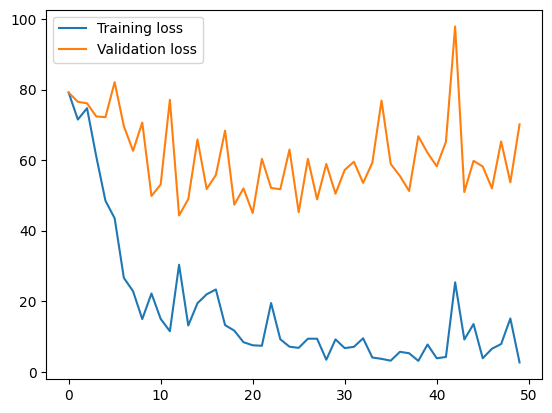

In [498]:
# plot the training and validation losses

plt.plot(train_losses, label='Training loss')
plt.plot(val_losses, label='Validation loss')
plt.legend()
plt.show()


In [499]:
# test the trained model

def test(model, test_loader, device):
    model.eval()
    predictions, actuals = [], []
    with torch.no_grad():
        test_loss = 0
        for inputs, labels in test_loader:
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            test_loss += criterion(outputs, labels.view(-1, 1)).item()

            predictions.append(outputs.cpu().numpy())
            actuals.append(labels.cpu().numpy())

        print(f'Test Loss: {test_loss/len(test_loader)}')

    return np.concatenate(predictions), np.concatenate(actuals)

predictions, actuals = test(model, test_loader, device)








Test Loss: 103.33945369720459


In [500]:
def evaluate_performance_test(predictions, y_test):

    errors = abs(y_test - predictions)
    mape = 100 * (errors / y_test)
    accuracy = 100 - np.mean(mape)
    mse = sklearn.metrics.mean_squared_error(y_test, predictions)
    rmse = np.sqrt(mse)
    r2 = sklearn.metrics.r2_score(y_test, predictions)


    print('Mean Absolute Error:', round(np.mean(errors), 2))
    print('Accuracy:', round(accuracy, 2), '%.')
    print('Mean Squared Error:', round(mse, 2))
    print('Root Mean Squared Error:', round(rmse, 2))
    print('R2:', round(r2, 2))


    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1)
    plt.scatter(y_test, predictions)
    plt.xlabel('Actual time to sleep onset')
    plt.ylabel('Predicted time to sleep onset')
    plt.title('Actual vs Predicted time to sleep onset')
    plt.show()

    #residuals = y_test - predictions
    #plt.scatter(y_test, residuals)
    #plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1)
    #plt.xlabel('Actual time to sleep onset')
    #plt.ylabel('Residuals')
    #plt.title('Actual vs Residuals')
    #plt.show()

    plt.hist(residuals)
    plt.xlabel('Residuals')
    plt.ylabel('Frequency')
    plt.title('Residuals distribution')
    plt.show()

    return predictions, errors, mape, accuracy, residuals

Mean Absolute Error: 10.01
Accuracy: -160.69 %.
Mean Squared Error: 103.48
Root Mean Squared Error: 10.17
R2: -0.23


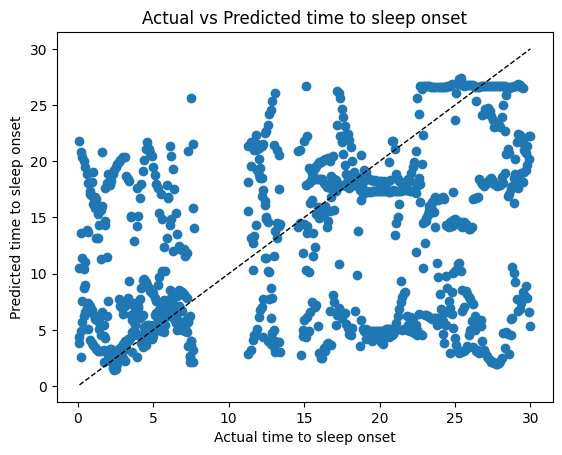

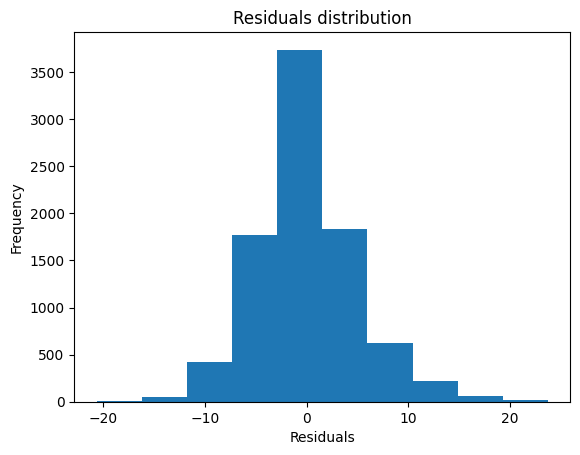

In [501]:

predictions, errors, mape, accuracy, residuals = evaluate_performance_test(predictions, actuals)

## Repeat the same analysis but with the scaled data ##

In [518]:
from sklearn.preprocessing import StandardScaler

# Initialize the scaler
scaler = StandardScaler()


# Scale each sequence individually, excluding the first feature
train_sequences_scaled = np.array([np.concatenate([seq[:, :1], scaler.fit_transform(seq[:, 1:])], axis=-1) for seq in train_sequences])
val_sequences_scaled = np.array([np.concatenate([seq[:, :1], scaler.transform(seq[:, 1:])], axis=-1) for seq in val_sequences])
test_sequences_scaled = np.array([np.concatenate([seq[:, :1], scaler.transform(seq[:, 1:])], axis=-1) for seq in test_sequences])

In [519]:
# Demonstrate the effect of scaling
print('Before scaling:')
print(train_sequences[0, 0, :5])
print('After scaling:')
print(train_sequences_scaled[0, 0, :5])


Before scaling:
[83.         -2.4452326  -3.15595023 -2.71083191 -2.96241   ]
After scaling:
[83.          6.57864818  6.77650251  6.83865544  6.98901772]


In [520]:
# Create a PyTorch dataset

train_dataset_scaled = SleepDataset(train_sequences_scaled, train_labels)
val_dataset_scaled = SleepDataset(val_sequences_scaled, val_labels)
test_dataset_scaled = SleepDataset(test_sequences_scaled, test_labels)

# Create a PyTorch data loader

train_loader_scaled = DataLoader(dataset=train_dataset_scaled, batch_size=64, shuffle=True)
val_loader_scaled = DataLoader(dataset=val_dataset_scaled, batch_size=64, shuffle=False)
test_loader_scaled = DataLoader(dataset=test_dataset_scaled, batch_size=64, shuffle=False)





Epoch 1/50, Loss: 78.9644546508789, Validation Loss: 77.65414532748136
Epoch 2/50, Loss: 73.78741455078125, Validation Loss: 75.62964370033957
Epoch 3/50, Loss: 37.098636627197266, Validation Loss: 217.2987239144065
Epoch 4/50, Loss: 19.390527725219727, Validation Loss: 178.7751700661399
Epoch 5/50, Loss: 14.522982597351074, Validation Loss: 154.24536028775302
Epoch 6/50, Loss: 14.26211929321289, Validation Loss: 159.87440733476117
Epoch 7/50, Loss: 18.098819732666016, Validation Loss: 153.8678741455078
Epoch 8/50, Loss: 11.420109748840332, Validation Loss: 142.02124179493296
Epoch 9/50, Loss: 3.9792983531951904, Validation Loss: 141.12945938110352
Epoch 10/50, Loss: 6.260242938995361, Validation Loss: 156.71519643610173
Epoch 11/50, Loss: 1.9964065551757812, Validation Loss: 150.05533599853516
Epoch 12/50, Loss: 11.227911949157715, Validation Loss: 129.37936540083453
Epoch 13/50, Loss: 4.088630676269531, Validation Loss: 119.70353178544478
Epoch 14/50, Loss: 3.247220516204834, Validat

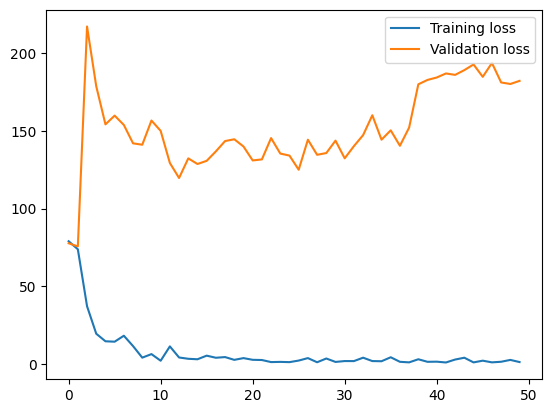

Test Loss: 173.52694064378738
Mean Absolute Error: 11.23
Accuracy: -63.65 %.
Mean Squared Error: 167.57
Root Mean Squared Error: 12.94
R2: -1.0


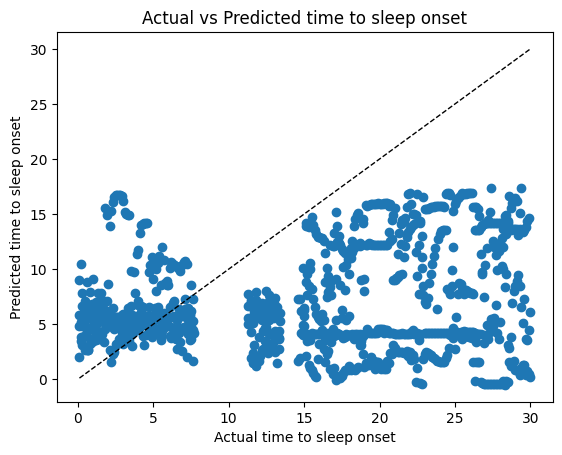

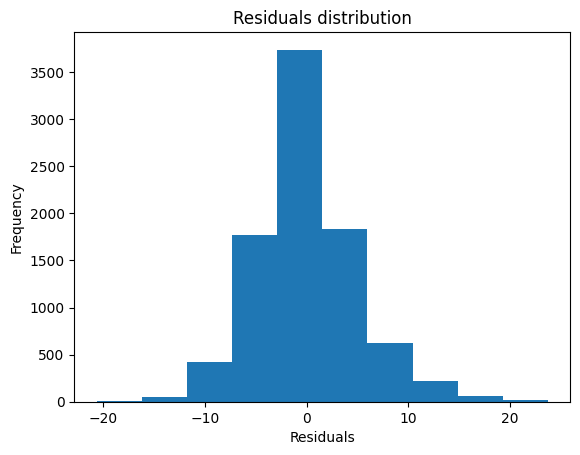

In [522]:
# Define the model
model_scaled = SleepOnsetRNN(input_size=68, hidden_size=100, num_layers=2)

# Define the loss function
criterion = nn.MSELoss()

# Define the optimizer
optimizer = torch.optim.Adam(model_scaled.parameters(), lr=0.001)

# Train the model
train_losses, val_losses, model_scaled = train(model_scaled, train_loader_scaled, val_loader_scaled, num_epochs=50, criterion=criterion, optimizer=optimizer, device=device)
# plot the training and validation losses

plt.plot(train_losses, label='Training loss')
plt.plot(val_losses, label='Validation loss')
plt.legend()
plt.show()

# test the trained model

predictions, actuals = test(model_scaled, test_loader_scaled, device)

predictions, errors, mape, accuracy, residuals = evaluate_performance_test(predictions, actuals)


In [523]:
# Implement L2 regularization for SleepOnsetRNN

class SleepOnsetRNN(nn.Module):
    
    def __init__(self, input_size, hidden_size, num_layers, output_size=1, dropout=0.0, l2=0.0):
        super(SleepOnsetRNN, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.l2 = l2
        
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True, dropout=dropout)
        self.fc = nn.Linear(hidden_size, output_size)
        
    def forward(self, x):
        h0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(device) 
        c0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(device)
        
        out, _ = self.lstm(x, (h0, c0))  
        out = self.fc(out[:, -1, :])  
        
        # L2 regularization
        l2_reg = torch.tensor(0.).to(device)
        for param in self.parameters():
            l2_reg += torch.norm(param)
        
        return out + self.l2 * l2_reg
    
    

Epoch 1/50, Loss: 69.40338134765625, Validation Loss: 77.81042965975675
Epoch 2/50, Loss: 84.22791290283203, Validation Loss: 75.63748012889515
Epoch 3/50, Loss: 58.47734451293945, Validation Loss: 193.36434624411842
Epoch 4/50, Loss: 29.912899017333984, Validation Loss: 140.55609876459295
Epoch 5/50, Loss: 26.777236938476562, Validation Loss: 154.4676130468195
Epoch 6/50, Loss: 24.108280181884766, Validation Loss: 147.9511465592818
Epoch 7/50, Loss: 11.781251907348633, Validation Loss: 142.87735280123624
Epoch 8/50, Loss: 6.860189914703369, Validation Loss: 137.81526340137827
Epoch 9/50, Loss: 4.83211088180542, Validation Loss: 128.1112296364524
Epoch 10/50, Loss: 10.321246147155762, Validation Loss: 146.30216095664284
Epoch 11/50, Loss: 10.58066463470459, Validation Loss: 144.75499291853473
Epoch 12/50, Loss: 10.247501373291016, Validation Loss: 148.9814477400346
Epoch 13/50, Loss: 4.6198320388793945, Validation Loss: 167.69690773703834
Epoch 14/50, Loss: 1.6489567756652832, Validati

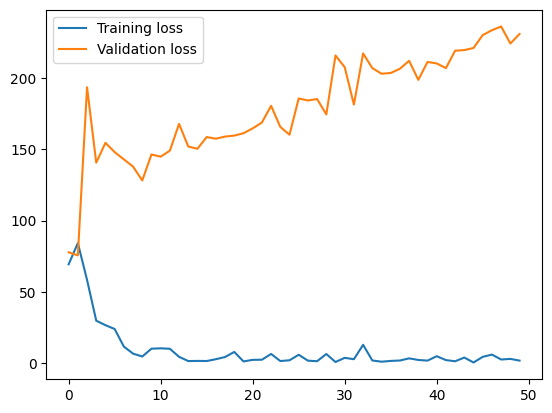

Test Loss: 241.56419777870178
Mean Absolute Error: 14.5
Accuracy: -57.78 %.
Mean Squared Error: 234.09
Root Mean Squared Error: 15.3
R2: -1.79


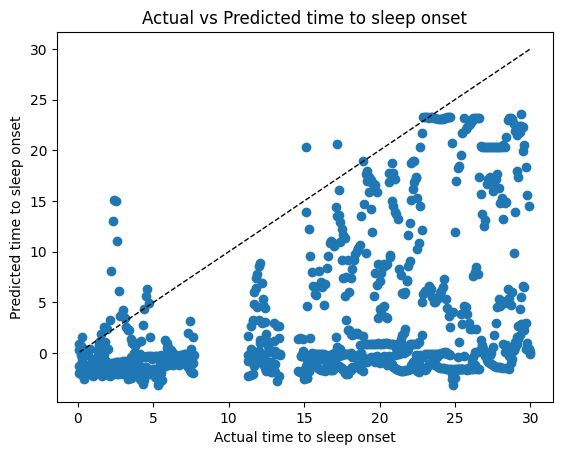

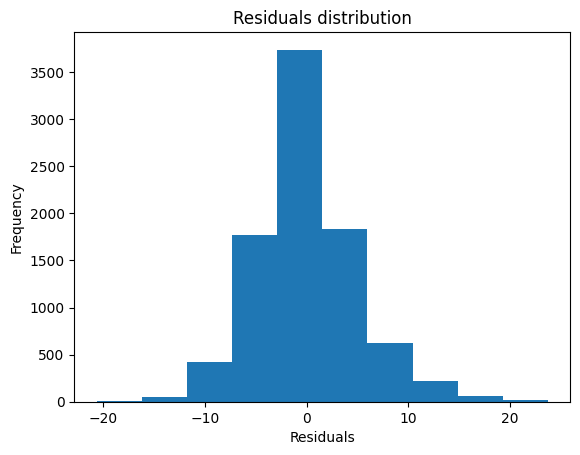

In [525]:
# Try the regularized model

model_reg = SleepOnsetRNN(input_size=68, hidden_size=100, num_layers=2, l2=0.001)

# Define the loss function
criterion = nn.MSELoss()

# Define the optimizer
optimizer = torch.optim.Adam(model_reg.parameters(), lr=0.001)

# Train the model

train_losses, val_losses, model_reg = train(model_reg, train_loader_scaled, val_loader_scaled, num_epochs=50, criterion=criterion, optimizer=optimizer, device=device)

# plot the training and validation losses

plt.plot(train_losses, label='Training loss')
plt.plot(val_losses, label='Validation loss')
plt.legend()
plt.show()

# test the trained model

predictions, actuals = test(model_reg, test_loader_scaled, device)

predictions, errors, mape, accuracy, residuals = evaluate_performance_test(predictions, actuals)


Epoch 1/50, Loss: 79.13034057617188, Validation Loss: 78.19490710171786
Epoch 2/50, Loss: 84.81111907958984, Validation Loss: 75.54857097972523
Epoch 3/50, Loss: 74.30986785888672, Validation Loss: 75.43348121643066
Epoch 4/50, Loss: 62.31196975708008, Validation Loss: 234.8070240020752
Epoch 5/50, Loss: 25.064136505126953, Validation Loss: 238.57535934448242
Epoch 6/50, Loss: 21.6485595703125, Validation Loss: 281.8373790220781
Epoch 7/50, Loss: 23.931554794311523, Validation Loss: 258.24858925559306
Epoch 8/50, Loss: 16.914535522460938, Validation Loss: 286.12188373912466
Epoch 9/50, Loss: 10.173262596130371, Validation Loss: 277.42896686900747
Epoch 10/50, Loss: 9.820119857788086, Validation Loss: 270.798866965554
Epoch 11/50, Loss: 3.496812343597412, Validation Loss: 282.95674202658915
Epoch 12/50, Loss: 3.0186309814453125, Validation Loss: 300.4575826471502
Epoch 13/50, Loss: 4.007877826690674, Validation Loss: 266.3609182184393
Epoch 14/50, Loss: 11.202771186828613, Validation Lo

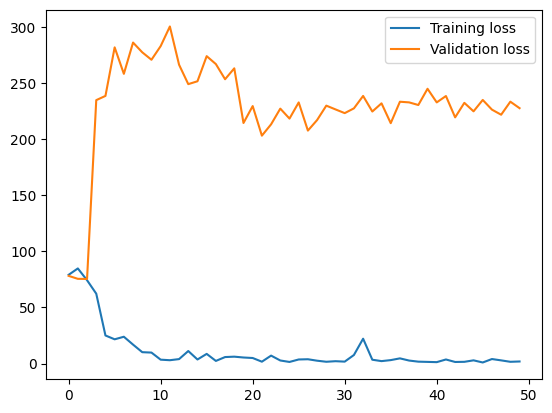

Test Loss: 248.52403497695923
Mean Absolute Error: 14.85
Accuracy: -79.24 %.
Mean Squared Error: 240.29
Root Mean Squared Error: 15.5
R2: -1.86


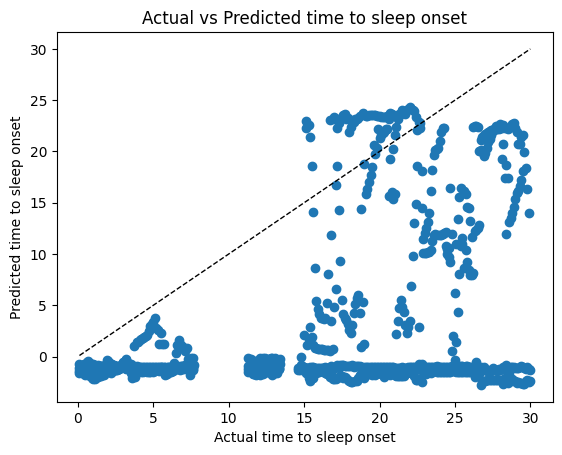

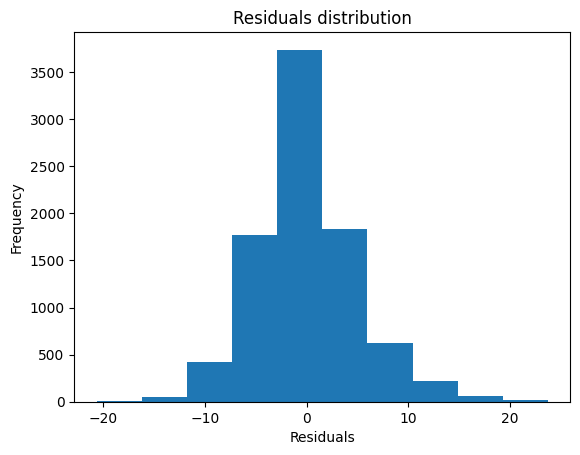

In [526]:
# Implement dropout for SleepOnsetRNN

class SleepOnsetRNN(nn.Module):

    def __init__(self, input_size, hidden_size, num_layers, output_size=1, dropout=0.0, l2=0.0):
        super(SleepOnsetRNN, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.l2 = l2

        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True, dropout=dropout)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, x):
        h0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(device)
        c0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(device)

        out, _ = self.lstm(x, (h0, c0))
        out = self.fc(out[:, -1, :])

        # L2 regularization
        l2_reg = torch.tensor(0.).to(device)
        for param in self.parameters():
            l2_reg += torch.norm(param)

        return out + self.l2 * l2_reg
    

# Try the dropout model

model_dropout = SleepOnsetRNN(input_size=68, hidden_size=100, num_layers=2, dropout=0.5)

# Define the loss function
criterion = nn.MSELoss()

# Define the optimizer
optimizer = torch.optim.Adam(model_dropout.parameters(), lr=0.001)

# Train the model

train_losses, val_losses, model_dropout = train(model_dropout, train_loader_scaled, val_loader_scaled, num_epochs=50, criterion=criterion, optimizer=optimizer, device=device)

# plot the training and validation losses

plt.plot(train_losses, label='Training loss')
plt.plot(val_losses, label='Validation loss')
plt.legend()
plt.show()

# test the trained model

predictions, actuals = test(model_dropout, test_loader_scaled, device)

predictions, errors, mape, accuracy, residuals = evaluate_performance_test(predictions, actuals)

